In [1]:
# !pip install --upgrade --pre xgboost # Needed for gpu used with feature_weights, at least on kaggle.

### Imports

In [1]:
from __future__ import print_function
from __future__ import division

from typing import List, Optional, Iterable, Union, Dict

import os
import pandas as pd
import numpy as np
import re
import itertools
from itertools import combinations


from matplotlib import pyplot as plt
import seaborn as sns

from sklearn import metrics
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.metrics import mean_absolute_error, mean_squared_error, accuracy_score

import xgboost as xgb # environment on thinkpad uses 2.0.3
from xgboost.sklearn import XGBClassifier
import catboost as cb # Requires numpy < 2.0.0

import optuna

import copy
from itertools import combinations

from numba import cuda

from warnings import filterwarnings
filterwarnings('ignore')

from scipy.signal import medfilt

import pickle

/home/tfc/anaconda3/envs/DD_dengue/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import torch

# Check if CUDA (GPU) is available
if torch.cuda.is_available():
    # Get the number of GPUs available
    num_gpus = torch.cuda.device_count()
    print(f"Number of GPUs available: {num_gpus}")

    # Iterate over available GPUs and print their names
    for i in range(num_gpus):
        gpu_name = torch.cuda.get_device_name(i)
        print(f"GPU {i}: {gpu_name}")
else:
    print("CUDA is not available. Running on CPU.")

Number of GPUs available: 1
GPU 0: NVIDIA GeForce RTX 4080 SUPER


### Helpers

In [3]:
def preprocess(df_features_or: pd.DataFrame,
               labels=None,
               features_to_keep: Optional[Iterable[str]] = None,
               lagged_features: Optional[Union[Iterable[str],Dict[str, Iterable[str]]]] = None,
               fillna: Optional[str] = None,
               smooth_feat: Optional[int] = None,
               circular_weekofyear: Optional[Union[int, Iterable[pd.DataFrame]]] = None,
               weekofyear_shift = 0,
               feature_lags=None,
               label_lags=None):
    '''
    Add lagged features or target values as needed, accounting for existence of two cities in dataset.
    fillna: Fill NaN approach, e.g. 'ffill'. None to not fill.
    circular_weekofyear: Pick weekofyear encoding approach. None: do nothing, 0: inverted U, 1: sine + cosine, 2: inverted sine, 3: target encoding, Iterable[df,df]: prefitted target encoder, to transform here
    '''

    # Function to shift target-encoded weekofyear with wrapping around
    def get_shift_weekofyear(df, steps):
        length = len(df)
        df = pd.concat([df,df],axis=0)
        df['weekofyear_targenc'] = df['weekofyear_targenc'].shift(-steps)
        df = df.iloc[steps+1:steps+length+1,:]
        df.sort_values('weekofyear',inplace=True)
        return df

    df_features = df_features_or.copy()
    df_features = df_features.reset_index()

    if features_to_keep is not None:         # Filter features
        feature_names = features_to_keep + ['city']
        df_features = df_features[feature_names]
    else:
        feature_names = list(df_features.columns)

    if fillna is not None:                   # Fill NaNs
        df_features.fillna(method=fillna, inplace=True)

    # Convert city feature to categorical and one hot encode
    df_features["city"] = df_features["city"].astype("category")
    df_features = pd.get_dummies(df_features, columns=['city'], drop_first=True)

    # Split cities before adding lags
    sj_features = df_features[df_features['city_sj']]
    iq_features = df_features[~df_features['city_sj']]

    if labels is not None:
        sj_labels = labels[df_features['city_sj']]
        iq_labels = labels[~df_features['city_sj']]
    else:
        sj_labels = None        
        iq_labels = None

    # Create circular week of year.
    if circular_weekofyear is not None:
        if isinstance(circular_weekofyear,int):
            if circular_weekofyear == 0:     # Inverted U-shape
                sj_features['weekofyear'] = np.sin((sj_features['weekofyear']-1)/51*np.pi)    # Method 1
                iq_features['weekofyear'] = np.sin((iq_features['weekofyear']-1)/51*np.pi)    # Method 1
            elif circular_weekofyear == 1:   # Sine and cosine curves to give unique representations
                sj_features['weekofyear1'] = np.cos((sj_features['weekofyear']-1)/51*2*np.pi)
                sj_features['weekofyear2'] = np.cos((sj_features['weekofyear']-1)/51*2*np.pi)
                sj_features.drop(columns=['weekofyear'],inplace=True)
                iq_features['weekofyear1'] = np.cos((iq_features['weekofyear']-1)/51*2*np.pi)
                iq_features['weekofyear2'] = np.cos((iq_features['weekofyear']-1)/51*2*np.pi)
                iq_features.drop(columns=['weekofyear'],inplace=True)
            elif circular_weekofyear == 2:   # Inverted sine curve for San Juan pattern
                sj_features['weekofyear'] = -np.sin((sj_features['weekofyear']-1-weekofyear_shift)/51*2*np.pi)   # Method 3
                iq_features['weekofyear'] = -np.sin((iq_features['weekofyear']-1-weekofyear_shift)/51*2*np.pi)   # Method 3
            elif circular_weekofyear == 3:   # Target encoding, fit transform
                # Fit
                sj_targenc_woy = pd.concat([sj_features[['weekofyear']],sj_labels],axis=1).groupby('weekofyear').mean().reset_index()
                sj_targenc_woy.rename(columns={'total_cases':'weekofyear_targenc'},inplace=True)
                iq_targenc_woy = pd.concat([iq_features[['weekofyear']],iq_labels],axis=1).groupby('weekofyear').mean().reset_index()
                iq_targenc_woy.rename(columns={'total_cases':'weekofyear_targenc'},inplace=True)
                # Shift if needed
                shifted_sj_targenc_woy = get_shift_weekofyear(sj_targenc_woy, weekofyear_shift)
                shifted_iq_targenc_woy = get_shift_weekofyear(iq_targenc_woy, weekofyear_shift)
                # Transform
                sj_features = sj_features.merge(shifted_sj_targenc_woy,how='left',on='weekofyear')
                sj_features.drop(columns=['weekofyear'],inplace=True)
                iq_features = iq_features.merge(shifted_iq_targenc_woy,how='left',on='weekofyear')
                iq_features.drop(columns=['weekofyear'],inplace=True)
            elif circular_weekofyear == 4: # U-shape for Iquitos pattern
                sj_features['weekofyear'] = -np.sin((sj_features['weekofyear']-1)/51*np.pi)    # Method 1
                iq_features['weekofyear'] = -np.sin((iq_features['weekofyear']-1)/51*np.pi)    # Method 1


        elif isinstance(circular_weekofyear,Iterable): # Transform if target encoding supplied
            assert len(circular_weekofyear)==2, "circular_weekofyear should contain exactly two dataframes, one for sja nd one for iq"
            sj_targenc_woy, iq_targenc_woy = circular_weekofyear
            # Shift if needed
            shifted_sj_targenc_woy = get_shift_weekofyear(sj_targenc_woy, weekofyear_shift)
            shifted_iq_targenc_woy = get_shift_weekofyear(iq_targenc_woy, weekofyear_shift)
            # Transform
            sj_features = sj_features.merge(shifted_sj_targenc_woy,how='left',on='weekofyear')
            sj_features.drop(columns=['weekofyear'],inplace=True)
            iq_features = iq_features.merge(shifted_iq_targenc_woy,how='left',on='weekofyear')
            iq_features.drop(columns=['weekofyear'],inplace=True)

    # Add smoothing to features
    if smooth_feat is not None:
        features_no_woy_city = [col for col in sj_features.columns if not (col in ['weekofyear','weekofyear_targenc','weekofyear1','weekofyear2','city_sj'])]
        sj_features[features_no_woy_city] = sj_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=smooth_feat))
        iq_features[features_no_woy_city] = iq_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=smooth_feat))

    # Lagged feature/labels creation
    if (lagged_features is not None) or (label_lags is not None):
        # Add lagged features
        if isinstance(lagged_features,dict):                # Do individual lags for different features
            for feat, feat_lags in lagged_features.items():
                sj_features_lagged = sj_features[feat].shift(periods=feat_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feat_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)
        elif isinstance(lagged_features, (list, tuple)):    # All considered features has same lags
            for feat in lagged_features:
                if 'total_cases' in feat:                   # Skip all total_cases features, used when preprocessing pred features
                    continue
                sj_features_lagged = sj_features[feat].shift(periods=feature_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feature_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)

        # Add lagged labels
        if label_lags is not None:
            sj_lagged_labels = sj_labels.shift(periods=label_lags)
            sj_features = pd.concat([sj_features,sj_lagged_labels],axis=1)
            iq_lagged_labels = iq_labels.shift(periods=label_lags)
            iq_features = pd.concat([iq_features,iq_lagged_labels],axis=1)

    if circular_weekofyear == 3:
        return sj_features, iq_features, sj_labels, iq_labels, sj_targenc_woy, iq_targenc_woy
    else:
        return sj_features, iq_features, sj_labels, iq_labels



def prep_data(sj_features:pd.DataFrame, iq_features:pd.DataFrame,
              sj_labels:pd.DataFrame, iq_labels:pd.DataFrame,
              folds=6, fold_size=0.15):
    '''
    To prepare multiple folds for k-fold, without randomization to preserve time series sequence.
    sj_features: Dataframe of processed input for San Juan
    iq_features: Dataframe of processed input for Iquitos
    sj_labels: Labels for San Juan
    iq_labels: Labels for Iquitos
    '''

    # K-fold with sequential splits, 6 folds, with early data kept out
    X_train_sj, X_val_sj, y_train_sj, y_val_sj = [], [], [], []
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = [], [], [], []
    sj_size = len(sj_features)
    iq_size = len(iq_features)
    sj_fold_size = round(fold_size*sj_size)
    iq_fold_size = round(fold_size*iq_size)
    sj_train_features_temp = sj_features.copy()
    iq_train_features_temp = iq_features.copy()
    sj_train_labels_temp = sj_labels.copy()
    iq_train_labels_temp = iq_labels.copy()

    for _ in range(folds):
        # Add to X_val
        X_val_sj.append(sj_train_features_temp.iloc[-sj_fold_size:,:])
        sj_train_features_temp.drop(sj_train_features_temp.index[-sj_fold_size:],inplace=True)
        X_val_iq.append(iq_train_features_temp.iloc[-iq_fold_size:,:])
        iq_train_features_temp.drop(iq_train_features_temp.index[-iq_fold_size:],inplace=True)
        
        # Add to y_val
        y_val_sj.append(sj_train_labels_temp.iloc[-sj_fold_size:,:])
        sj_train_labels_temp.drop(sj_train_labels_temp.index[-sj_fold_size:],inplace=True)
        y_val_iq.append(iq_train_labels_temp.iloc[-iq_fold_size:,:])
        iq_train_labels_temp.drop(iq_train_labels_temp.index[-iq_fold_size:],inplace=True)

    # Create X_train and y_train
    X_train_sj_components = copy.deepcopy(X_val_sj)
    X_train_iq_components = copy.deepcopy(X_val_iq)
    y_train_sj_components = copy.deepcopy(y_val_sj)
    y_train_iq_components = copy.deepcopy(y_val_iq)

    for i in range(folds):
        X_train_sj_components_temp = copy.deepcopy(X_train_sj_components)
        X_train_sj_components_temp.pop(i)
        X_train_sj_components_temp.append(copy.deepcopy(sj_train_features_temp))  # Remove 1 fold, add back remainder rows from earlier
        X_train_sj.append(pd.concat(X_train_sj_components_temp))

        y_train_sj_components_temp = copy.deepcopy(y_train_sj_components)
        y_train_sj_components_temp.pop(i)
        y_train_sj_components_temp.append(copy.deepcopy(sj_train_labels_temp))  # Remove 1 fold, add back remainder rows from earlier
        y_train_sj.append(pd.concat(y_train_sj_components_temp))

        X_train_iq_components_temp = copy.deepcopy(X_train_iq_components)
        X_train_iq_components_temp.pop(i)
        X_train_iq_components_temp.append(copy.deepcopy(iq_train_features_temp))  # Remove 1 fold, add back remainder rows from earlier
        X_train_iq.append(pd.concat(X_train_iq_components_temp))

        y_train_iq_components_temp = copy.deepcopy(y_train_iq_components)
        y_train_iq_components_temp.pop(i)
        y_train_iq_components_temp.append(copy.deepcopy(iq_train_labels_temp))  # Remove 1 fold, add back remainder rows from earlier
        y_train_iq.append(pd.concat(y_train_iq_components_temp))

    return X_train_sj, X_val_sj, y_train_sj, y_val_sj, X_train_iq, X_val_iq, y_train_iq, y_val_iq

In [4]:
def create_XGBmodel(eta=0.01,n_estimators=1000,
                    max_depth=5,objective='reg:squarederror',
                    min_child_weight=1.02, gamma=0.51, subsample=0.86,
                    colsample_bytree=0.84, scale_pos_weight=1, seed=42,
                    **kwargs):
    '''
    Create an XGBRegressor model based on availability of GPU
    '''

    try:
        cuda.detect()
        gpu_available = cuda.is_available()
    except:
        gpu_available = False

    if gpu_available:
        return xgb.XGBRegressor(
            tree_method= 'gpu_hist',  # Use GPU accelerated algorithm
            n_gpus=1,
            device='cuda:0',
            learning_rate =eta,
            n_estimators=n_estimators,
            max_depth=max_depth,
            min_child_weight=min_child_weight,
            gamma=gamma,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            objective= objective,
            scale_pos_weight=scale_pos_weight,
            seed=seed,
            **kwargs)
    else:
        return xgb.XGBRegressor(
            learning_rate =eta,
            n_estimators=n_estimators,
            max_depth=max_depth,
            min_child_weight=min_child_weight,
            gamma=gamma,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            objective= objective,
            scale_pos_weight=scale_pos_weight,
            seed=seed,
            **kwargs)
    
def modelfit(alg, X_train, y_train, useTrainCV=True, cv_folds=5, early_stopping_rounds=50,trainCV_metrics = 'mae',
             eval_metric = 'mae',report_metric =  metrics.mean_absolute_error, verbose=True,
             weights=None, feature_weights = None):
    '''
    Automatically fit model, with option for using CV to get best n_estimators
    alg: XGBoost model
    weights: Weights for each data point
    feature_weights: Weights for each feature. Used here to reduce weights on lagged labels to reduce reliance on it.
    '''

    xgb_param = alg.get_xgb_params()
    xgtrain = xgb.DMatrix(X_train, label=y_train,feature_weights=feature_weights)
    xgtrain.set_info(feature_weights=feature_weights)

    if weights is not None:
        xgtrain.set_weight(weights)

    if useTrainCV:
        cvresult = xgb.cv(xgb_param, xgtrain, num_boost_round=alg.get_params()['n_estimators'], nfold=cv_folds,
            metrics=trainCV_metrics, early_stopping_rounds=early_stopping_rounds, verbose_eval=False)
        alg.set_params(n_estimators=cvresult.shape[0])
    
    #Fit the algorithm on the data
    alg.fit(X_train, y_train, feature_weights=feature_weights)
        
    #Predict training set:
    X_train_predictions = alg.predict(X_train)
        
    #Print model report:
    if verbose:
        print("\nModel Report")
        print(report_metric)
        print(report_metric(y_train, X_train_predictions))

def get_predictions(model, X_val,
                    label_lags: Optional[Iterable[int]]=None,
                    MC: Optional[int]=None):
    '''
    Get predictions using newly predicted labels as lagged labels.
    model: Trained XGBoost Regressor model
    X_val: Validation features
    label_lags: Label lags, None to signify no lagged labels used
    MC: Positive integer to use Monte Carlo-ish approach, small perturbations at every timestep. Currently only valid for Poisson distribution
    '''

    if label_lags is not None:
        if MC is None:
            X_val_no_lags = X_val.copy()
            lag_label_col_names = ['total_cases_'+str(lag) for lag in label_lags]                     # Lagged label names
            lag_label_col_locs = [X_val_no_lags.columns.get_loc(col) for col in lag_label_col_names]  # Get locations of lagged labels

            pred_val = np.zeros(X_val_no_lags.shape[0])
            for i in range(X_val_no_lags.shape[0]):
                pred_val[i] = model.predict(X_val_no_lags.iloc[i:i+1,:])                    # Predict current value, keep input in required dataframe format
                for k,j in enumerate(label_lags):                                           # Add predicted value to X_val as lagged labels for subsequent rows
                    try:
                        X_val_no_lags.iloc[i+j,lag_label_col_locs[k]] = pred_val[i]
                    except:
                        continue
        else:
            X_val_no_lags = X_val.copy()
            lag_label_col_names = ['total_cases_'+str(lag) for lag in label_lags]
            lag_label_col_locs = [X_val_no_lags.columns.get_loc(col) for col in lag_label_col_names]
            pred_val = np.zeros([X_val_no_lags.shape[0],MC])

            for l in range(MC):
                X_val_no_lags = X_val.copy()
                
                if l%20==0:
                    print(f'Step {l} of {MC} MC simulations')
                for i in range(X_val_no_lags.shape[0]):
                    lambda_ = model.predict(X_val_no_lags.iloc[i:i+1,:])                         # Get poisson lambda parameter
                    pred_val[i,l] = np.random.poisson(lambda_)                                   # Predict current value by taking a sample
                    for k,j in enumerate(label_lags):                                            # Add predicted value to X_val as lagged labels for subsequent rows
                        try:
                            X_val_no_lags.iloc[i+j,lag_label_col_locs[k]] = pred_val[i,l]
                        except:
                            continue
    else:
        pred_val = model.predict(X_val)
    pred_val = np.round(pred_val)
    pred_val = np.clip(pred_val, 0, 10000000)
    
    return pred_val

def eval_and_plot(model,X_train_all,y_train_all,X_val_all,y_val_all,
                  label_lags=None,
                  plot=True,verbose=True, MC=None,get_pred_train=True,
                  two_cities=False, median_filter: Optional[int]=None):
    '''
    Evaluate by predicting validation set and optionally plotting
    X_train: Dataframe of train features. Iterable of two dataframes if two_cities is True
    y_train: Dataframe of train labels. Iterable of two dataframes if two_cities is True
    X_val: Dataframe of val features. Iterable of two dataframes if two_cities is True
    y_val: Dataframe of val labels. Iterable of two dataframes if two_cities is True
    get_pred_train: True to calculate using previously predicted labels as lagged labels
    two_cities: Training model on both cities, requires splitting.
    median_filter: Apply median filtering to results.
    '''

    # If both cities trained together, input should be iterable of two datasets
    if two_cities:
        assert len(X_train_all)==2
        assert len(y_train_all)==2
        assert len(X_val_all)==2
        assert len(y_val_all)==2
    else:
        X_train_all = [X_train_all]
        y_train_all = [y_train_all]
        X_val_all = [X_val_all]
        y_val_all = [y_val_all]

    # Collect values separately for each city
    pred_train_all = []
    pred_val_all = []
    train_mae_all = []
    val_mae_all = []

    for X_train, y_train, X_val, y_val in zip(X_train_all, y_train_all, X_val_all, y_val_all):
        # Get predicted train values
        if get_pred_train:
            pred_train = get_predictions(model, X_train, label_lags, MC=MC)
        else:
            pred_train = model.predict(X_train)

        if median_filter is not None:
            pred_train = medfilt(pred_train,median_filter)

        pred_train = np.round(pred_train)
        pred_train = np.clip(pred_train, 0, 10000000)
        
        train_mae = mean_absolute_error(y_train, pred_train)
        if verbose:
            print("Train MAE:", train_mae)

        # Get prediction validation values
        pred_val = get_predictions(model, X_val, label_lags, MC=MC)

        if median_filter is not None:
            pred_val = medfilt(pred_val,median_filter)

        if MC is None:
            val_mae = mean_absolute_error(y_val, pred_val)
        else:
            val_mae = mean_absolute_error(y_val, np.mean(pred_val,axis=1))
        if verbose:
            print("Val MAE:", val_mae)
        
        pred_train_all.append(pred_train)
        pred_val_all.append(pred_val)
        train_mae_all.append(train_mae)
        val_mae_all.append(val_mae)

    if plot:
        for pred_train, pred_val, y_train, y_val, train_mae, val_mae in zip(pred_train_all, pred_val_all,y_train_all, y_val_all, train_mae_all, val_mae_all):
            fig, axs = plt.subplots(1,2,figsize=(8,2))
            fig2, axs2 = plt.subplots(2,1,figsize=(10,4))
            axs[0].scatter(y_train, pred_train)
            pred_train = pd.Series(pred_train, index=y_train.index)
            axs2[0].plot(np.arange(len(pred_train)), pred_train.sort_index(),marker='.',label='pred');
            axs2[0].plot(np.arange(len(y_train)), y_train.sort_index(),marker='.',label='y');
            axs2[0].legend();
            axs2[0].set_title(f'Training MAE: {train_mae}')


            if MC is None:
                axs[1].scatter(y_val, pred_val)
                pred_val = pd.Series(pred_val, index=y_val.index)
                axs2[1].plot(np.arange(len(pred_val)), pred_val.sort_index(),marker='.',label='pred');
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),marker='.',label='y');
                axs2[1].legend();
                axs2[1].set_title(f'Validation MAE: {val_mae}')
            else:
                axs[1].scatter(y_val, np.mean(pred_val,axis=1))
                            
                for l in range(MC):
                    axs2[1].plot(np.arange(pred_val.shape[0]), pred_val[:,l],alpha=0.2,color='grey');
                axs2[1].plot(np.arange(pred_val.shape[0]), np.mean(pred_val,axis=1),color='red');                
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),color='k',marker='.');
            fig.tight_layout()
            fig2.tight_layout()
            
        if not two_cities: # Unpacking directly if individually trained
            pred_train_all, pred_val_all, train_mae_all, val_mae_all = pred_train_all[0], pred_val_all[0], train_mae_all[0], val_mae_all[0]

    return pred_train_all, pred_val_all, train_mae_all, val_mae_all

## Data

In [5]:
# Load the provided data
# datapath = '/kaggle/input/data' # kaggle
datapath = r'./data' # local
train_features_or = pd.read_csv(datapath+'/dengue_features_train.csv',
                             index_col=[1,2])
train_features_or.reset_index(inplace=True)

test_features_or = pd.read_csv(datapath+'/dengue_features_test.csv',
                             index_col=[1,2])
test_features_or.reset_index(inplace=True)

test_features_aug_or = pd.read_csv(datapath+'/dengue_features_test2.csv',
                             index_col=[1,2])
test_features_aug_or.reset_index(inplace=True)

train_labels = pd.read_csv(datapath+'/dengue_labels_train.csv',
                           index_col=[1,2])
train_labels = train_labels.reset_index()
train_labels.drop(columns=['city','year','weekofyear'],inplace=True)

# Rearranging features for clearer viewing with heatmap
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]

## SquaredError, Split cities, no label lag weights, custom feature lags

### SanJuan

#### Reference Config, sub33 style

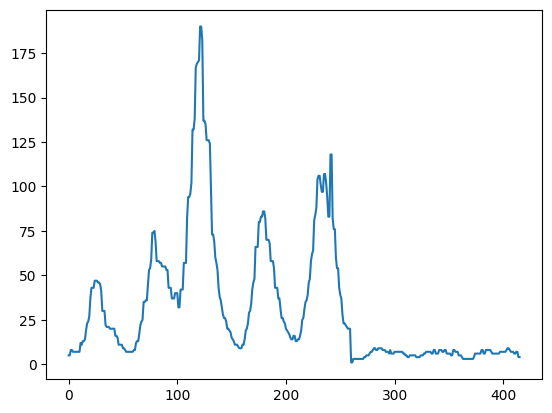

In [6]:
best_case_sub33 = pd.read_csv('submission_33.csv')
plt.plot(best_case_sub33['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

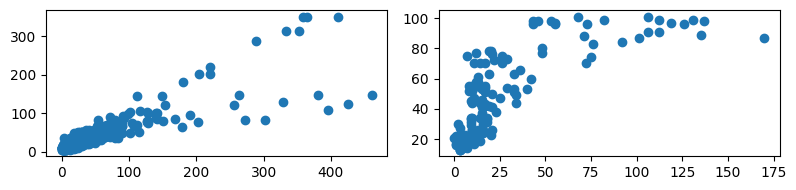

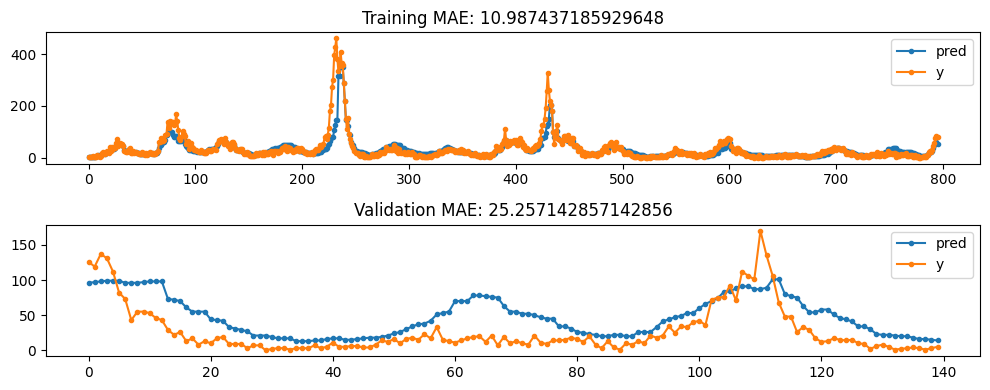

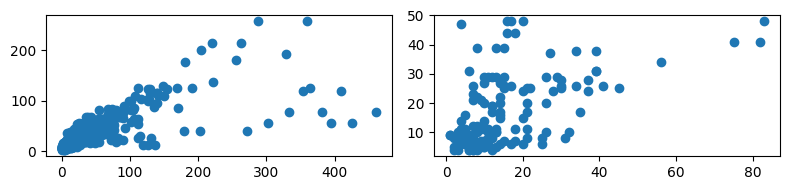

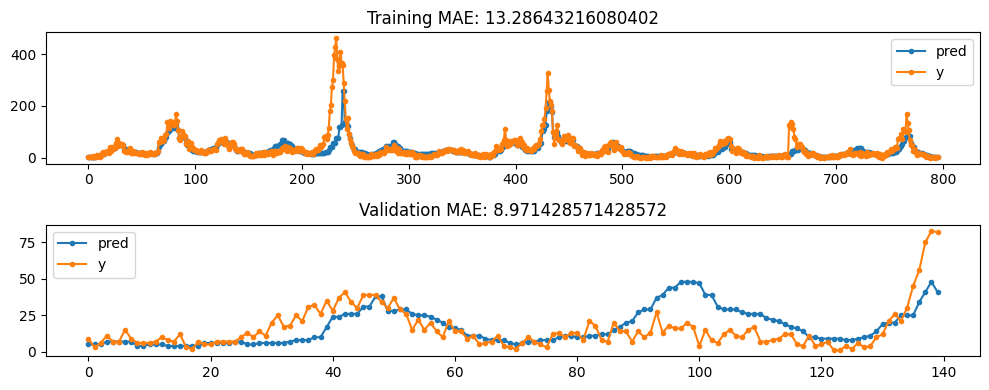

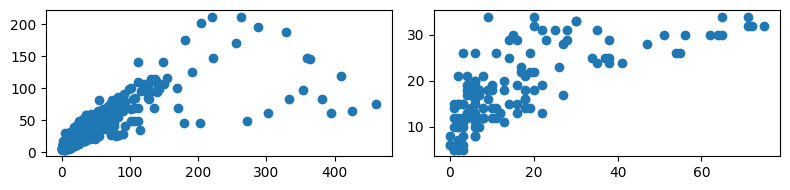

...

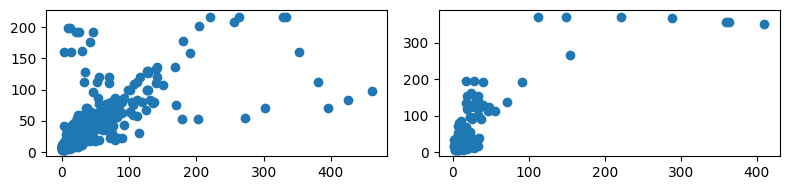

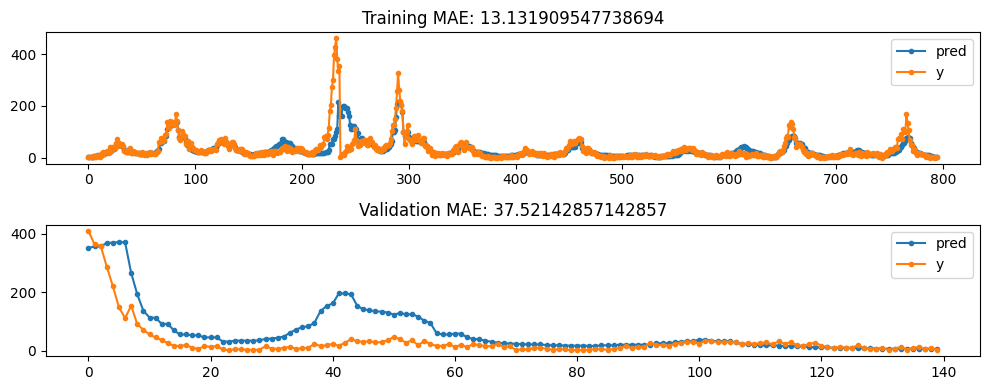

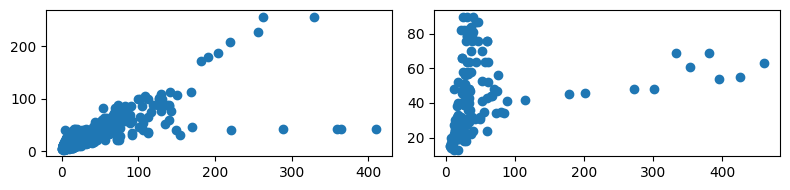

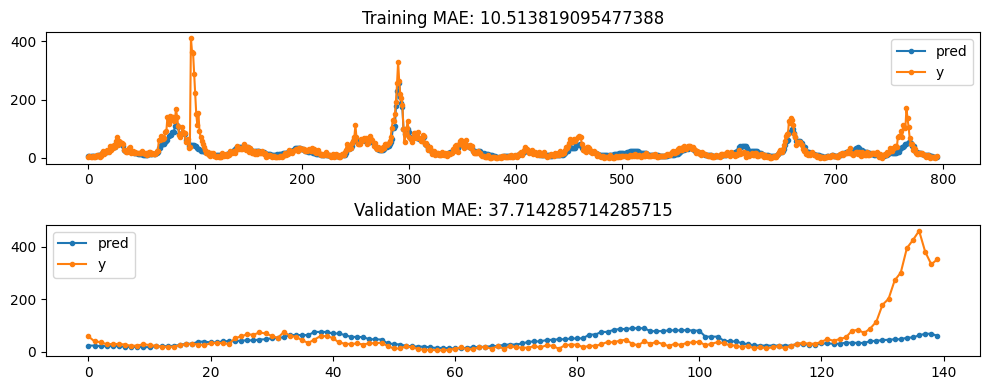

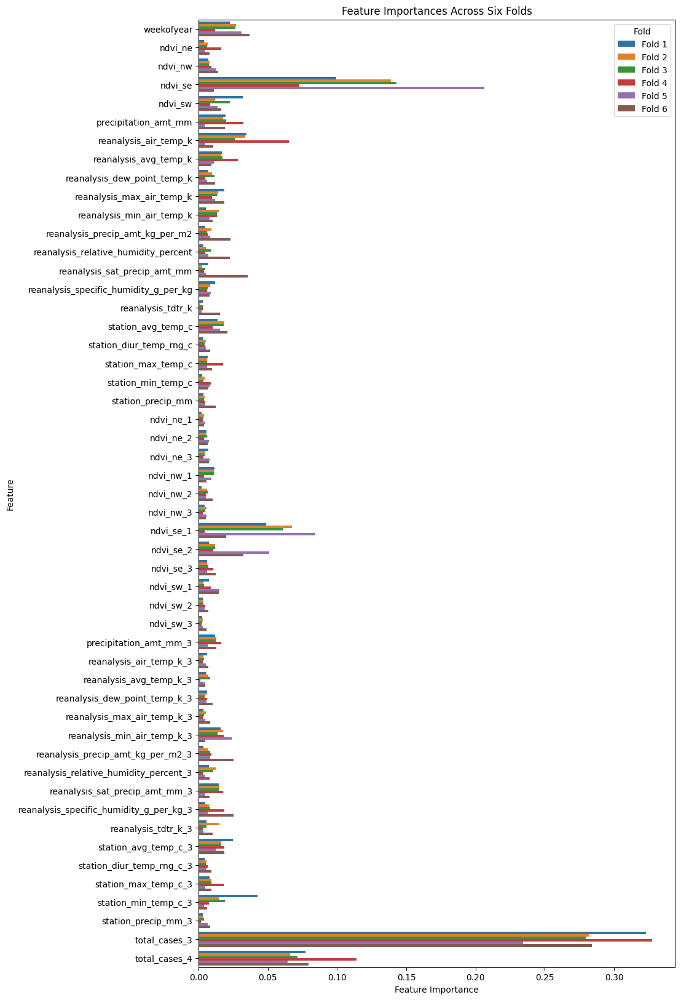

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


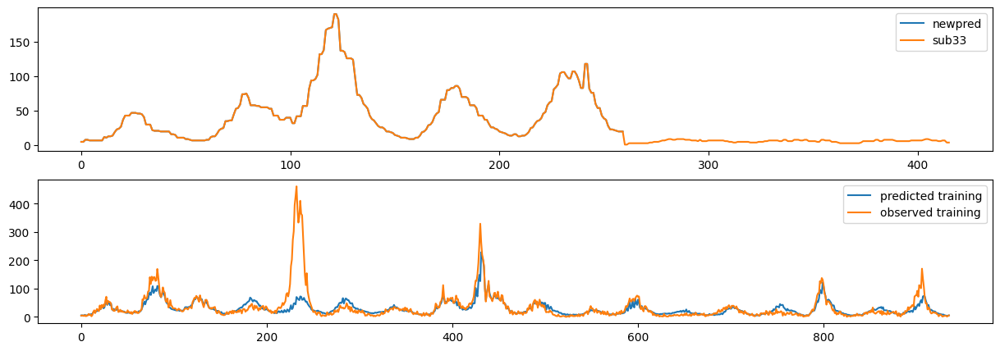

In [28]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
weekofyear_shift = 10
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', smooth_feat = 3,
                                                            feature_lags=None, label_lags=label_lags,
                                                            circular_weekofyear=2, weekofyear_shift=weekofyear_shift)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                           features_to_keep = feature_names + lagged_label_names,
                                           lagged_features = lagged_features,
                                           fillna = 'ffill', smooth_feat = 3,
                                           feature_lags=None, label_lags=None,
                                           circular_weekofyear=2,weekofyear_shift=weekofyear_shift)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub33['total_cases'],label='sub33')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

Text(0.5, 1.0, 'Training data, sine-encoded, weekofyear shifting = 0')

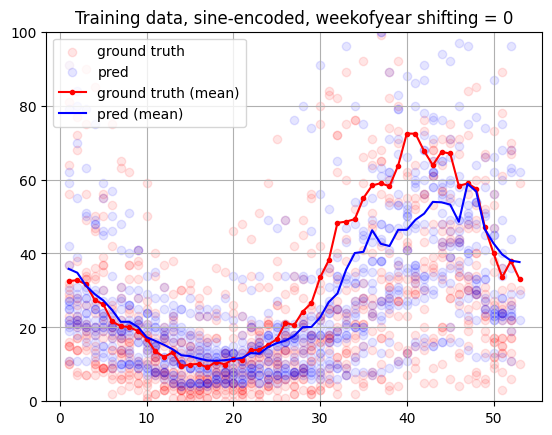

In [40]:
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.scatter(df_temp['weekofyear'],df_temp['total_cases'],label='ground truth',alpha=0.1,c='red')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
plt.scatter(df_temp2['weekofyear'],df_temp2['total_cases'],label='pred',alpha=0.1,c='blue')

plt.plot(df_temp.groupby('weekofyear').mean(),'.-',label='ground truth (mean)',c='red')
plt.plot(df_temp2.groupby('weekofyear').mean(),label='pred (mean)',c='blue')

plt.legend()
plt.grid()
plt.ylim([0,100])
plt.title('Training data, sine-encoded, weekofyear shifting = 0')

Text(0.5, 1.0, 'Training data, sine-encoded, weekofyear shifting = 0')

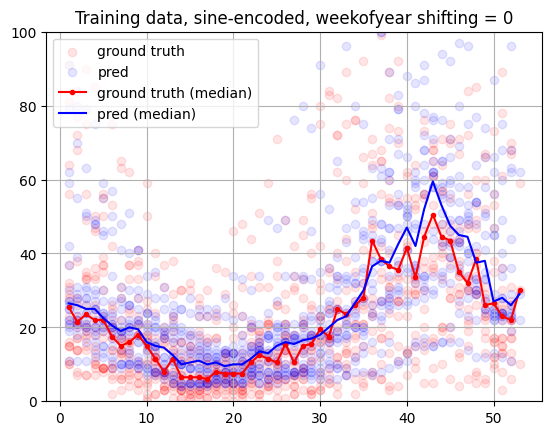

In [41]:
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.scatter(df_temp['weekofyear'],df_temp['total_cases'],label='ground truth',alpha=0.1,c='red')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
plt.scatter(df_temp2['weekofyear'],df_temp2['total_cases'],label='pred',alpha=0.1,c='blue')

plt.plot(df_temp.groupby('weekofyear').median(),'.-',label='ground truth (median)',c='red')
plt.plot(df_temp2.groupby('weekofyear').median(),label='pred (median)',c='blue')

plt.legend()
plt.grid()
plt.ylim([0,100])
plt.title('Training data, sine-encoded, weekofyear shifting = 0')

Text(0.5, 1.0, 'Training data, sine-encoded, weekofyear shifting = 10')

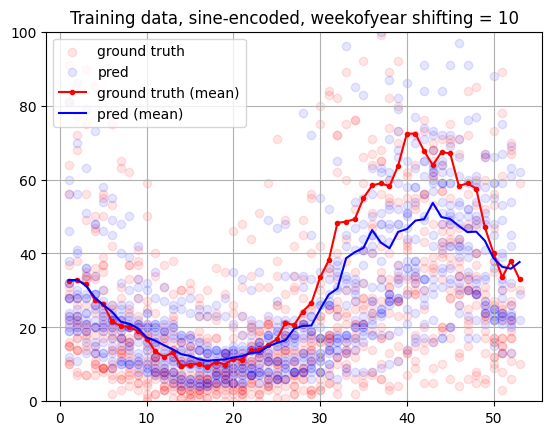

In [29]:
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.scatter(df_temp['weekofyear'],df_temp['total_cases'],label='ground truth',alpha=0.1,c='red')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
plt.scatter(df_temp2['weekofyear'],df_temp2['total_cases'],label='pred',alpha=0.1,c='blue')

plt.plot(df_temp.groupby('weekofyear').mean(),'.-',label='ground truth (mean)',c='red')
plt.plot(df_temp2.groupby('weekofyear').mean(),label='pred (mean)',c='blue')

plt.legend()
plt.grid()
plt.ylim([0,100])
plt.title('Training data, sine-encoded, weekofyear shifting = 10')

Text(0.5, 1.0, 'Training data, sine-encoded, weekofyear shifting = 10')

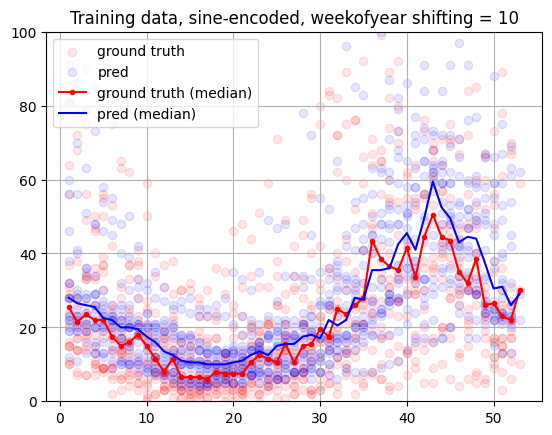

In [38]:
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.scatter(df_temp['weekofyear'],df_temp['total_cases'],label='ground truth',alpha=0.1,c='red')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
plt.scatter(df_temp2['weekofyear'],df_temp2['total_cases'],label='pred',alpha=0.1,c='blue')

plt.plot(df_temp.groupby('weekofyear').median(),'.-',label='ground truth (median)',c='red')
plt.plot(df_temp2.groupby('weekofyear').median(),label='pred (median)',c='blue')

plt.legend()
plt.grid()
plt.ylim([0,100])
plt.title('Training data, sine-encoded, weekofyear shifting = 10')

#### Target encoding weekofyear

Turns out not to work that well. maybe not smooth enough. sine curve from sub33 prob worked better because we're inducing a structure.

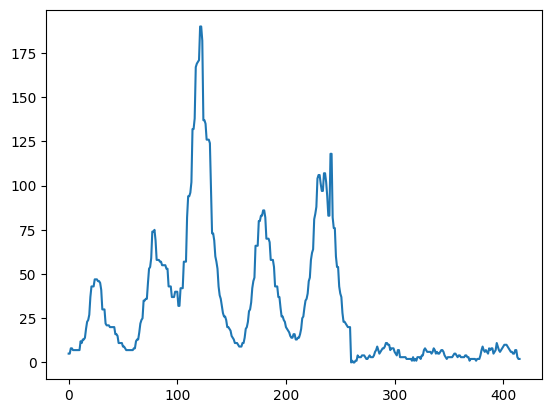

In [12]:
best_case_sub34 = pd.read_csv('submission_34.csv')
plt.plot(best_case_sub34['total_cases'])

With target encoding, without week of year shift


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

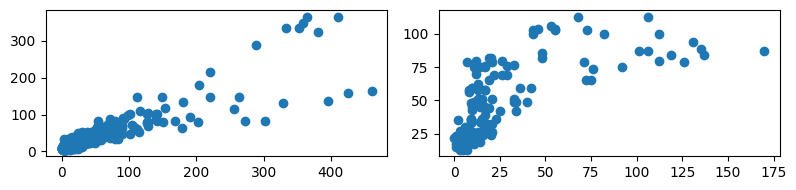

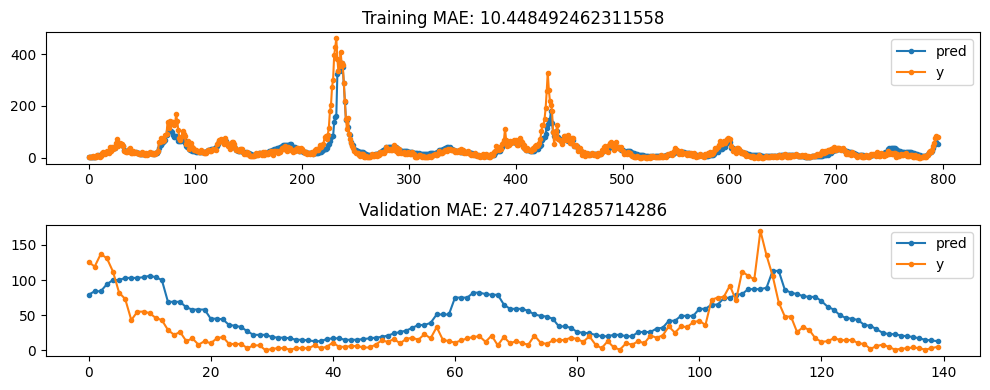

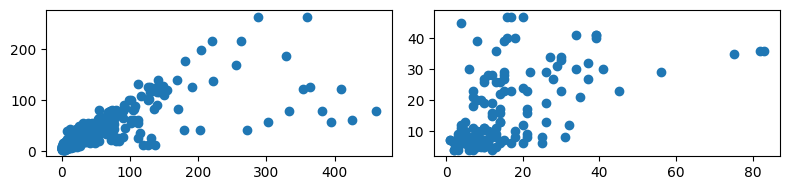

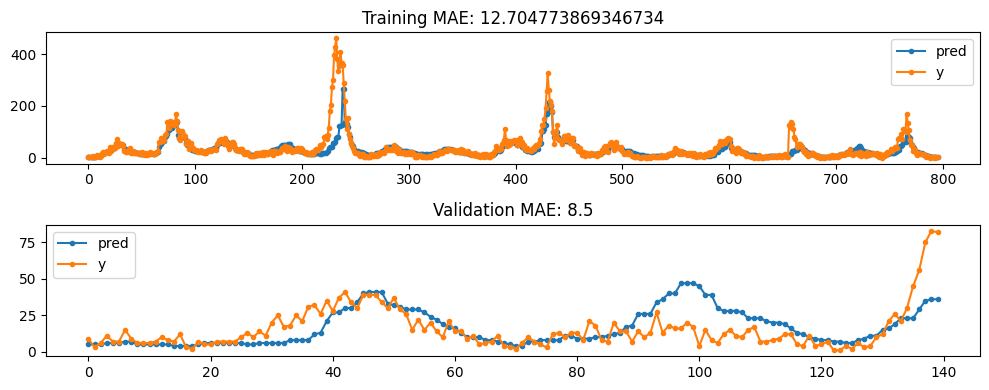

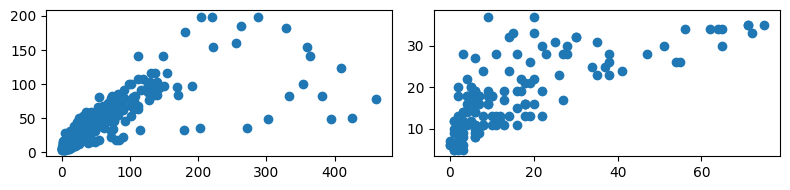

...

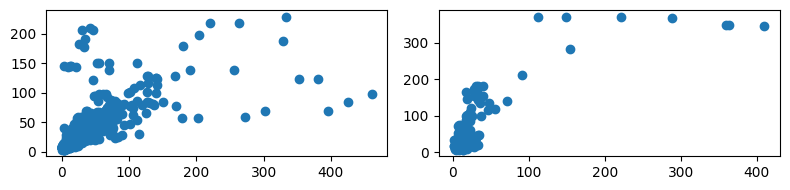

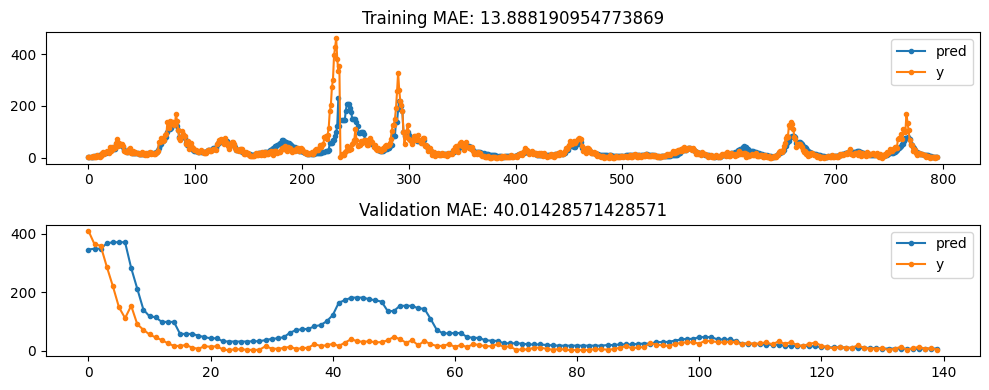

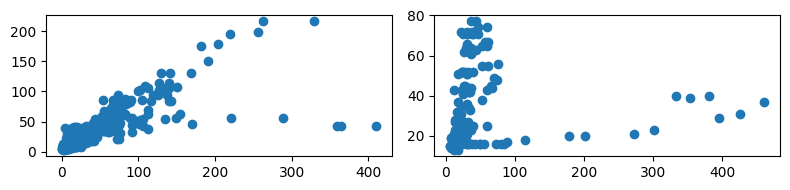

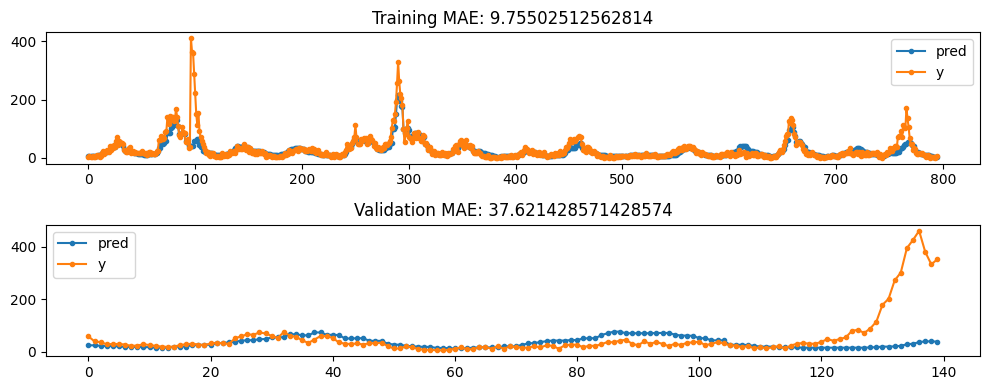

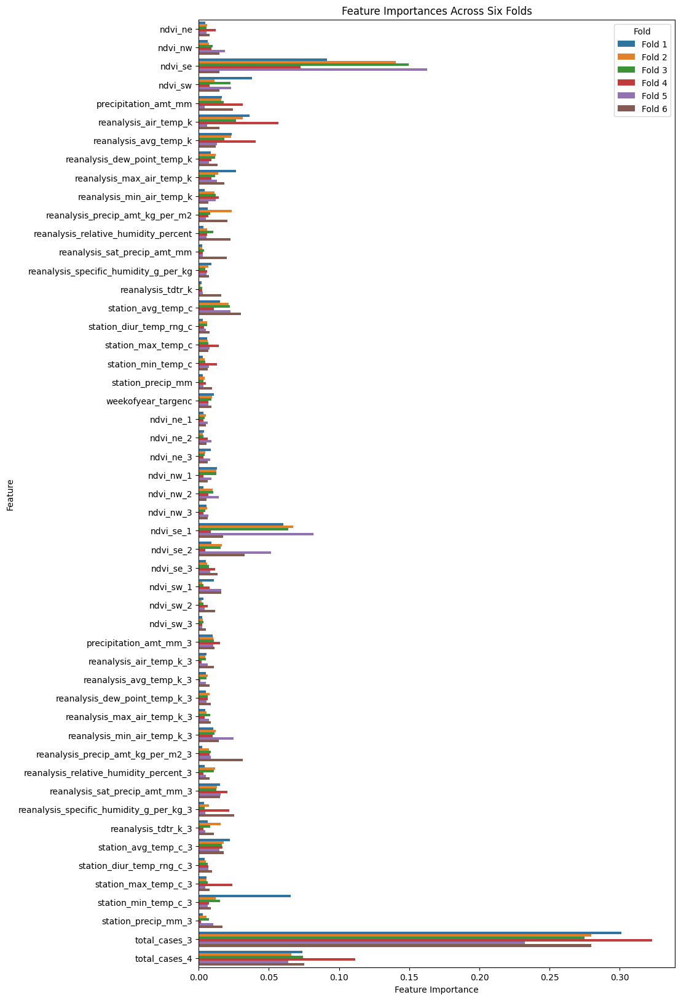

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


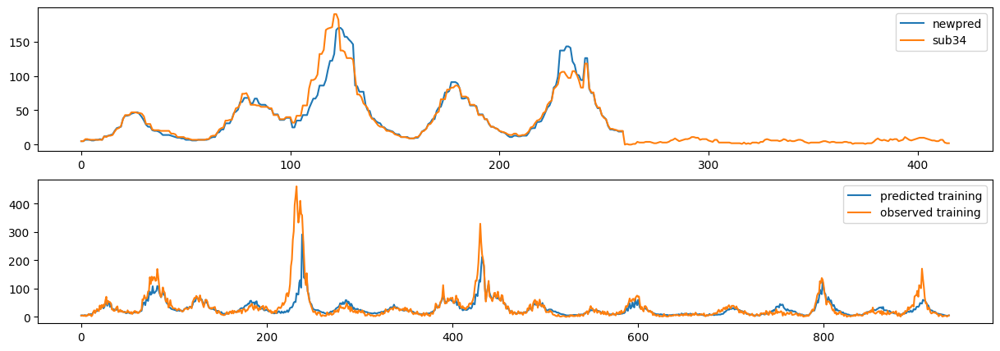

In [13]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features,\
    sj_labels, iq_labels,\
        sj_targenc_woy, iq_targenc_woy = preprocess(train_features_or,labels=train_labels,
                                                    features_to_keep = feature_names,
                                                    lagged_features = lagged_features,
                                                    fillna = 'ffill', smooth_feat = 3,
                                                    feature_lags=None, label_lags=label_lags,
                                                    circular_weekofyear=3,
                                                    weekofyear_shift=0)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                           features_to_keep = feature_names + lagged_label_names,
                                           lagged_features = lagged_features,
                                           fillna = 'ffill', smooth_feat = 3,
                                           feature_lags=None, label_lags=None,
                                           circular_weekofyear=(sj_targenc_woy, iq_targenc_woy),
                                           weekofyear_shift=0)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub34['total_cases'],label='sub34')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

Text(0.5, 1.0, 'Training data, target-encoded, no weekofyear shifting')

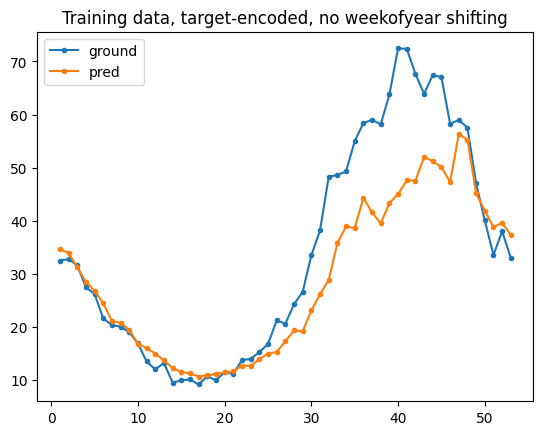

In [15]:
# Before week shifting
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.plot(df_temp.groupby('weekofyear').mean(),'.-',label='ground')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
plt.plot(df_temp2.groupby('weekofyear').mean(),'.-',label='pred')
plt.legend()
plt.title('Training data, target-encoded, no weekofyear shifting')

With target encoding and a week of year shift of 10


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

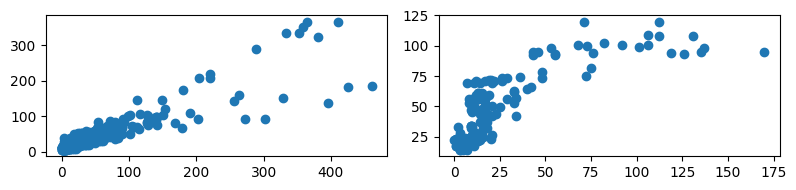

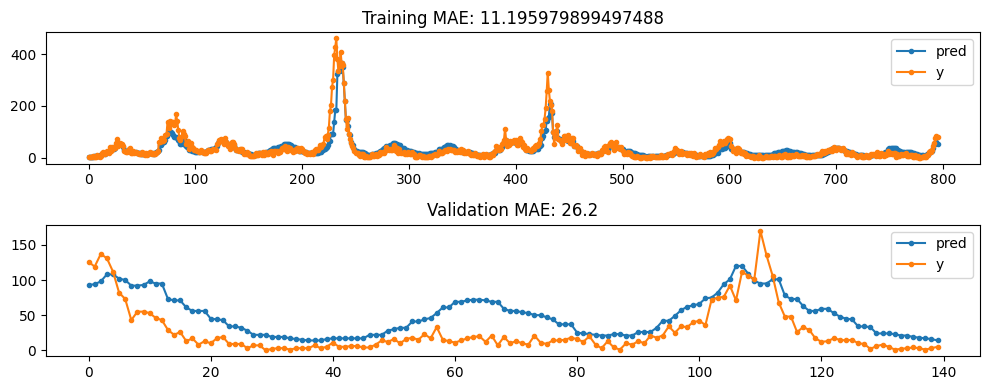

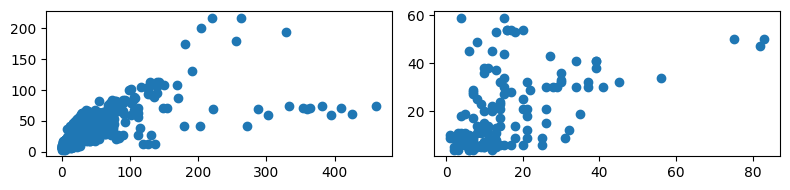

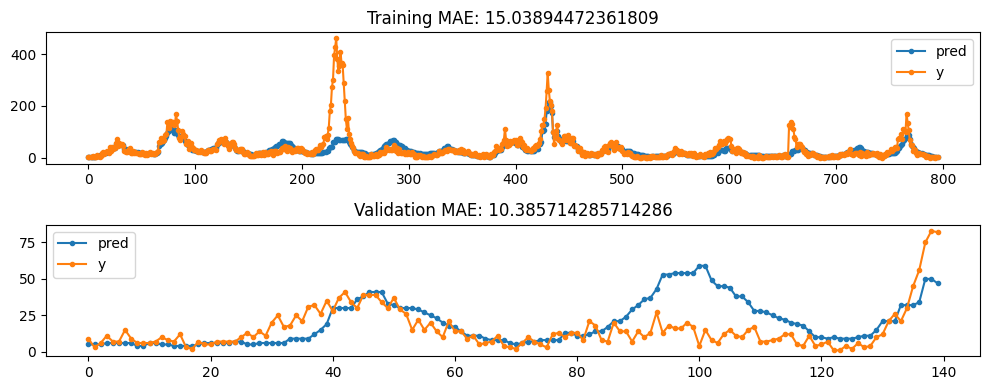

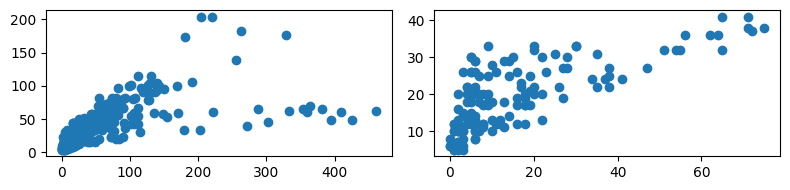

...

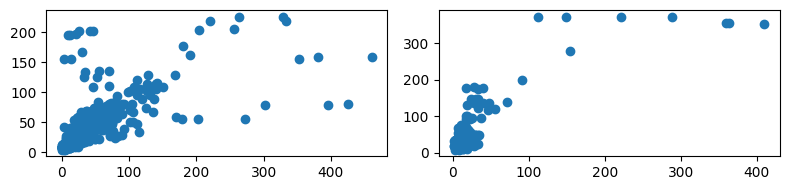

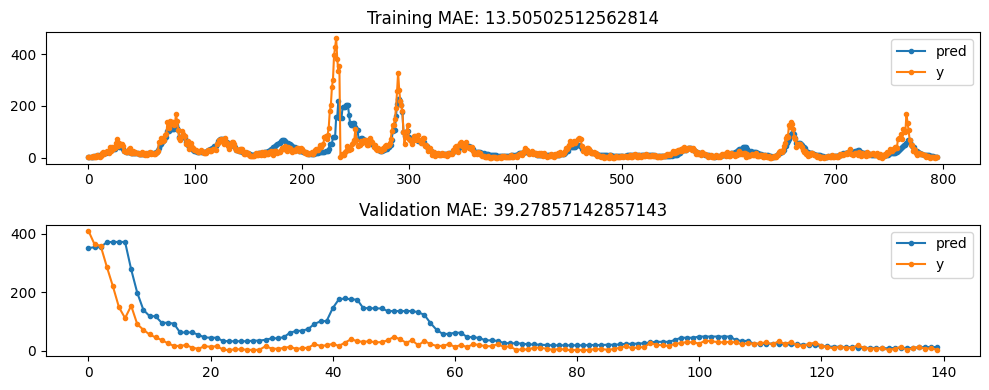

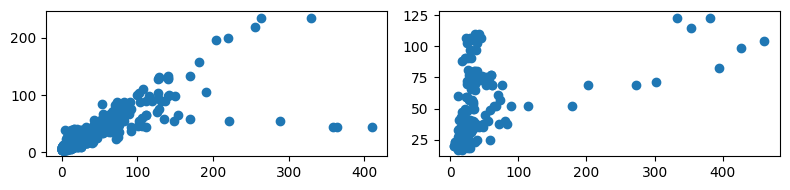

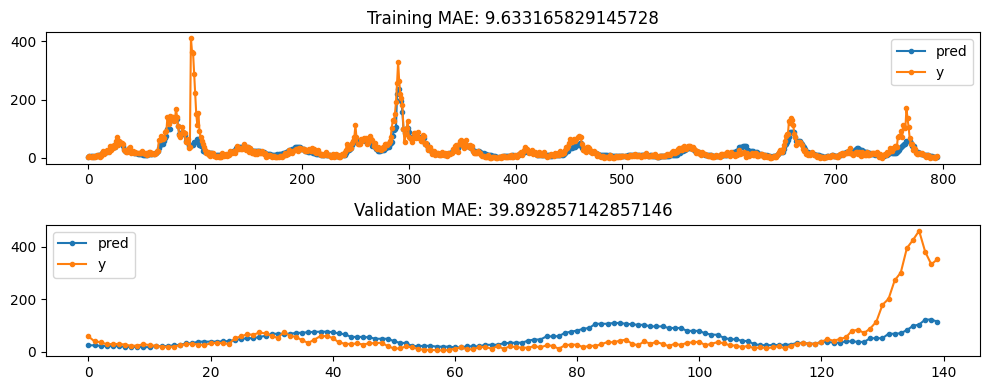

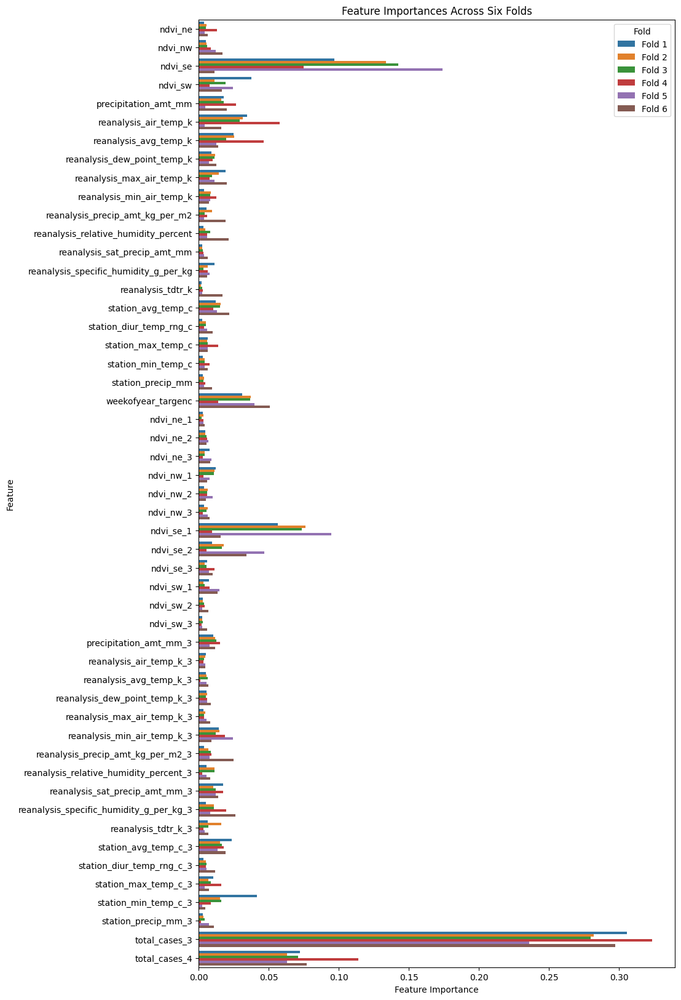

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


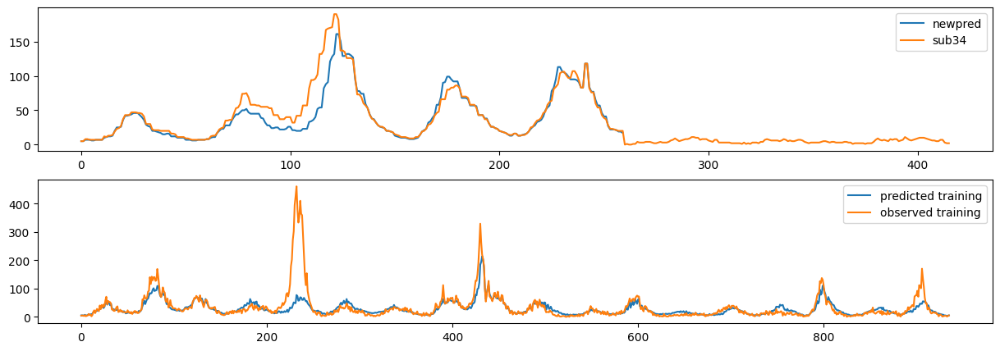

In [47]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features,\
    sj_labels, iq_labels,\
        sj_targenc_woy, iq_targenc_woy = preprocess(train_features_or,labels=train_labels,
                                                    features_to_keep = feature_names,
                                                    lagged_features = lagged_features,
                                                    fillna = 'ffill', smooth_feat = 3,
                                                    feature_lags=None, label_lags=label_lags,
                                                    circular_weekofyear=3,
                                                    weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                           features_to_keep = feature_names + lagged_label_names,
                                           lagged_features = lagged_features,
                                           fillna = 'ffill', smooth_feat = 3,
                                           feature_lags=None, label_lags=None,
                                           circular_weekofyear=(sj_targenc_woy, iq_targenc_woy),
                                           weekofyear_shift=10)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub34['total_cases'],label='sub34')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

Text(0.5, 1.0, 'Training data, target-encoded, weekofyear shifting = 10')

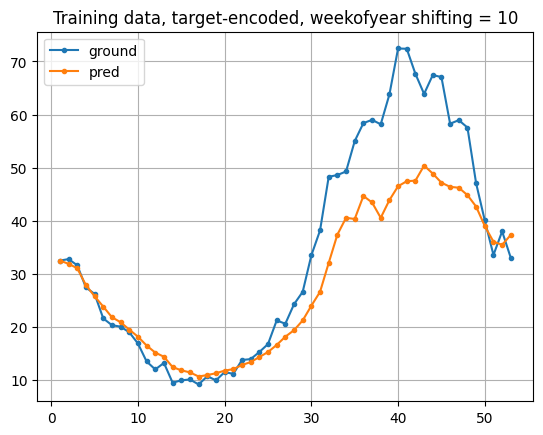

In [60]:
# Before week shifting
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.plot(df_temp.groupby('weekofyear').mean(),'.-',label='ground')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
plt.plot(df_temp2.groupby('weekofyear').mean(),'.-',label='pred')
plt.legend()
plt.grid()
plt.title('Training data, target-encoded, weekofyear shifting = 10')

weekofyear shifting makes the peaks align better. but prediction for second half of year still underestimated. what if we artificially raise it?

Text(0.5, 1.0, 'Training data, target-encoded, weekofyear shifting = 10')

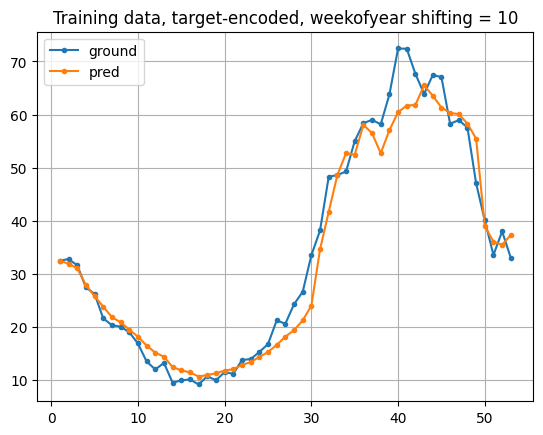

In [61]:
# Before week shifting
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.plot(df_temp.groupby('weekofyear').mean(),'.-',label='ground')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
df_temp2.loc[(df_temp2['weekofyear']>30) & (df_temp2['weekofyear']<50),'total_cases'] *= 1.3
plt.plot(df_temp2.groupby('weekofyear').mean(),'.-',label='pred')
plt.legend()
plt.grid()
plt.title('Training data, target-encoded, weekofyear shifting = 10')

Text(0.5, 1.0, 'Training data, target-encoded, weekofyear shifting = 10')

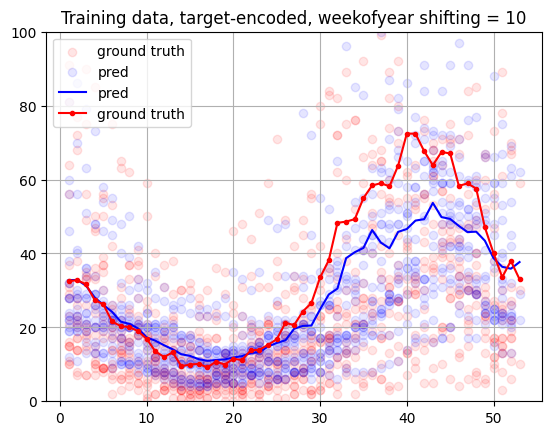

In [31]:
# Before week shifting
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.scatter(df_temp['weekofyear'],df_temp['total_cases'],label='ground truth',alpha=0.1,c='red')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
plt.scatter(df_temp2['weekofyear'],df_temp2['total_cases'],label='pred',alpha=0.1,c='blue')

plt.plot(df_temp2.groupby('weekofyear').mean(),label='pred',c='blue')
plt.plot(df_temp.groupby('weekofyear').mean(),'.-',label='ground truth',c='red')

plt.legend()
plt.grid()
plt.ylim([0,100])
plt.title('Training data, target-encoded, weekofyear shifting = 10')

#### Target encoding weekofyear + artificially raising second half of year prediction

Artificial raising does not work. prob since the higher values in second half is mainly due to rare spikes, not a general rule.

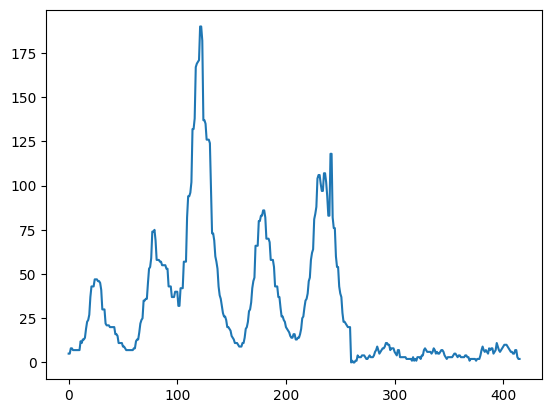

In [7]:
best_case_sub34 = pd.read_csv('submission_34.csv')
plt.plot(best_case_sub34['total_cases'])

In [8]:
def eval_and_plot(model,X_train_all,y_train_all,X_val_all,y_val_all,
                  train_woy_all, val_woy_all,
                  label_lags=None,
                  plot=True,verbose=True, MC=None,get_pred_train=True,
                  two_cities=False, median_filter: Optional[int]=None):
    '''
    Evaluate by predicting validation set and optionally plotting
    X_train: Dataframe of train features. Iterable of two dataframes if two_cities is True
    y_train: Dataframe of train labels. Iterable of two dataframes if two_cities is True
    X_val: Dataframe of val features. Iterable of two dataframes if two_cities is True
    y_val: Dataframe of val labels. Iterable of two dataframes if two_cities is True
    get_pred_train: True to calculate using previously predicted labels as lagged labels
    two_cities: Training model on both cities, requires splitting.
    median_filter: Apply median filtering to results.
    '''

    # If both cities trained together, input should be iterable of two datasets
    if two_cities:
        assert len(X_train_all)==2
        assert len(y_train_all)==2
        assert len(X_val_all)==2
        assert len(y_val_all)==2
        assert len(train_woy_all)==2
        assert len(val_woy_all)==2
    else:
        X_train_all = [X_train_all]
        y_train_all = [y_train_all]
        X_val_all = [X_val_all]
        y_val_all = [y_val_all]
        train_woy_all = [train_woy_all]
        val_woy_all = [val_woy_all]
        
    # Collect values separately for each city
    pred_train_all = []
    pred_val_all = []
    train_mae_all = []
    val_mae_all = []

    for X_train, y_train, X_val, y_val,train_woy,val_woy in zip(X_train_all, y_train_all, X_val_all, y_val_all,train_woy_all,val_woy_all):
        # Get predicted train values
        if get_pred_train:
            pred_train = get_predictions(model, X_train, label_lags, MC=MC)
        else:
            pred_train = model.predict(X_train)

        if median_filter is not None:
            pred_train = medfilt(pred_train,median_filter)

        # Artificially raising later half year values
        pred_train[(train_woy>30) & (train_woy<50)] *= 1.3
                
        pred_train = np.round(pred_train)
        pred_train = np.clip(pred_train, 0, 10000000)
        
        train_mae = mean_absolute_error(y_train, pred_train)
        if verbose:
            print("Train MAE:", train_mae)

        # Get prediction validation values
        pred_val = get_predictions(model, X_val, label_lags, MC=MC)
        
        # Artificially raising later half year values
        pred_val[(val_woy>30) & (val_woy<50)] *= 1.3

        if median_filter is not None:
            pred_val = medfilt(pred_val,median_filter)

        if MC is None:
            val_mae = mean_absolute_error(y_val, pred_val)
        else:
            val_mae = mean_absolute_error(y_val, np.mean(pred_val,axis=1))
        if verbose:
            print("Val MAE:", val_mae)
        
        pred_train_all.append(pred_train)
        pred_val_all.append(pred_val)
        train_mae_all.append(train_mae)
        val_mae_all.append(val_mae)
        
    if plot:
        for pred_train, pred_val, y_train, y_val, train_mae, val_mae in zip(pred_train_all, pred_val_all,y_train_all, y_val_all, train_mae_all, val_mae_all):
            fig, axs = plt.subplots(1,2,figsize=(8,2))
            fig2, axs2 = plt.subplots(2,1,figsize=(10,4))
            axs[0].scatter(y_train, pred_train)
            pred_train = pd.Series(pred_train, index=y_train.index)
            axs2[0].plot(np.arange(len(pred_train)), pred_train.sort_index(),marker='.',label='pred');
            axs2[0].plot(np.arange(len(y_train)), y_train.sort_index(),marker='.',label='y');
            axs2[0].legend();
            axs2[0].set_title(f'Training MAE: {train_mae}')


            if MC is None:
                axs[1].scatter(y_val, pred_val)
                pred_val = pd.Series(pred_val, index=y_val.index)
                axs2[1].plot(np.arange(len(pred_val)), pred_val.sort_index(),marker='.',label='pred');
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),marker='.',label='y');
                axs2[1].legend();
                axs2[1].set_title(f'Validation MAE: {val_mae}')
            else:
                axs[1].scatter(y_val, np.mean(pred_val,axis=1))
                            
                for l in range(MC):
                    axs2[1].plot(np.arange(pred_val.shape[0]), pred_val[:,l],alpha=0.2,color='grey');
                axs2[1].plot(np.arange(pred_val.shape[0]), np.mean(pred_val,axis=1),color='red');                
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),color='k',marker='.');
            fig.tight_layout()
            fig2.tight_layout()
            
        if not two_cities: # Unpacking directly if individually trained
            pred_train_all, pred_val_all, train_mae_all, val_mae_all = pred_train_all[0], pred_val_all[0], train_mae_all[0], val_mae_all[0]

    return pred_train_all, pred_val_all, train_mae_all, val_mae_all


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

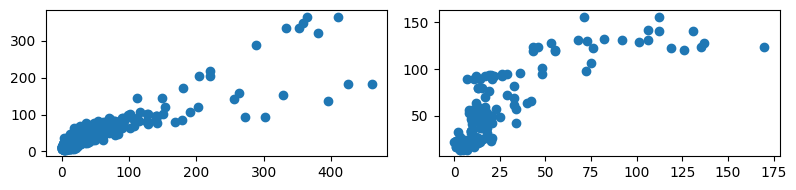

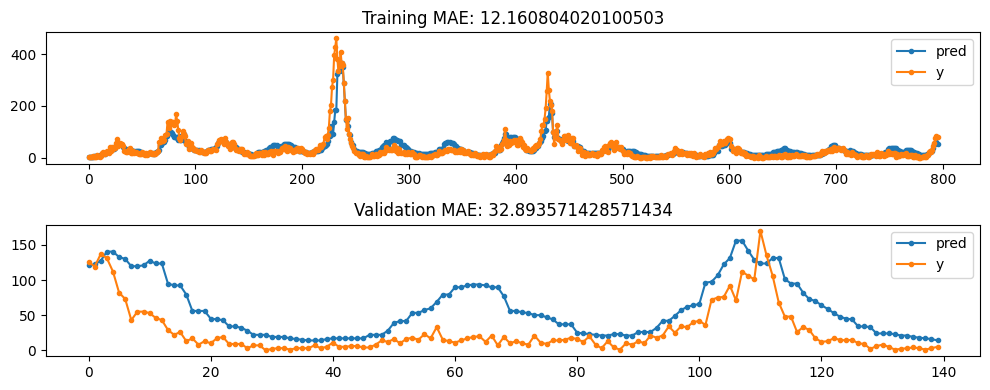

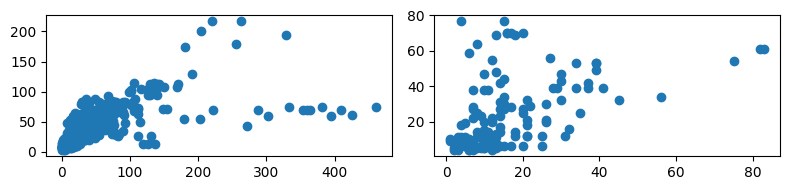

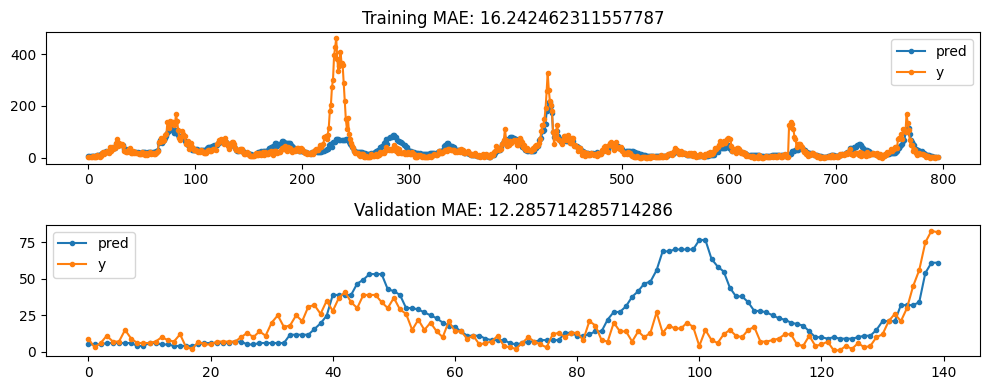

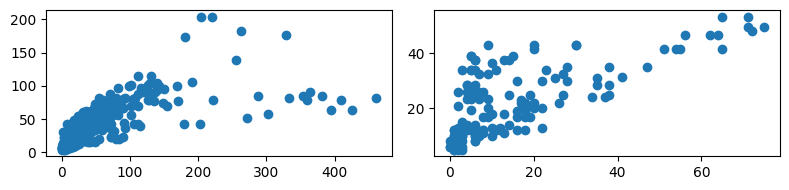

...

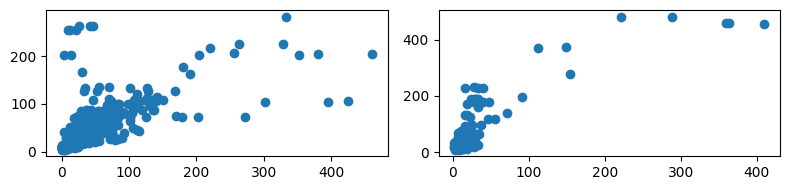

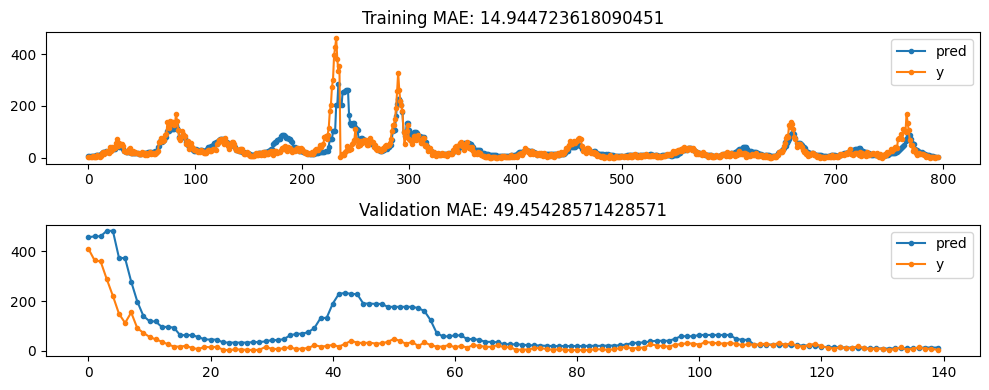

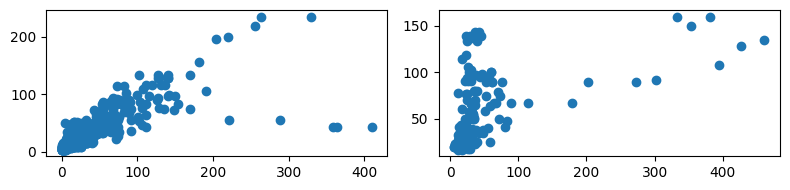

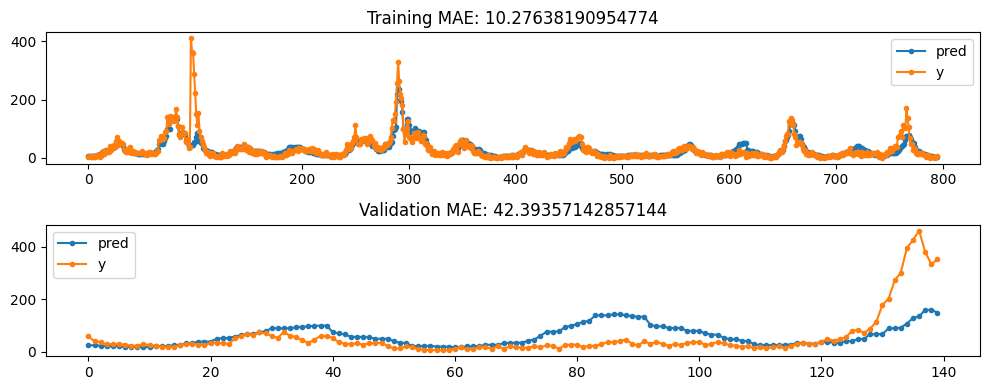

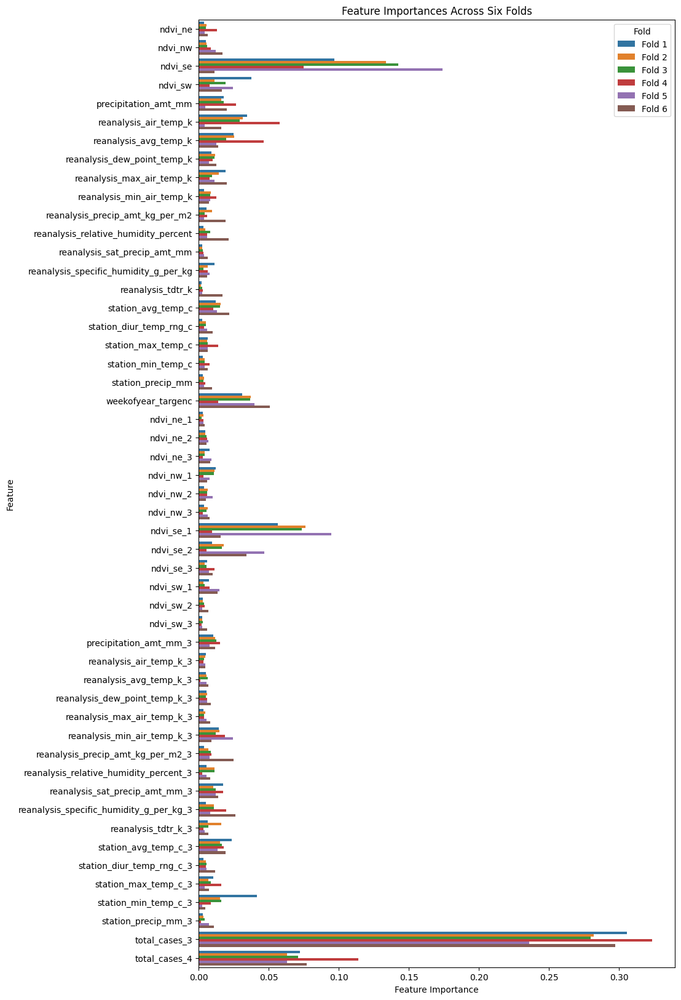

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


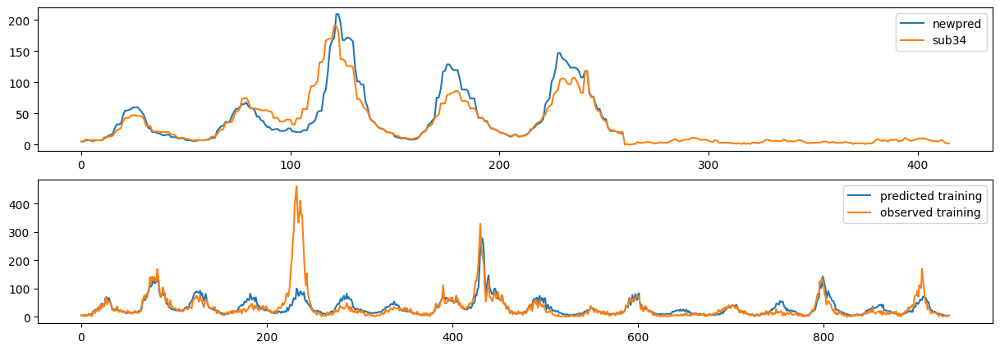

In [12]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

########################################################
# Getting matching weekofyear values
sj_features, iq_features,\
    sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                    features_to_keep = feature_names,
                                                    lagged_features = lagged_features,
                                                    fillna = 'ffill', smooth_feat = 3,
                                                    feature_lags=None, label_lags=label_lags,
                                                    circular_weekofyear=None,
                                                    weekofyear_shift=0)
X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,                                                           folds=6, fold_size=0.15)
train_sj_woy = [df['weekofyear'] for df in X_train_sj]
val_sj_woy = [df['weekofyear'] for df in X_val_sj]
train_iq_woy = [df['weekofyear'] for df in X_train_iq]
val_iq_woy = [df['weekofyear'] for df in X_val_iq]
########################################################



# Preprocess to get lagged features/labels
sj_features, iq_features,\
    sj_labels, iq_labels,\
        sj_targenc_woy, iq_targenc_woy = preprocess(train_features_or,labels=train_labels,
                                                    features_to_keep = feature_names,
                                                    lagged_features = lagged_features,
                                                    fillna = 'ffill', smooth_feat = 3,
                                                    feature_lags=None, label_lags=label_lags,
                                                    circular_weekofyear=3,
                                                    weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)

    ########################################################
    pred_train_sj, pred_val_sj,\
    train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                             X_val_sj[fold],y_val_sj[fold],
                                             train_sj_woy[fold],val_sj_woy[fold],
                                             label_lags=label_lags,
                                             verbose=False,plot=True, MC=None, get_pred_train=True,
                                             median_filter=3)
    ########################################################
    
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
    
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

########################################################
# Getting matching weekofyear values
sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                           features_to_keep = feature_names + lagged_label_names,
                                           lagged_features = lagged_features,
                                           fillna = 'ffill', smooth_feat = 3,
                                           feature_lags=None, label_lags=None,
                                           circular_weekofyear=None,
                                           weekofyear_shift=0)
sj_pred_woy = sj_pred_features_aug['weekofyear']
########################################################

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                           features_to_keep = feature_names + lagged_label_names,
                                           lagged_features = lagged_features,
                                           fillna = 'ffill', smooth_feat = 3,
                                           feature_lags=None, label_lags=None,
                                           circular_weekofyear=(sj_targenc_woy, iq_targenc_woy),
                                           weekofyear_shift=10)
# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)

########################################################
# Artificially raising later half year values
sj_sub_pred[(sj_pred_woy>30) & (sj_pred_woy<50)] *= 1.3
########################################################

sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub34['total_cases'],label='sub34')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)

########################################################
# Getting matching weekofyear values
train_sj_woy = pd.concat([train_sj_woy[0], val_sj_woy[0]],axis=0).sort_index()
sj_train_pred[(train_sj_woy>30) & (train_sj_woy<50)] *= 1.3
########################################################


axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

Text(0.5, 1.0, 'Training data, target-encoded, weekofyear shifting = 10')

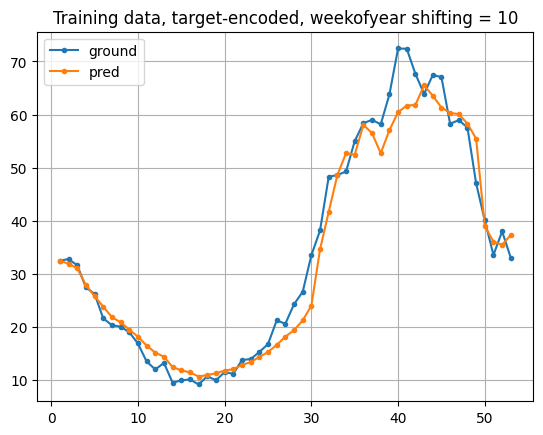

In [13]:
# Before week shifting
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.plot(df_temp.groupby('weekofyear').mean(),'.-',label='ground')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
plt.plot(df_temp2.groupby('weekofyear').mean(),'.-',label='pred')
plt.legend()
plt.grid()
plt.title('Training data, target-encoded, weekofyear shifting = 10')

#### Try CatBoost

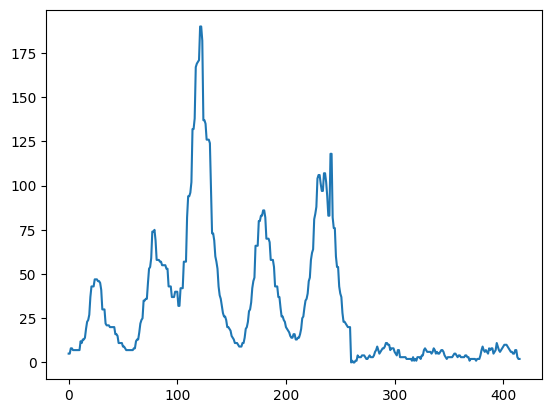

In [8]:
best_case_sub34 = pd.read_csv('submission_34.csv')
plt.plot(best_case_sub34['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
0:	learn: 49.5168713	total: 5.99ms	remaining: 5.98s
500:	learn: 6.1952818	total: 2.09s	remaining: 2.08s
999:	learn: 4.8492198	total: 4.58s	remaining: 0us

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
0:	learn: 50.2859412	total: 5.46ms	remaining: 5.46s
500:	learn: 5.5532230	total: 2.56s	remaining: 2.55s
999:	learn: 4.6247472	total: 5.01s	remaining: 0us

 ~~~~~~~~~~~~~~ Running fold 3 of 6 ~~~~~~~~~~~~~~ 
0:	learn: 50.3810465	total: 6.29ms	remaining: 6.28s
500:	learn: 6.2556488	total: 2.52s	remaining: 2.51s
999:	learn: 5.2336272	total: 4.81s	remaining: 0us

 ~~~~~~~~~~~~~~ Running fold 4 of 6 ~~~~~~~~~~~~~~ 
0:	learn: 46.7625981	total: 6.2ms	remaining: 6.19s
500:	learn: 5.0962085	total: 2.53s	remaining: 2.52s
999:	learn: 3.9487276	total: 5.07s	remaining: 0us

 ~~~~~~~~~~~~~~ Running fold 5 of 6 ~~~~~~~~~~~~~~ 
0:	learn: 45.6929358	total: 6.38ms	remaining: 6.38s
500:	learn: 5.3564220	total: 2.56s	remaining: 2.56s
999:	learn: 4.40

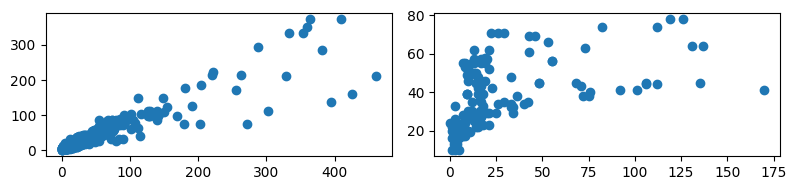

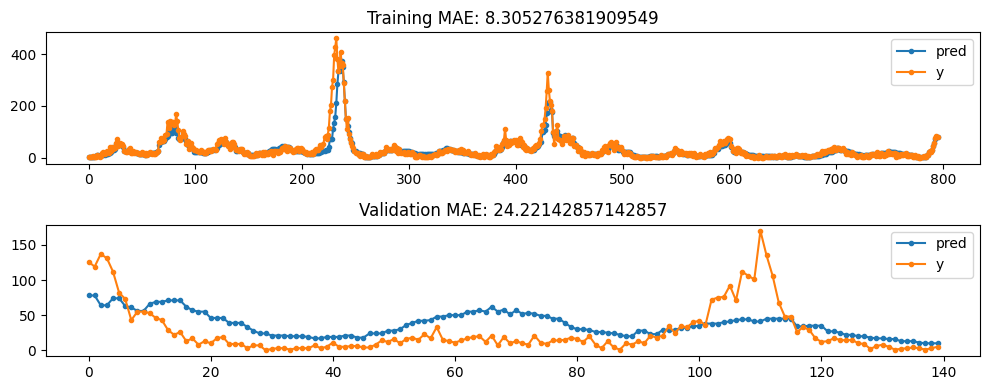

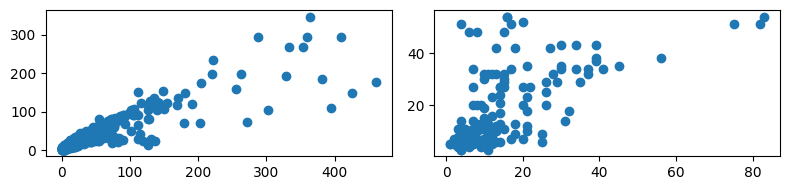

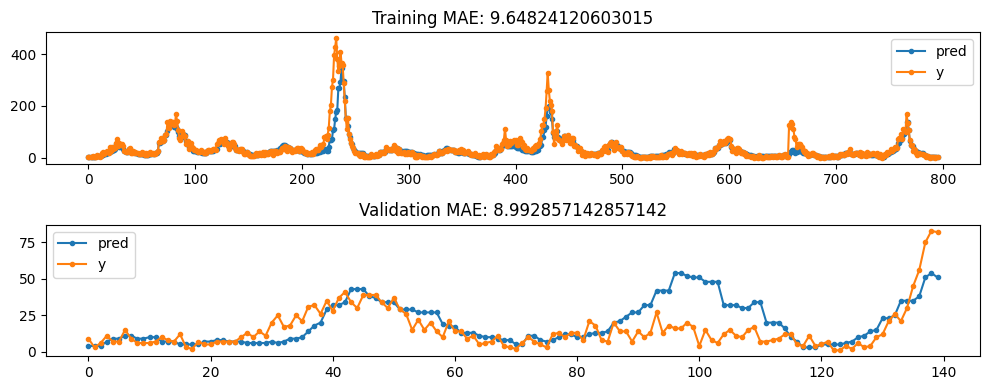

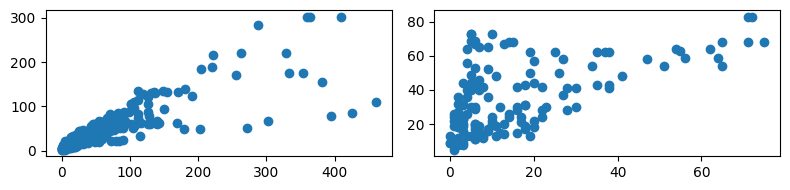

...

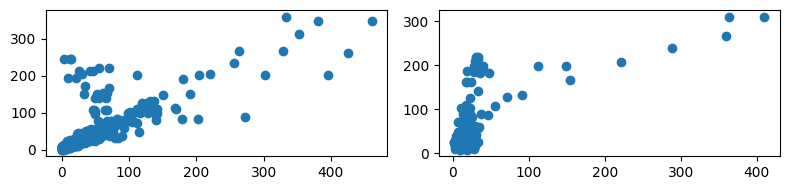

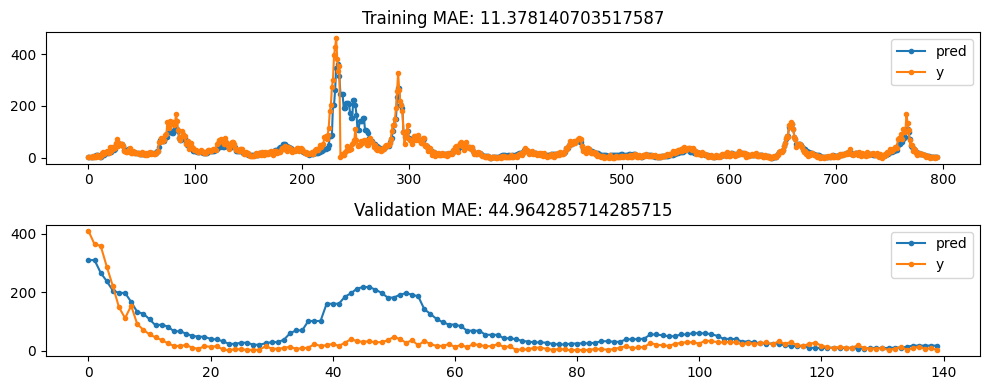

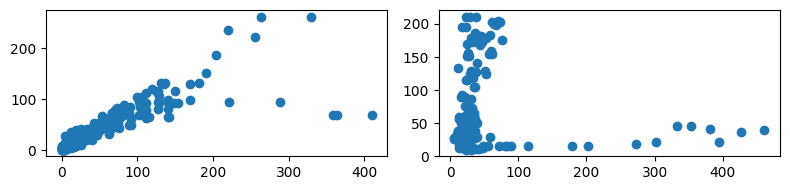

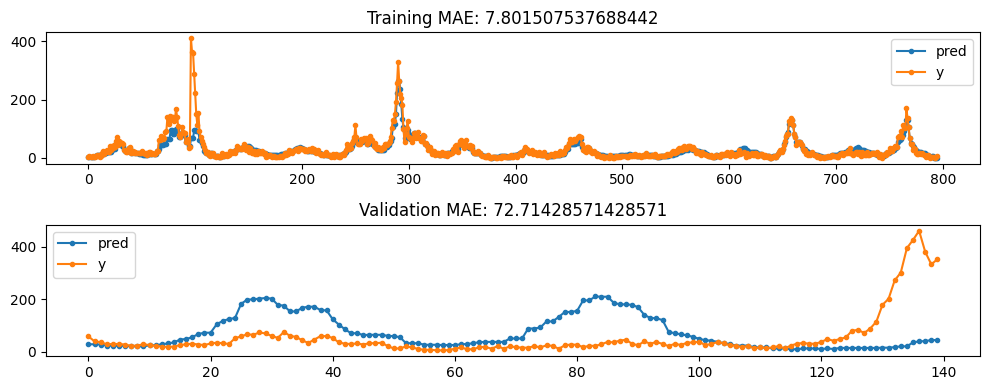

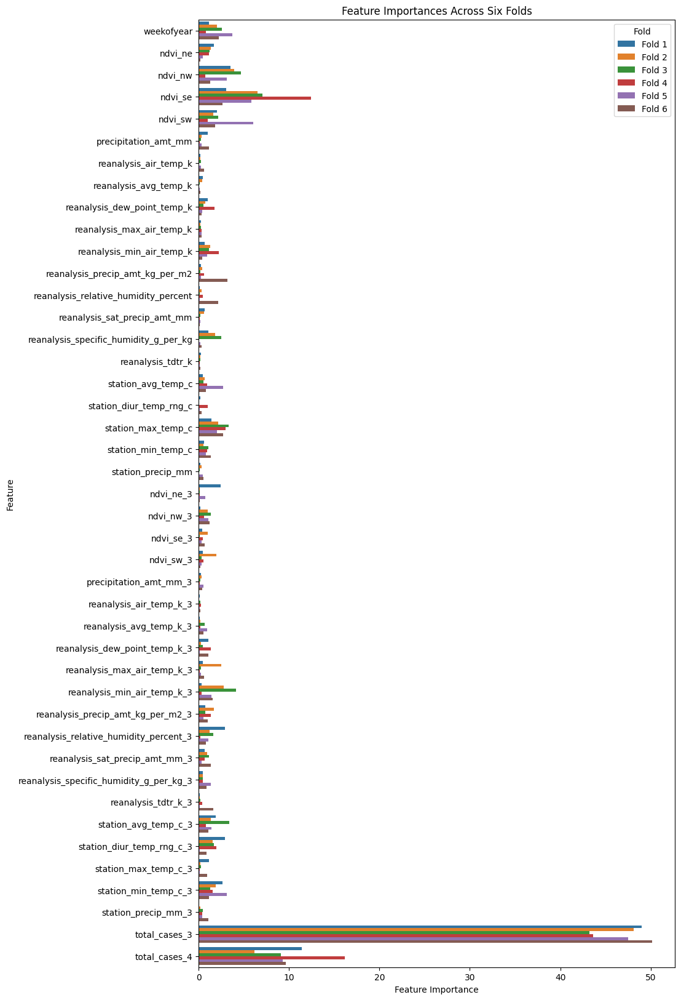

0:	learn: 47.5224137	total: 5.52ms	remaining: 5.52s
500:	learn: 5.8168926	total: 2.46s	remaining: 2.45s
999:	learn: 4.4165197	total: 4.97s	remaining: 0us


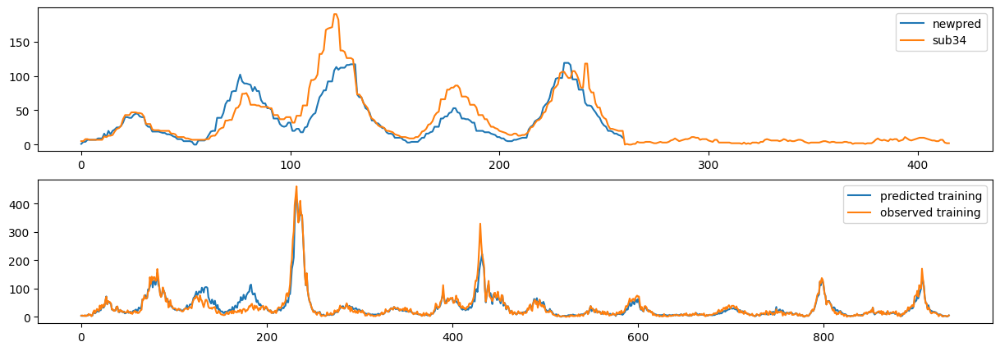

In [31]:
# Specify modelling parameters
iterations=1000
learning_rate=0.1
depth=7
l2_leaf_reg=1
weekofyear_shift = -10
smooth_feat = 3

# lags
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[3,] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
# lagged_features_others = {col:(3,8,13,17) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', smooth_feat = smooth_feat,
                                                            feature_lags=None, label_lags=label_lags,
                                                            circular_weekofyear=2,
                                                            weekofyear_shift=weekofyear_shift)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(cb.CatBoostRegressor(loss_function='RMSE',
                             task_type='GPU',devices='0',
                             metric_period=500,
                             iterations=iterations, learning_rate=learning_rate,
                             depth=depth,l2_leaf_reg=l2_leaf_reg))
    
    train_dataset = cb.Pool(data=X_train_sj[fold], label=y_train_sj[fold])
    xg_reg_sj[fold].fit(train_dataset)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

train_dataset = cb.Pool(data=X_train_sj, label=y_train_sj)
model_sj = cb.CatBoostRegressor(loss_function='RMSE',
                             task_type='GPU',devices='0',
                             metric_period=500,
                             iterations=iterations, learning_rate=learning_rate,
                             depth=depth,l2_leaf_reg=l2_leaf_reg)

model_sj.fit(train_dataset)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                           features_to_keep = feature_names + lagged_label_names,
                                           lagged_features = lagged_features,
                                           fillna = 'ffill', smooth_feat = smooth_feat,
                                           feature_lags=None, label_lags=None,
                                           circular_weekofyear=2,weekofyear_shift=weekofyear_shift)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub34['total_cases'],label='sub34')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

Text(0.5, 1.0, 'Training data, sine-encoded, weekofyear shifting = 10')

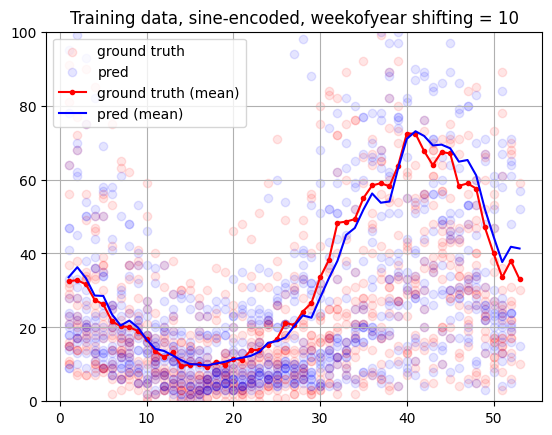

In [32]:
df_temp = sj_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='sj','weekofyear']
plt.scatter(df_temp['weekofyear'],df_temp['total_cases'],label='ground truth',alpha=0.1,c='red')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = sj_train_pred
plt.scatter(df_temp2['weekofyear'],df_temp2['total_cases'],label='pred',alpha=0.1,c='blue')

plt.plot(df_temp.groupby('weekofyear').mean(),'.-',label='ground truth (mean)',c='red')
plt.plot(df_temp2.groupby('weekofyear').mean(),label='pred (mean)',c='blue')

plt.legend()
plt.grid()
plt.ylim([0,100])
plt.title('Training data, sine-encoded, weekofyear shifting = 10')

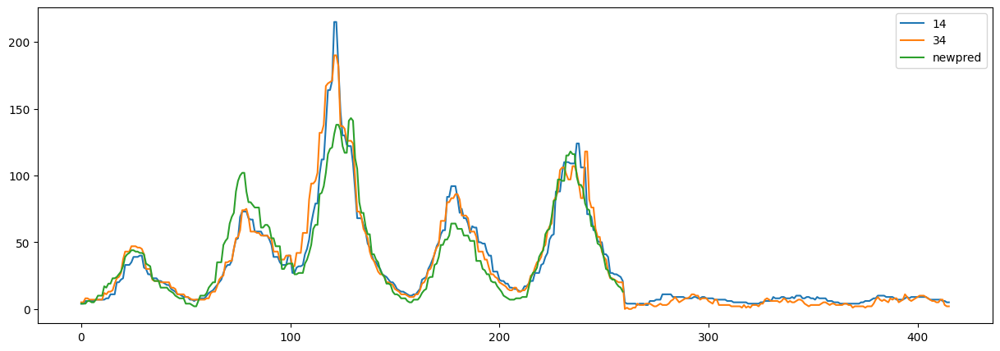

In [54]:
best_case_sub14 = pd.read_csv('submission_14.csv')
plt.figure(figsize=(15,5))
plt.plot(best_case_sub14['total_cases'],label='14')
plt.plot(best_case_sub34['total_cases'],label='34')
plt.plot(sj_sub_pred,label='newpred')
plt.legend()

##### param study

In [ ]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', smooth_feat = 3,
                                                            feature_lags=None, label_lags=label_lags,
                                                            circular_weekofyear=2,
                                                            weekofyear_shift=0)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

all_iterations = [500,1000,2000,2500]
all_learning_rate = [0.01,0.05,0.1]
all_depth = [4,7,9]
all_l2_leaf_reg = [4,5,7]
train_maes = []
val_maes = []
counter = 0

with open('dengue_catboost_param.txt', 'a') as f:
    for iterations in all_iterations:
        for learning_rate in all_learning_rate:
            for depth in all_depth:
                for l2_leaf_reg in all_l2_leaf_reg:
                    counter +=1
                    xg_reg_sj = []
                    for fold in range(folds):
                        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
                        xg_reg_sj.append(cb.CatBoostRegressor(loss_function='RMSE',
                                                task_type='GPU',devices='0',
                                                metric_period=500,
                                                iterations=2000, learning_rate=0.1,
                                                depth=7,l2_leaf_reg=5))
                        
                        train_dataset = cb.Pool(data=X_train_sj[fold], label=y_train_sj[fold])
                        xg_reg_sj[fold].fit(train_dataset)
                        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                                median_filter=3)
                        # Your computation or data collection
                        outstring = f"Model: {counter}, iterations: {iterations}, learning_rate: {learning_rate}, depth: {depth}, l2_leaf_reg: {l2_leaf_reg}, train_mae: {train_mae_sj}, val_mae: {val_mae_sj}\n"
                        print(outstring)
                        train_maes.append(train_mae_sj)
                        val_maes.append(val_mae_sj)
                        # Write to file
                        f.write(outstring)
                        
                        # Flush immediately to ensure data is written to file
                        f.flush()
    

In [10]:
with open('dengue_catboost_param.txt', 'r') as file:
    lines = file.readlines()

# Initialize a list to store the data
data = []

# Define a regex pattern to match the key-value pairs
pattern = r'(\w+):\s*(\[[^\]]+\]|\d+\.\d+|\d+)'

# Iterate over each line and extract the key-value pairs
for line in lines:
    # Find all matches in the line
    matches = re.findall(pattern, line)
    
    # Convert matches to a dictionary
    line_data = {key: eval(value) for key, value in matches}
    
    # Append the dictionary to the data list
    data.append(line_data)

# Create a DataFrame from the data list
df = pd.DataFrame(data)
df['fold'] = df.index%6+1
df.drop(columns='Model')

,iterations,learning_rate,depth,l2_leaf_reg,train_mae,val_mae,fold
0,500,0.01,4,4,21.646985,17.578571,1
1,500,0.01,4,4,22.997487,8.557143,2
2,500,0.01,4,4,21.704774,13.171429,3
3,500,0.01,4,4,18.958543,33.871429,4
4,500,0.01,4,4,20.961055,38.592857,5
...,...,...,...,...,...,...,...
643,2500,0.10,9,7,7.523869,12.571429,2
644,2500,0.10,9,7,5.243719,13.128571,3
645,2500,0.10,9,7,5.739950,36.114286,4
646,2500,0.10,9,7,8.760050,43.357143,5


<Axes: xlabel='fold', ylabel='val_mae'>

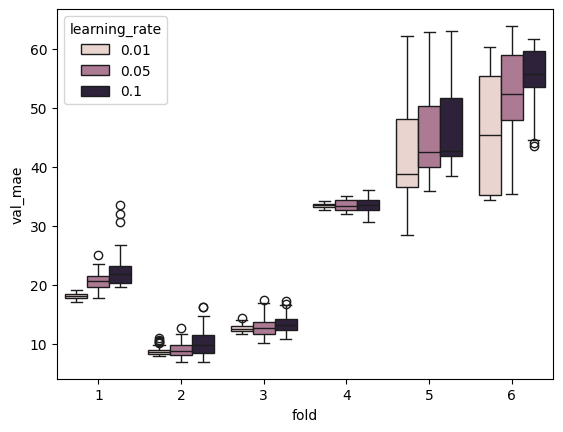

In [20]:
sns.boxplot(df,x='fold',y='val_mae',hue='learning_rate')

<Axes: xlabel='fold', ylabel='val_mae'>

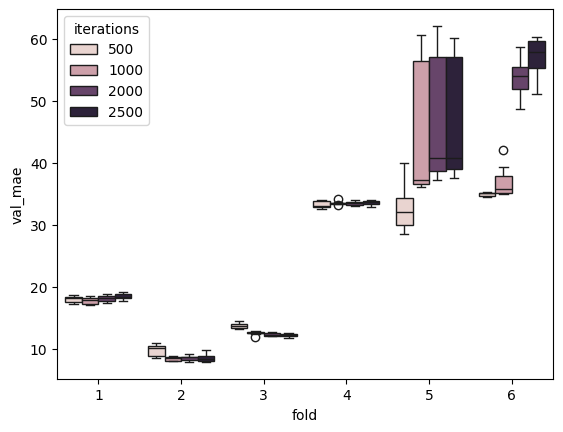

In [25]:
sns.boxplot(df.loc[(df.learning_rate==0.01)],x='fold',y='val_mae',hue='iterations')

<Axes: xlabel='fold', ylabel='val_mae'>

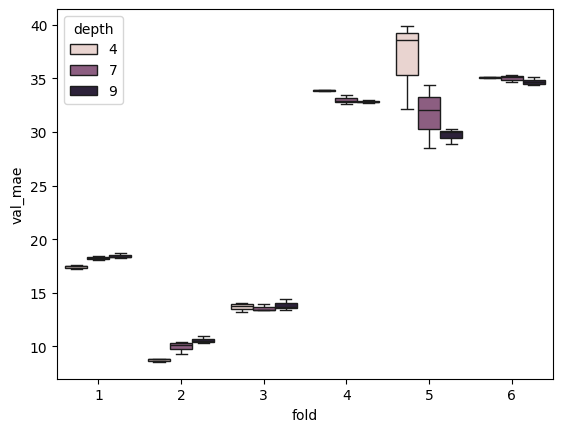

In [27]:
sns.boxplot(df.loc[(df.learning_rate==0.01) & (df.iterations==500) ],x='fold',y='val_mae',hue='depth')


<Axes: xlabel='fold', ylabel='val_mae'>

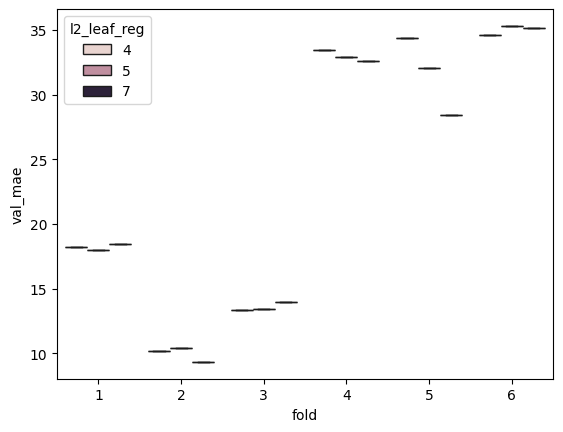

In [28]:
sns.boxplot(df.loc[(df.learning_rate==0.01) & (df.iterations==500) & (df.depth==7)],x='fold',y='val_mae',hue='l2_leaf_reg')


### Iquitos

#### Refinement - Trial 1, used in sub34 bringing marginal improvements

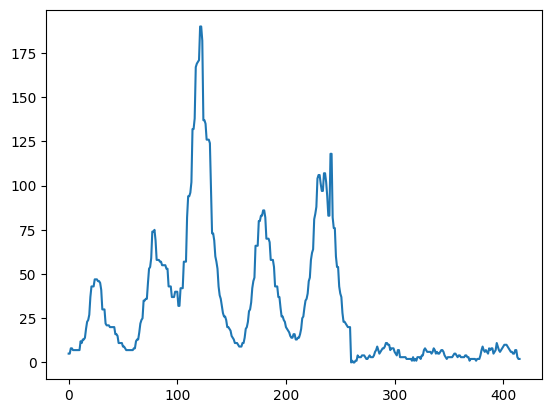

In [11]:
best_case_sub34 = pd.read_csv('submission_34.csv')
plt.plot(best_case_sub34['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

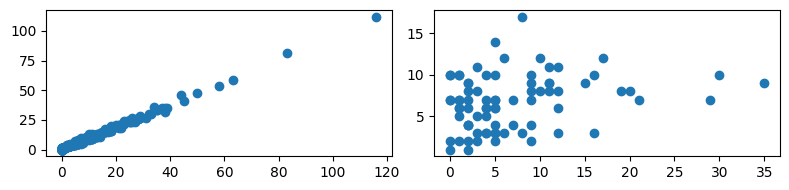

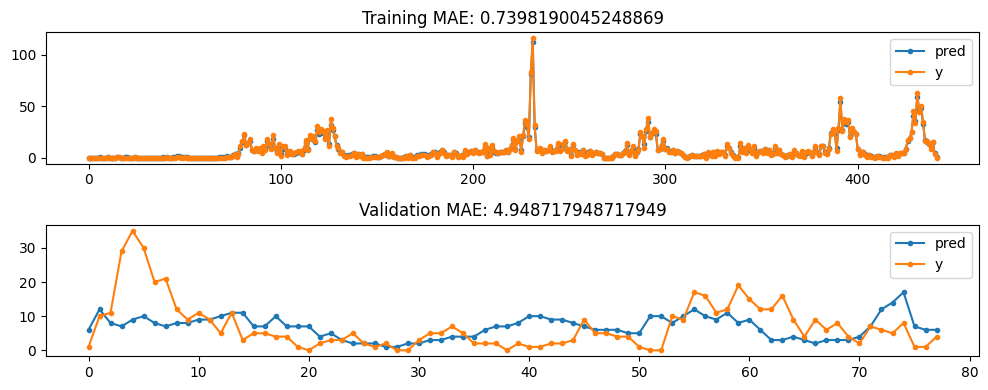

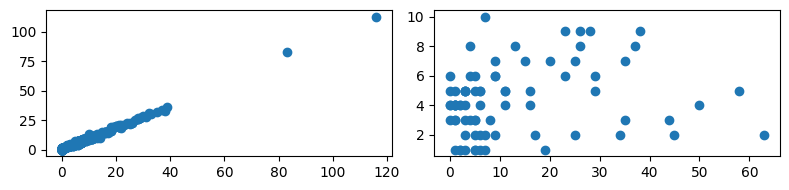

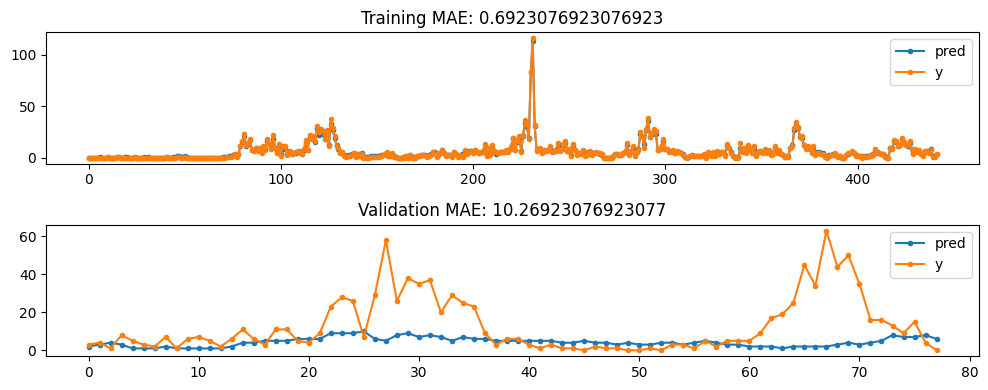

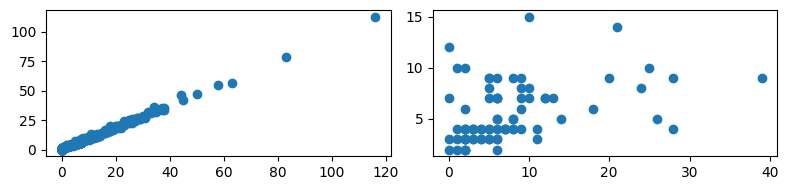

...

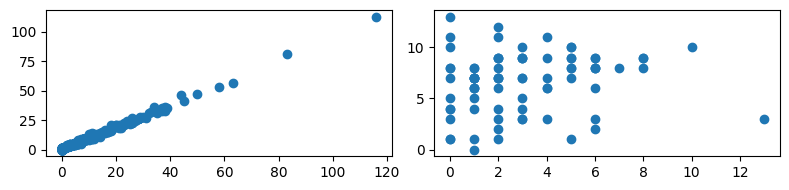

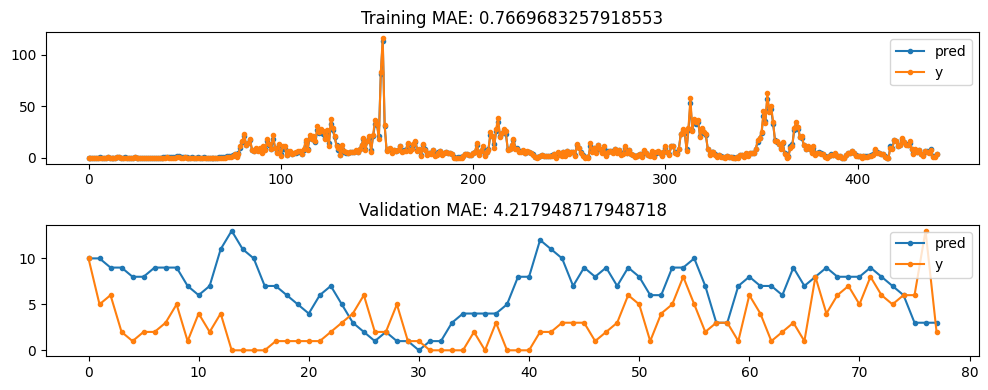

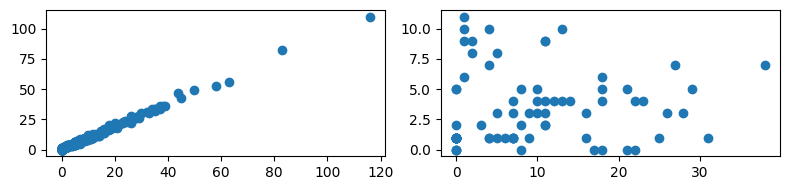

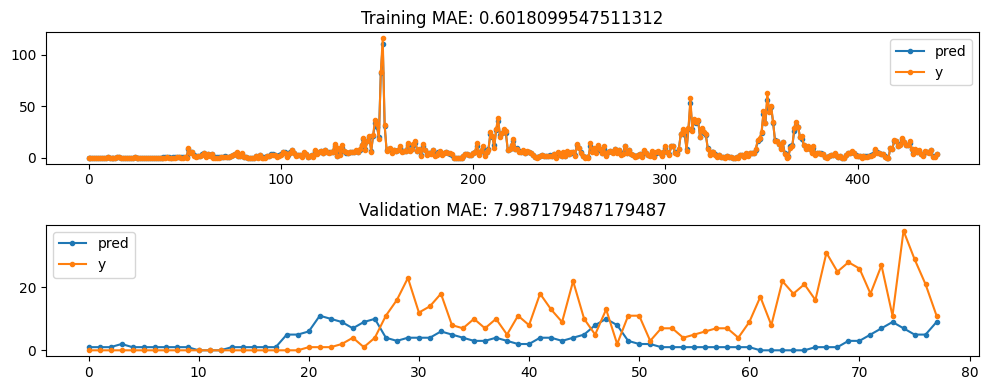

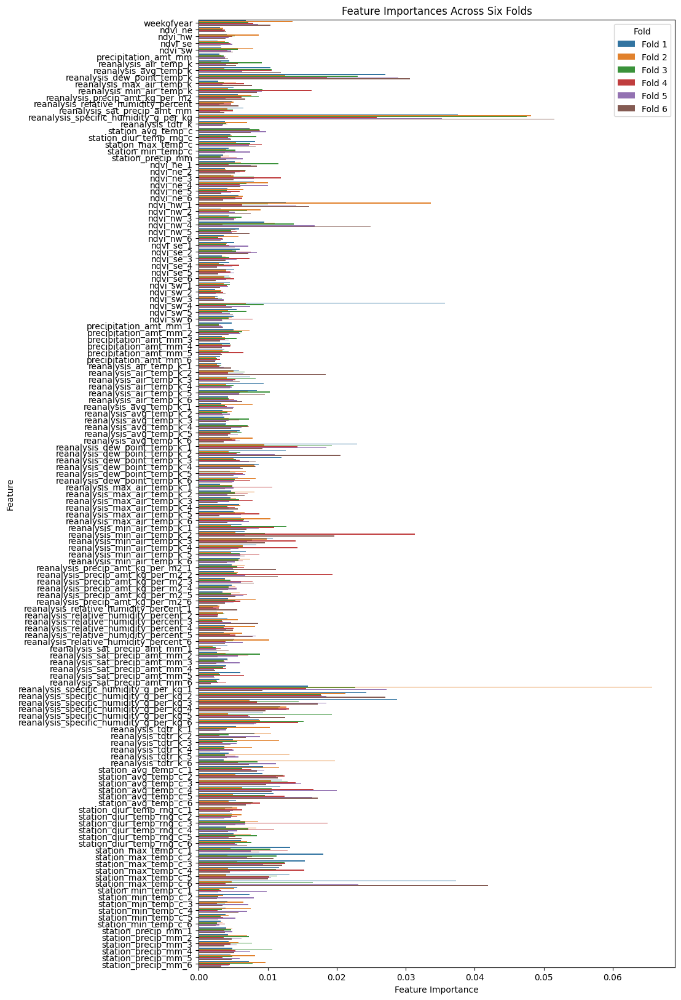

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


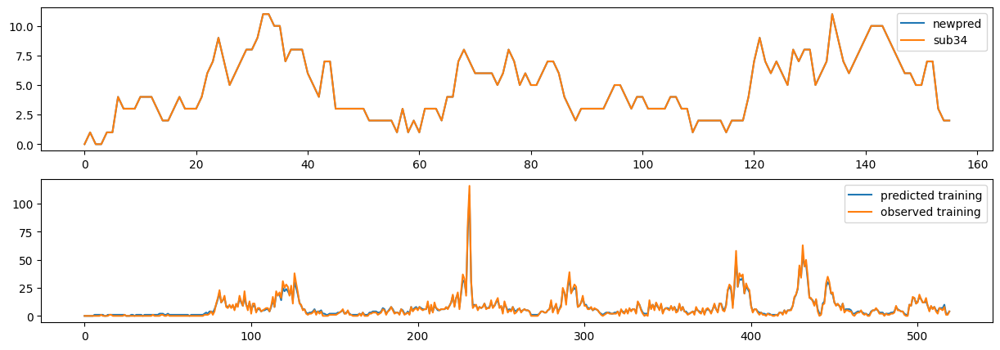

In [14]:
# Close to original best scoring
# Specify modelling parameters
# label_lags=(1,2,3)
label_lags=None
feature_lags = (1,2,3,4,5,6)
# feature_lags = None
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
# lagged_features = None

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features, smooth_feat = 3,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=2)

# # Dropping of week features
# sj_features.drop(columns=lagged_features, inplace=True)
# iq_features.drop(columns=lagged_features, inplace=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=1500,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=None)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features, smooth_feat = 3,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=2)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
# iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case_sub34[best_case_sub34['city']=='iq']['total_cases'].reset_index(drop=True),label='sub34')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

#### Refinement - Trial 2

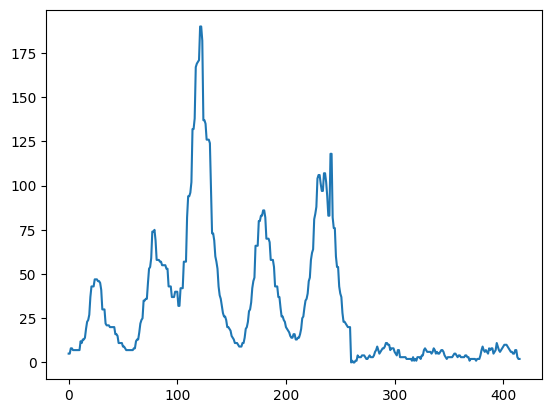

In [6]:
best_case_sub34 = pd.read_csv('submission_34.csv')
plt.plot(best_case_sub34['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

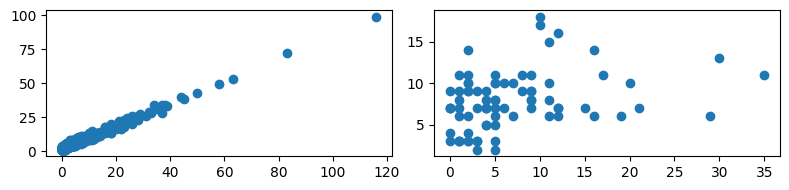

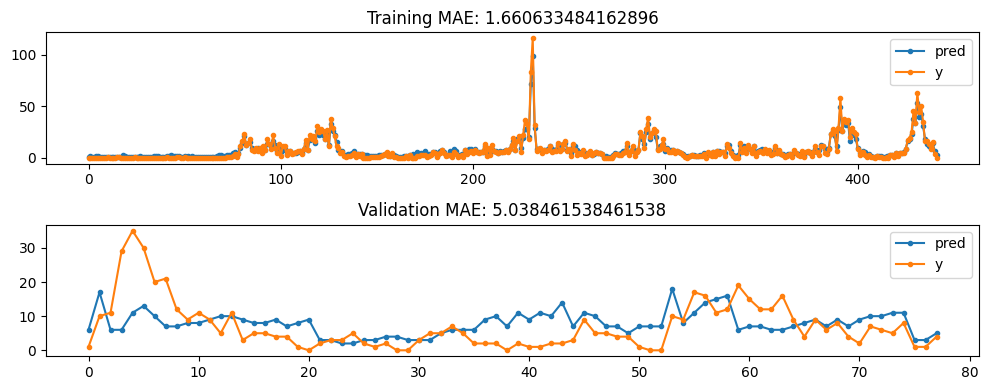

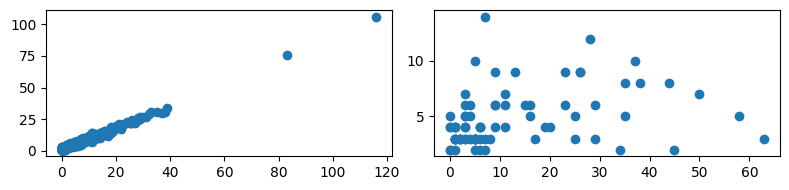

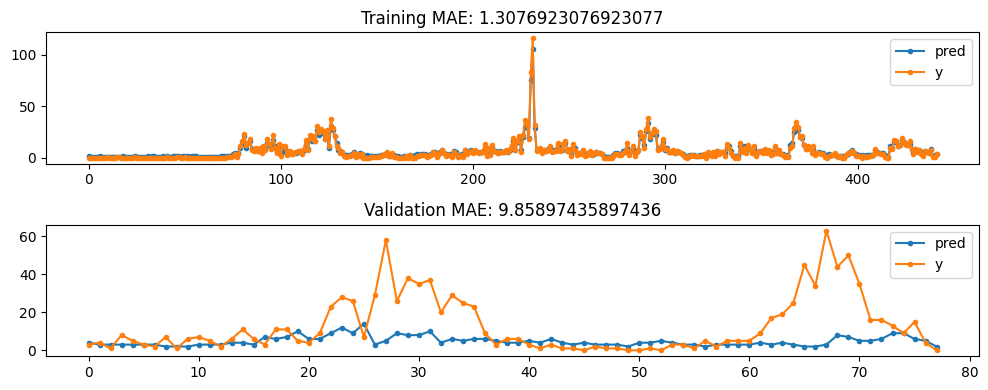

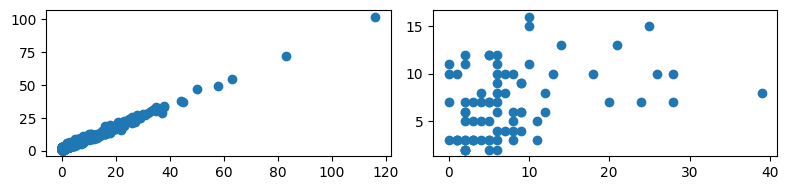

...

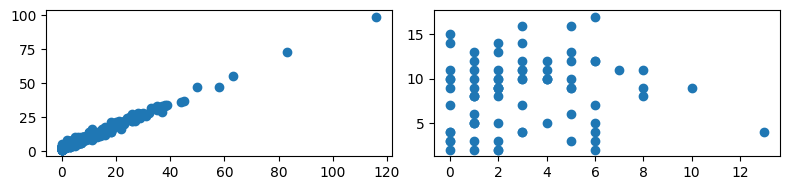

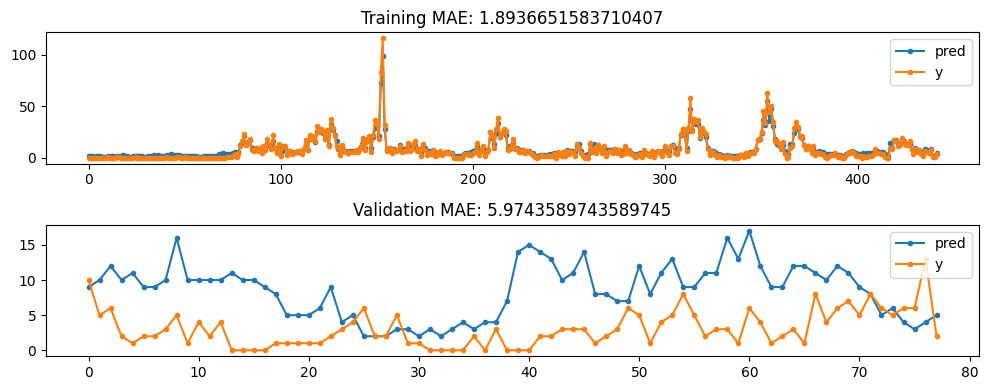

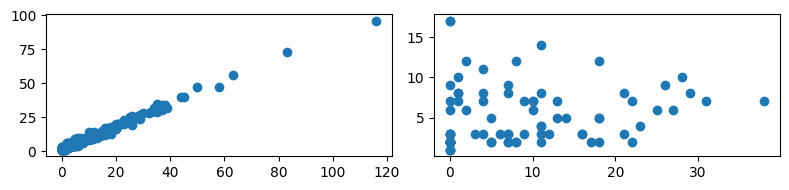

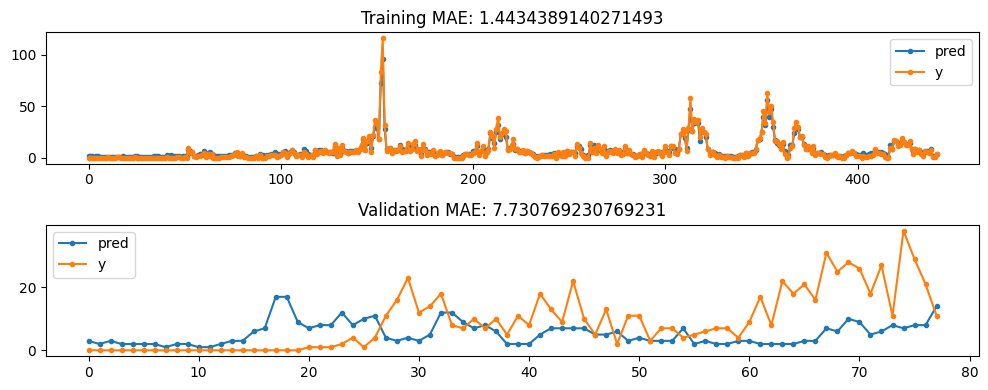

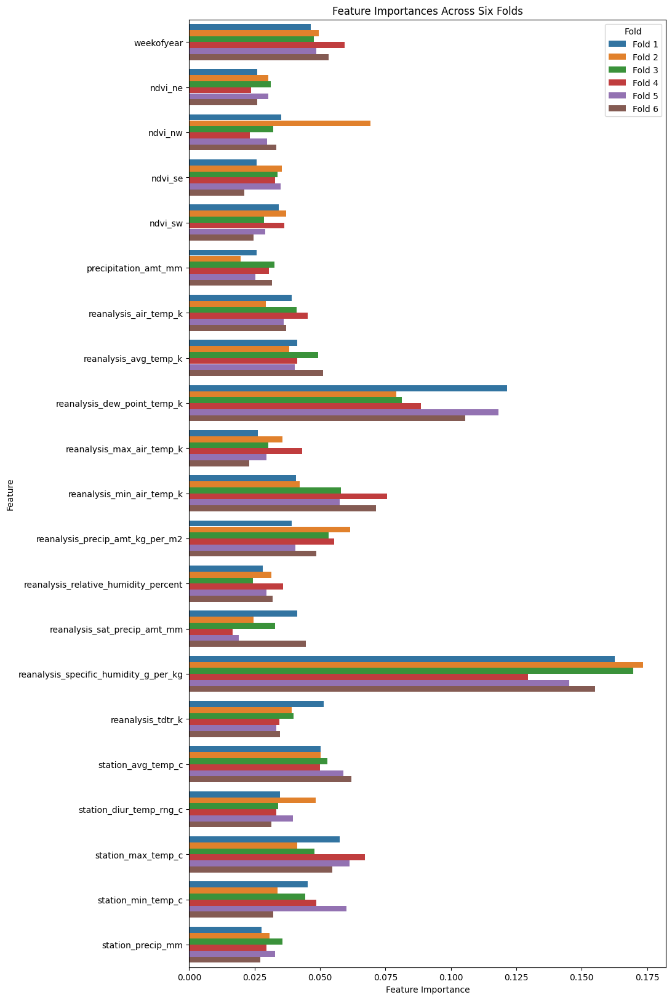

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


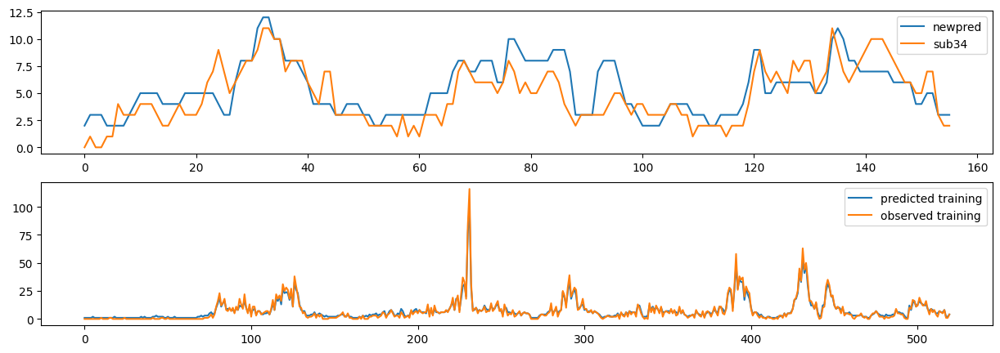

In [80]:
# Specify modelling parameterst
eta = 0.05
n_estimators = 1000
max_depth = 7
reg_alpha = 1
reg_lambda = 1
smooth_feat = 3
# objective = 'reg:squarederror'
objective = 'count:poisson'

# label_lags=(3,)
label_lags=None
# feature_lags = (1,2,3,4,5,6,7,8,9,10)
feature_lags = None
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
lagged_features = None

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features, smooth_feat=smooth_feat,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=4)

# # Dropping of week features
# sj_features.drop(columns=lagged_features, inplace=True)
# iq_features.drop(columns=lagged_features, inplace=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'rmse', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=None)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'rmse', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features, smooth_feat=smooth_feat,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=4)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case_sub34[best_case_sub34['city']=='iq']['total_cases'].reset_index(drop=True),label='sub34')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

Text(0.5, 1.0, 'Training data, IQ')

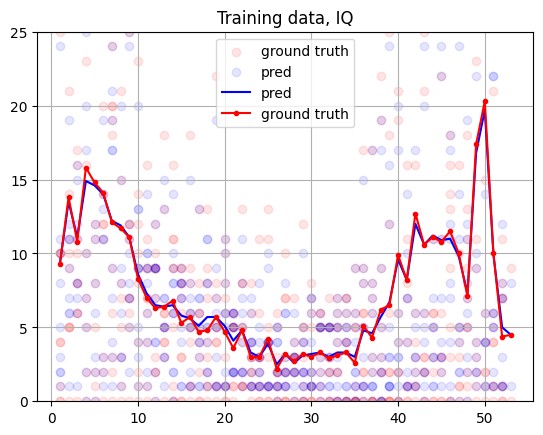

In [76]:
# Before week shifting
df_temp = iq_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='iq','weekofyear']
plt.scatter(df_temp['weekofyear'],df_temp['total_cases'],label='ground truth',alpha=0.1,c='red')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = iq_train_pred
plt.scatter(df_temp2['weekofyear'],df_temp2['total_cases'],label='pred',alpha=0.1,c='blue')

plt.plot(df_temp2.groupby('weekofyear').mean(),label='pred',c='blue')
plt.plot(df_temp.groupby('weekofyear').mean(),'.-',label='ground truth',c='red')

plt.legend()
plt.grid()
plt.ylim([0,25])
plt.title('Training data, IQ')

Text(0.5, 1.0, 'Training data, IQ')

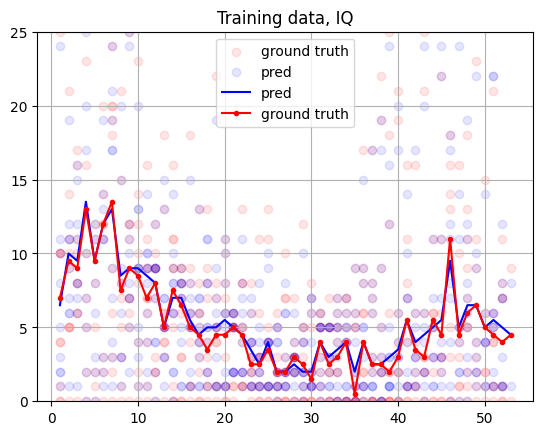

In [77]:
# Before week shifting
df_temp = iq_labels.copy()
df_temp['weekofyear'] = train_features_or.loc[train_features_or['city']=='iq','weekofyear']
plt.scatter(df_temp['weekofyear'],df_temp['total_cases'],label='ground truth',alpha=0.1,c='red')

df_temp2 = df_temp.copy()
df_temp2['total_cases'] = iq_train_pred
plt.scatter(df_temp2['weekofyear'],df_temp2['total_cases'],label='pred',alpha=0.1,c='blue')

plt.plot(df_temp2.groupby('weekofyear').median(),label='pred',c='blue')
plt.plot(df_temp.groupby('weekofyear').median(),'.-',label='ground truth',c='red')

plt.legend()
plt.grid()
plt.ylim([0,25])
plt.title('Training data, IQ')

#### param study

In [16]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
folds = 6
fold_size = 0.15
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]

grid_eta = [0.005,0.01,0.05,0.1]
grid_n_estimators = [100,250,500,1000]
grid_max_depth = [3,4,5,6,7]
grid_feature_lags = [None,(1,),(2,),(3,),(4,),(5,),]
grid_train_maes = []
grid_val_maes = []
grid_configs = []

for feature_lags in grid_feature_lags:
    for eta in grid_eta:
        for n_estimators in grid_n_estimators:
            for max_depth in grid_max_depth:
                if feature_lags is not None:
                    lagged_features = [col for col in feature_names if col !='weekofyear']
                else:
                    lagged_features = None

                # Preprocess to get lagged features/labels
                sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                            features_to_keep = feature_names,
                                                                            lagged_features = lagged_features,
                                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                                            label_lags=label_lags,circular_weekofyear=True)

                # Drop city column if training cities separately
                sj_features.drop(columns=['city_sj'],inplace=True)
                iq_features.drop(columns=['city_sj'],inplace=True)

                X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
                    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                                        sj_labels, iq_labels,
                                                                        folds=6, fold_size=0.15)

                # Reducing all lagged label weights to reduce their selection
                feature_weights = 100*np.ones(X_train_iq[0].shape[1])
                if label_lags is not None:
                    feature_weights[-len(label_lags):] = 100

                xg_reg_iq = []
                train_maes = []
                val_maes = []
                for fold in range(folds):
                    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
                    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                                    objective='reg:squarederror',
                                                    reg_alpha=1,reg_lambda=1))

                    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
                            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                            trainCV_metrics = 'mae', eval_metric = 'mae',
                            report_metric = metrics.mean_absolute_error, verbose=False,
                            feature_weights=feature_weights)
                    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                                            verbose=False,plot=False, MC=None, get_pred_train=True,
                                                            median_filter=3)
                    train_maes.append(train_mae_iq)
                    val_maes.append(val_mae_iq)

                grid_configs.append({'feature_lags':feature_lags,'eta':eta, 'n_estimators':n_estimators, 'max_depth':max_depth})
                grid_train_maes.append(train_maes)
                grid_val_maes.append(val_maes)


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

In [23]:
with open('iq_GS_res.pkl','wb') as f:
    pickle.dump((grid_configs,grid_train_maes,grid_val_maes),f)

In [63]:
# Prep dataframes for visualization
with open('iq_GS_res.pkl','rb') as f:
    grid_configs,grid_train_maes,grid_val_maes = pickle.load(f)


# Get main dataframes
arr_grid_train_maes = np.squeeze(np.array(grid_train_maes))
arr_grid_val_maes = np.squeeze(np.array(grid_val_maes))
df_config = pd.DataFrame(grid_configs)
df_train_mae = pd.DataFrame(arr_grid_train_maes)
df_val_mae = pd.DataFrame(arr_grid_val_maes)

# Add config information
df_train_mae = pd.concat([df_config,df_train_mae],axis=1)
df_val_mae = pd.concat([df_config,df_val_mae],axis=1)

# Gather
df_train_mae = pd.melt(df_train_mae,
        id_vars=['feature_lags', 'eta', 'n_estimators', 'max_depth'],
        value_vars=np.arange(6),
        var_name='fold', value_name = 'train_mae')
df_val_mae = pd.melt(df_val_mae,
        id_vars=['feature_lags', 'eta', 'n_estimators', 'max_depth'],
        value_vars=np.arange(6),
        var_name='fold', value_name = 'val_mae')

df_mae = df_train_mae.merge(df_val_mae,on=['feature_lags', 'eta', 'n_estimators', 'max_depth','fold'])
df_mae['feature_lags'] = df_mae['feature_lags'].map(str)
df_mae.sample(5)


,feature_lags,eta,n_estimators,max_depth,fold,train_mae,val_mae
192,"(2,)",0.01,500,5,0,2.918552,5.756410
1721,"(3,)",0.05,100,4,3,3.119910,7.102564
33,None,0.01,500,6,0,2.735294,12.448718
1569,"(1,)",0.05,250,7,3,1.916290,8.025641
514,None,0.01,500,7,1,2.721719,10.410256


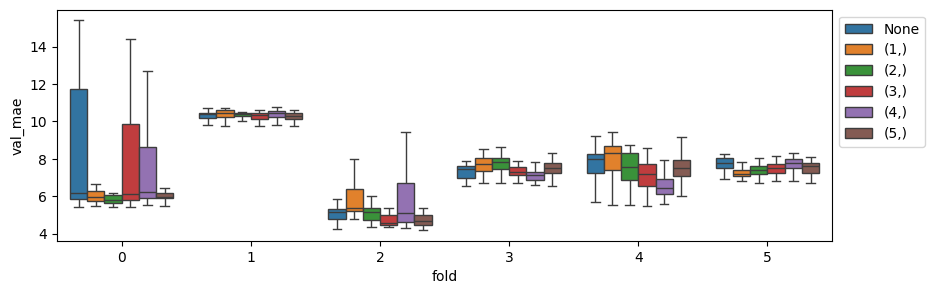

In [64]:
fig, ax = plt.subplots(1,1,figsize=(10,3))
sns.boxplot(df_mae,x='fold',y='val_mae',hue='feature_lags', ax=ax, showfliers=False)
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

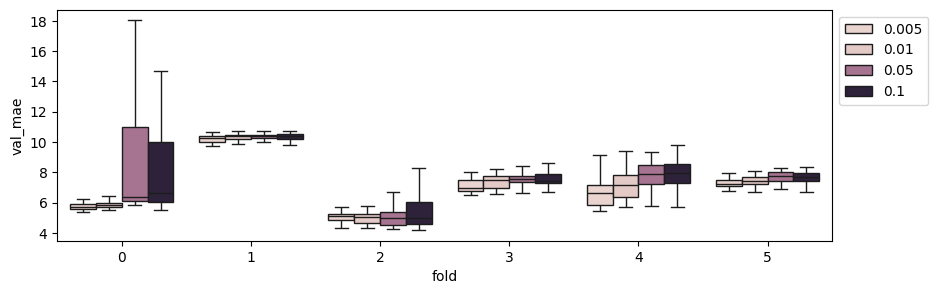

In [65]:
fig, ax = plt.subplots(1,1,figsize=(10,3))
sns.boxplot(df_mae,x='fold',y='val_mae',hue='eta', ax=ax, showfliers=False)
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

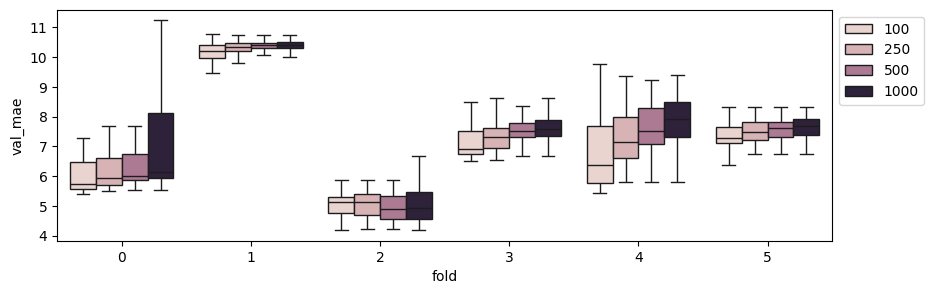

In [66]:
fig, ax = plt.subplots(1,1,figsize=(10,3))
sns.boxplot(df_mae,x='fold',y='val_mae',hue='n_estimators', ax=ax, showfliers=False)
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

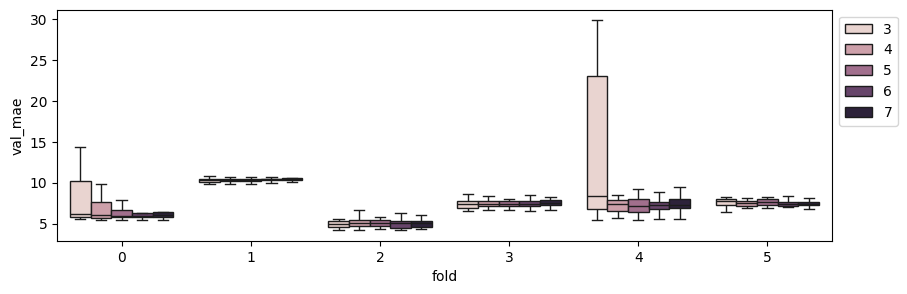

In [67]:
fig, ax = plt.subplots(1,1,figsize=(10,3))
sns.boxplot(df_mae,x='fold',y='val_mae',hue='max_depth', ax=ax, showfliers=False)
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

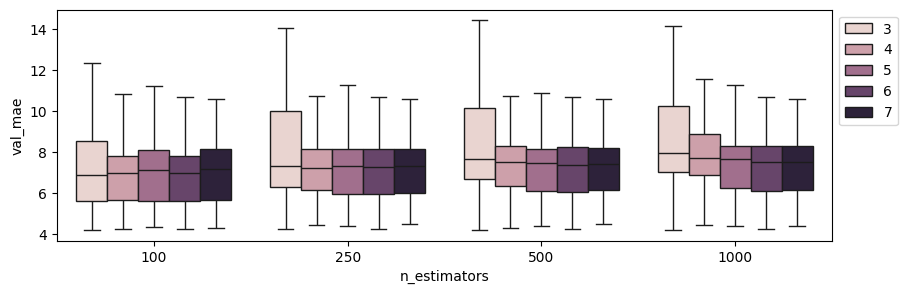

In [68]:
df_temp = df_mae.groupby(['feature_lags', 'eta', 'n_estimators', 'max_depth']).mean().drop(columns=['fold','train_mae'])

fig, ax = plt.subplots(1,1,figsize=(10,3))
sns.boxplot(df_mae,x='n_estimators',y='val_mae',hue='max_depth', ax=ax, showfliers=False)
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

## Submission

### Sub 33 - relative to sub31, improving on SJ, IQ untouched, weekofyear_shift=10, feature lags for ndvi at 1,2,3, the rest at 3

__NOTE__: Accidentally kept feature smoothing in here. not sure if it helped


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

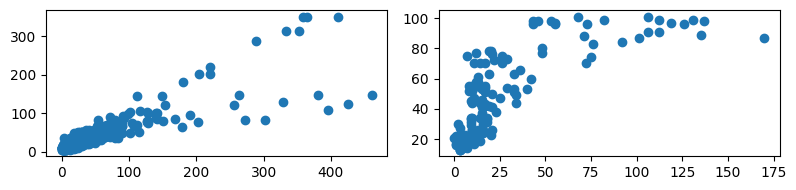

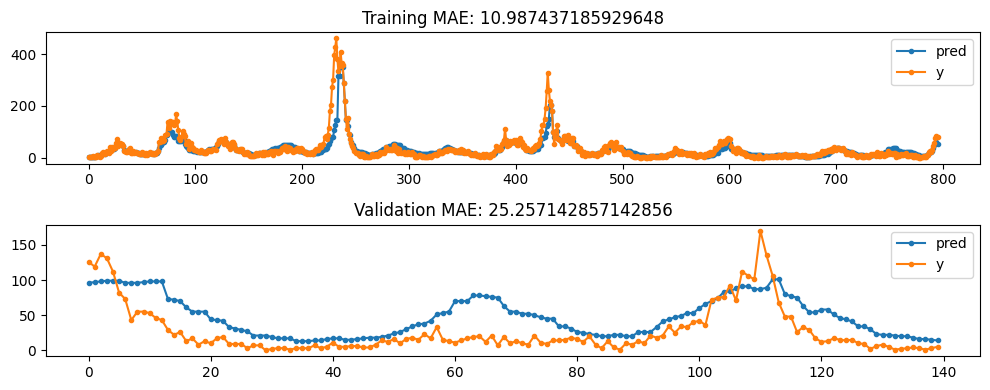

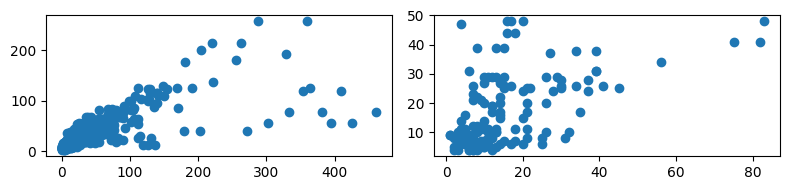

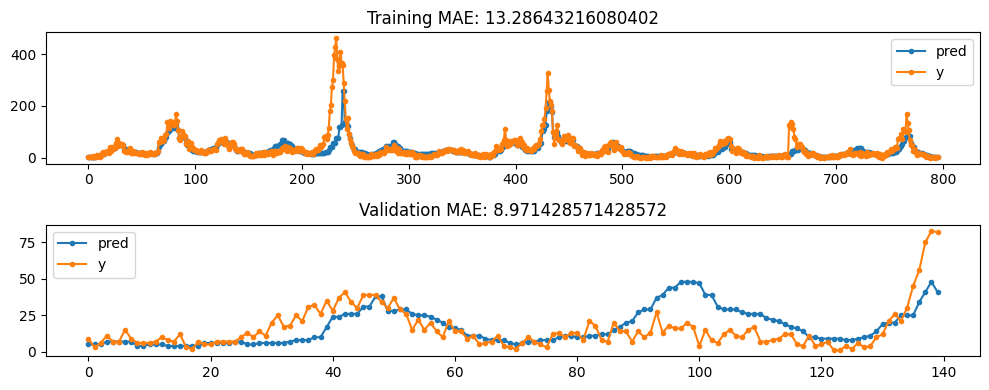

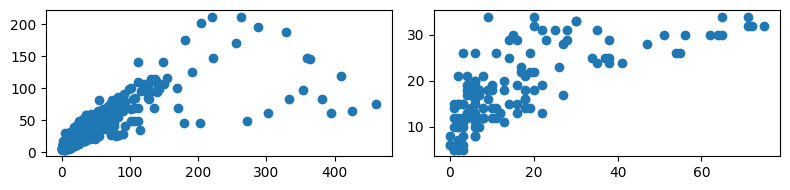

...

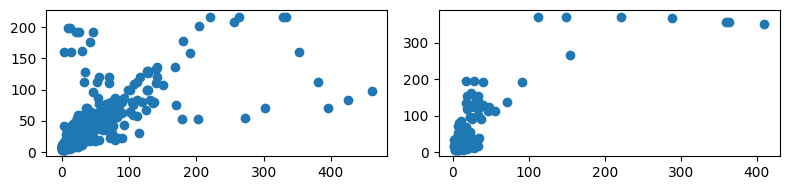

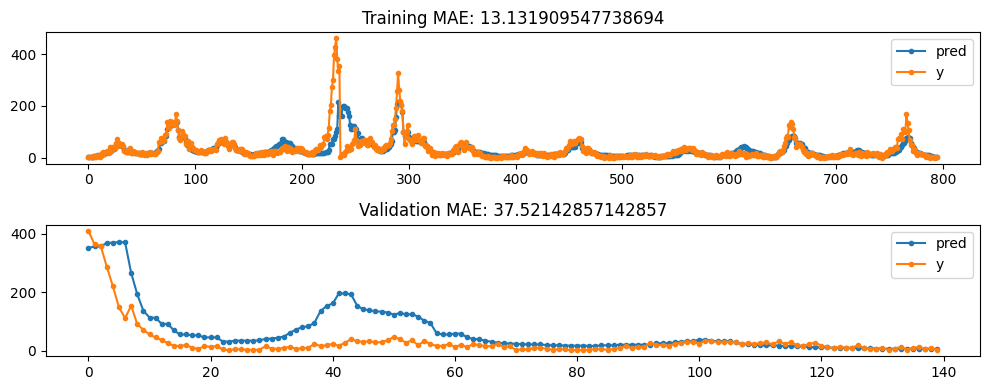

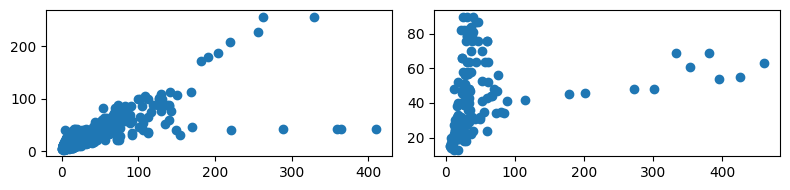

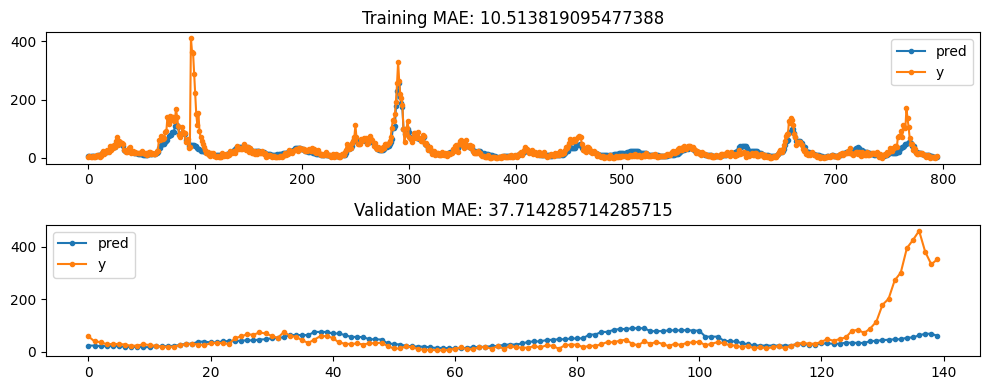

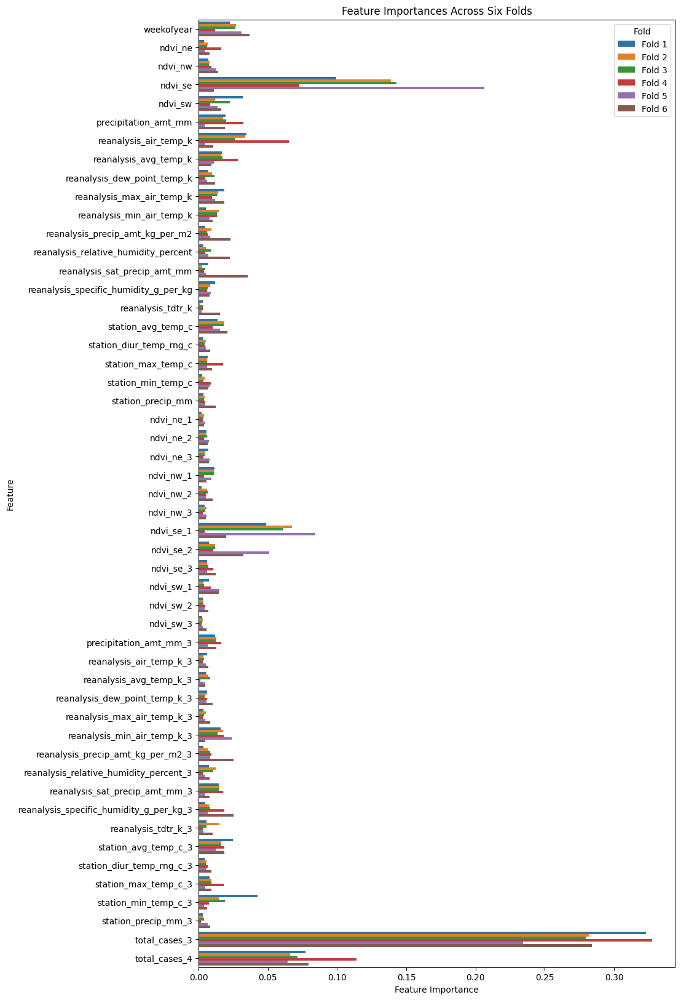

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


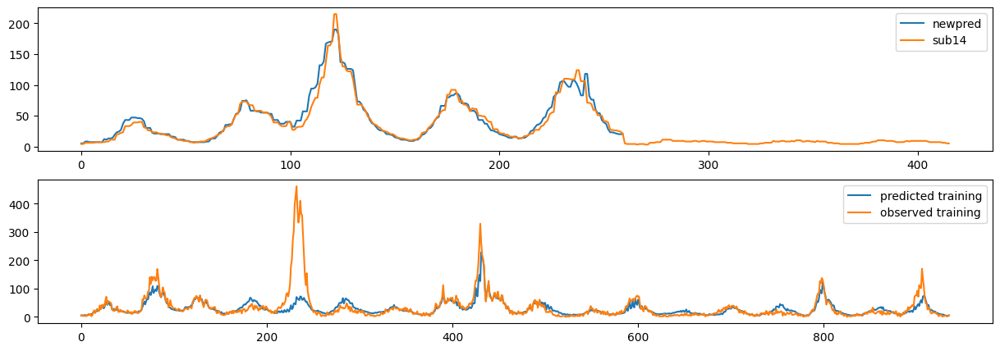

In [52]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=True,
                                                            weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True,
                                  weekofyear_shift=10)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

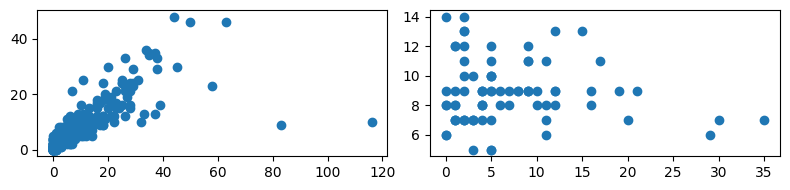

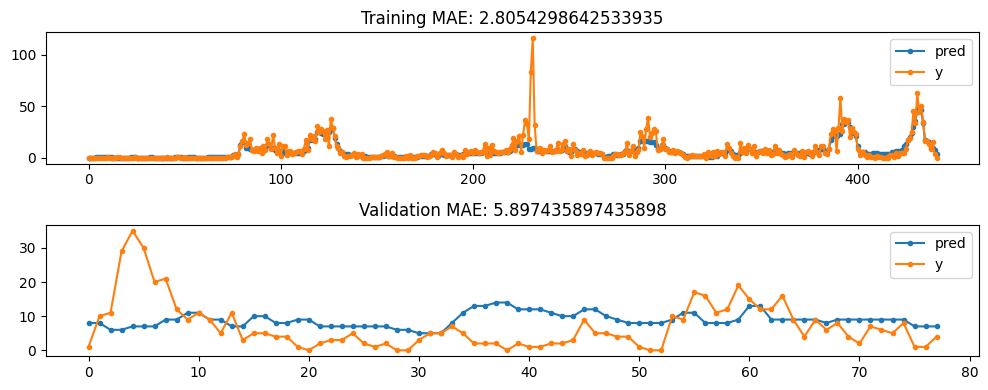

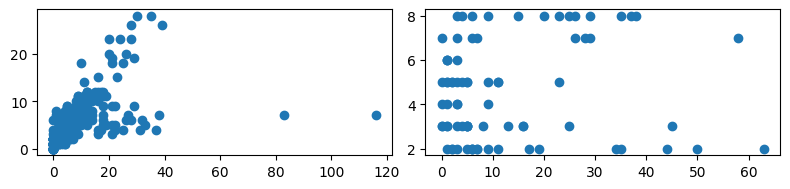

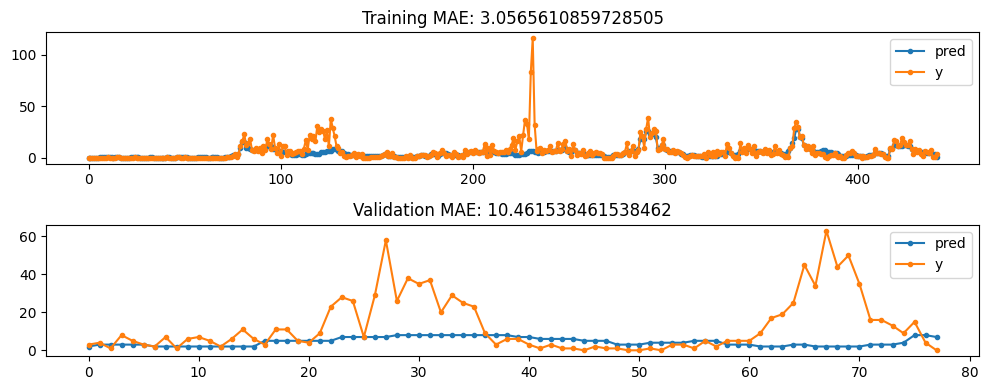

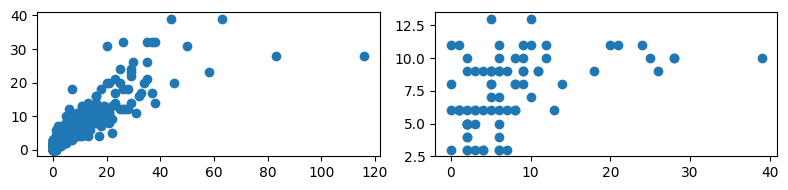

...

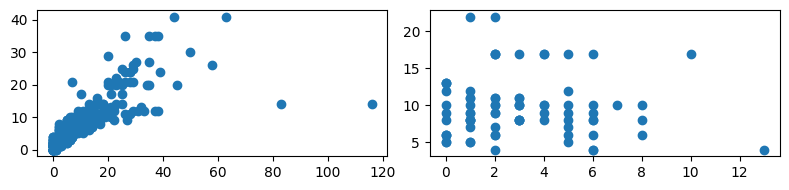

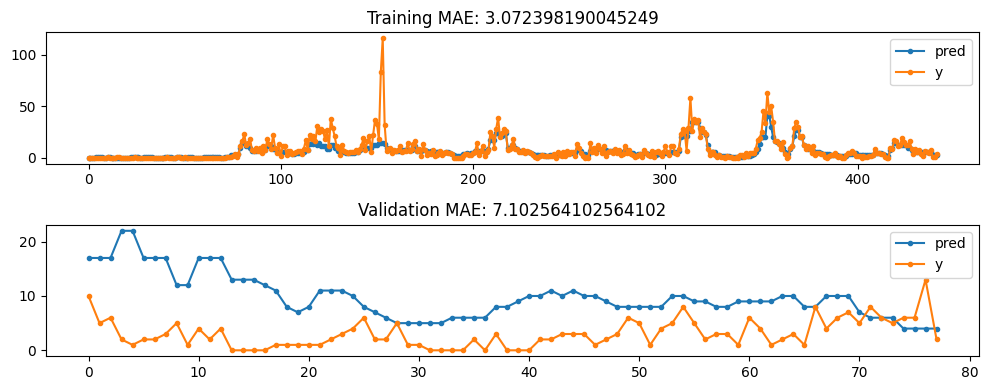

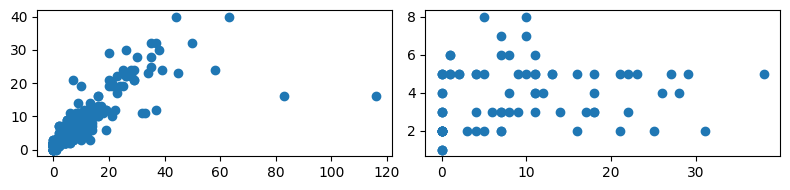

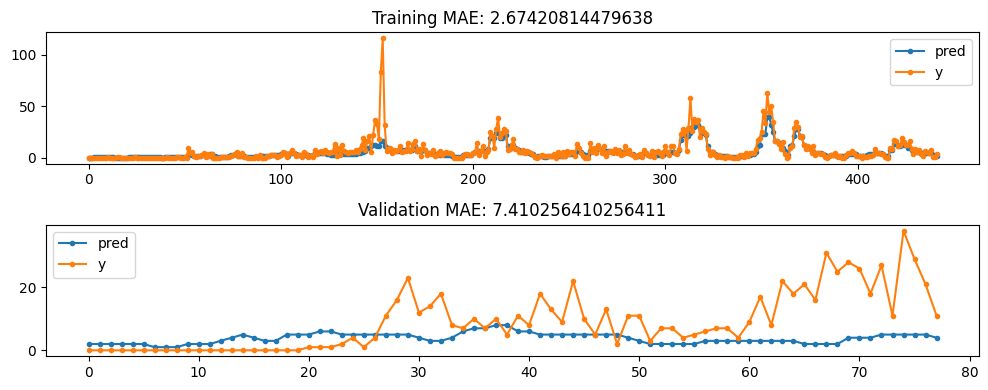

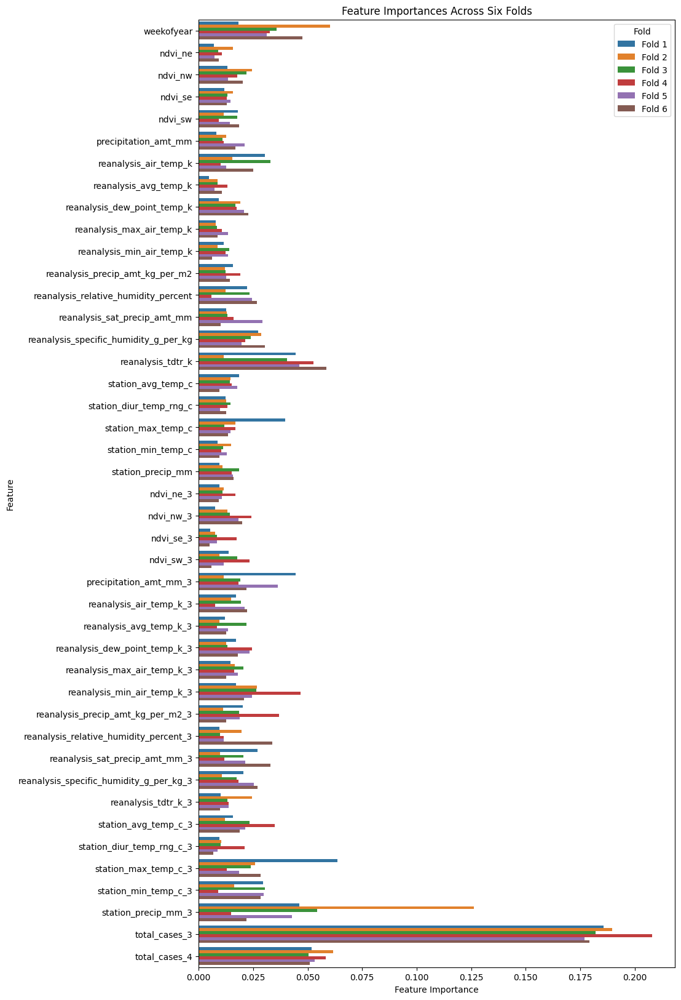

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


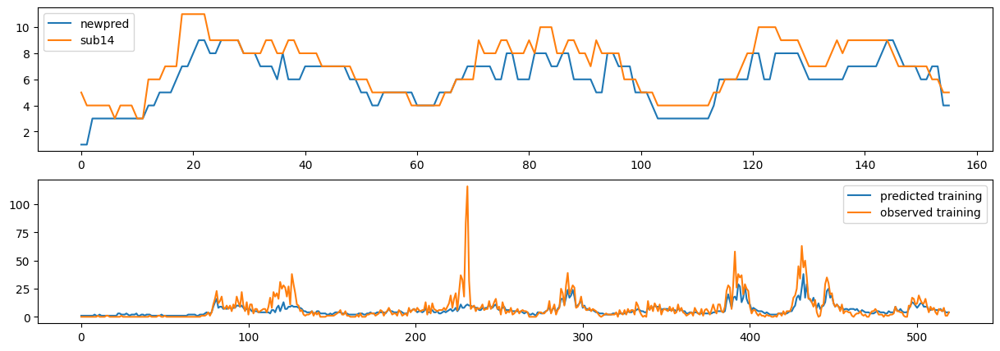

In [53]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case[best_case['city']=='iq']['total_cases'].reset_index(drop=True),label='sub14')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

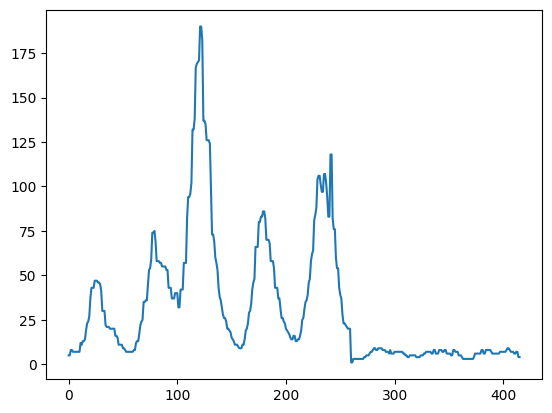

In [54]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_33.csv")

### Sub 34 - relative to sub33, improving on IQ, SJ untouched, trying poisson here

__NOTE__: Accidentally kept feature smoothing in here. not sure if it helped

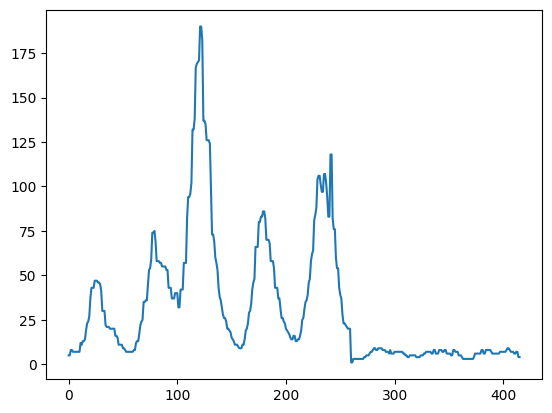

In [57]:
best_case_sub33 = pd.read_csv('submission_33.csv')
plt.plot(best_case_sub33['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

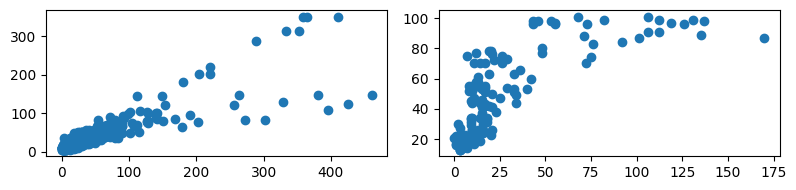

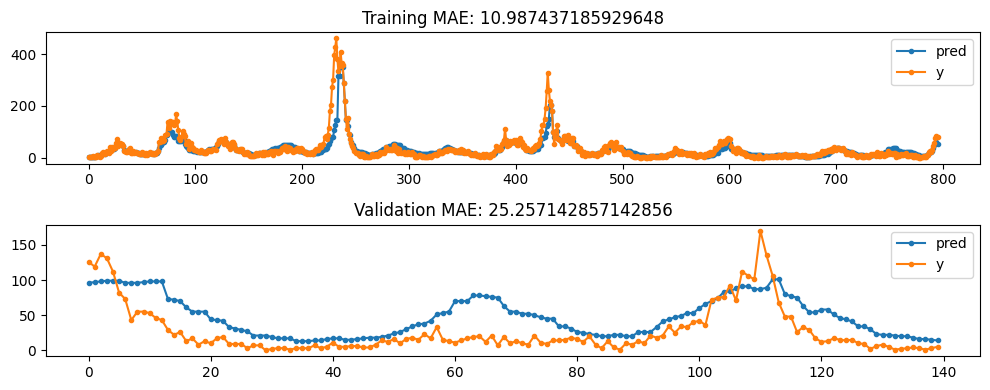

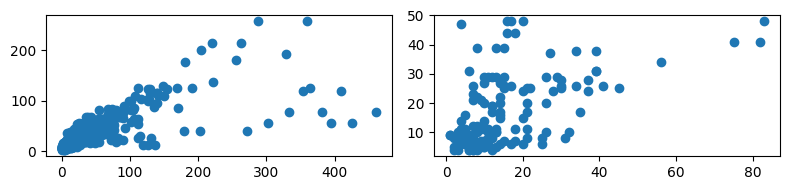

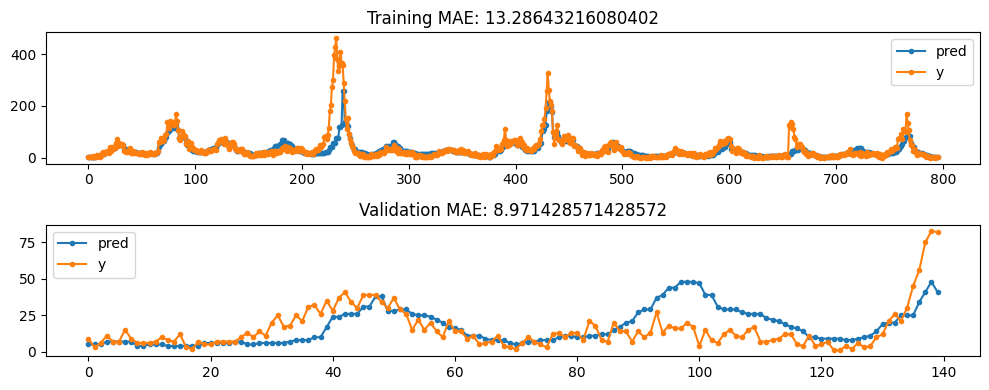

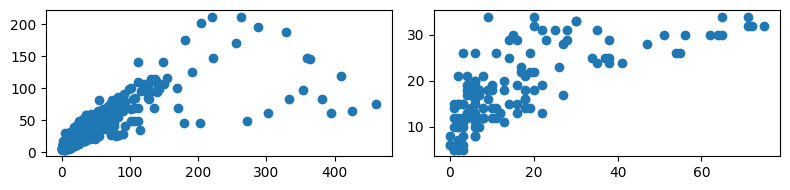

...

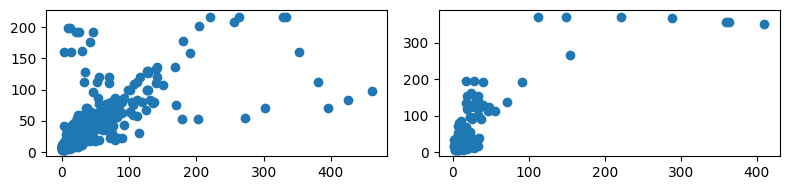

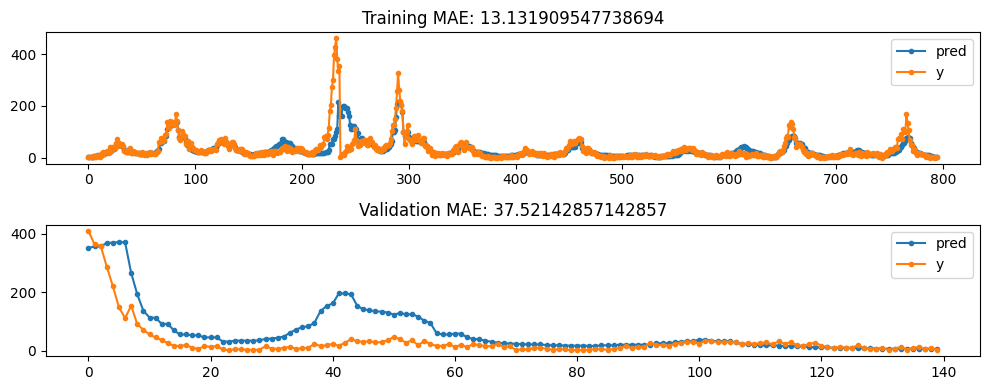

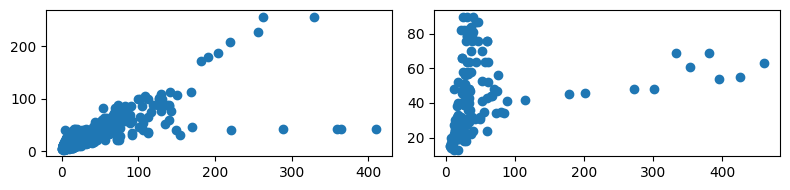

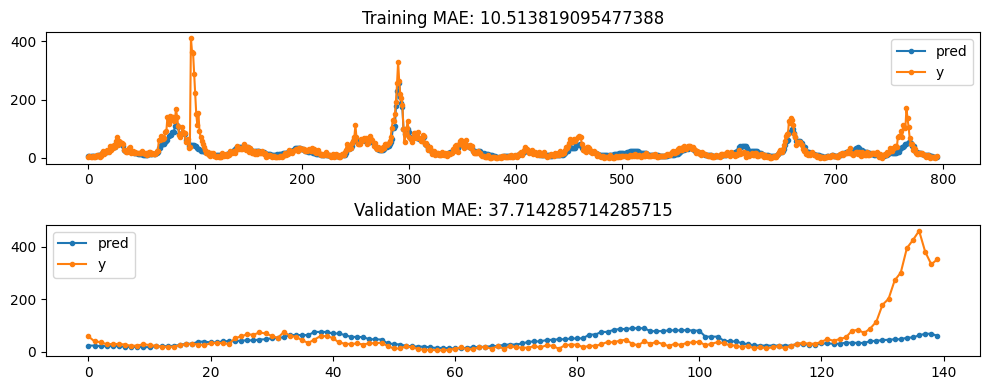

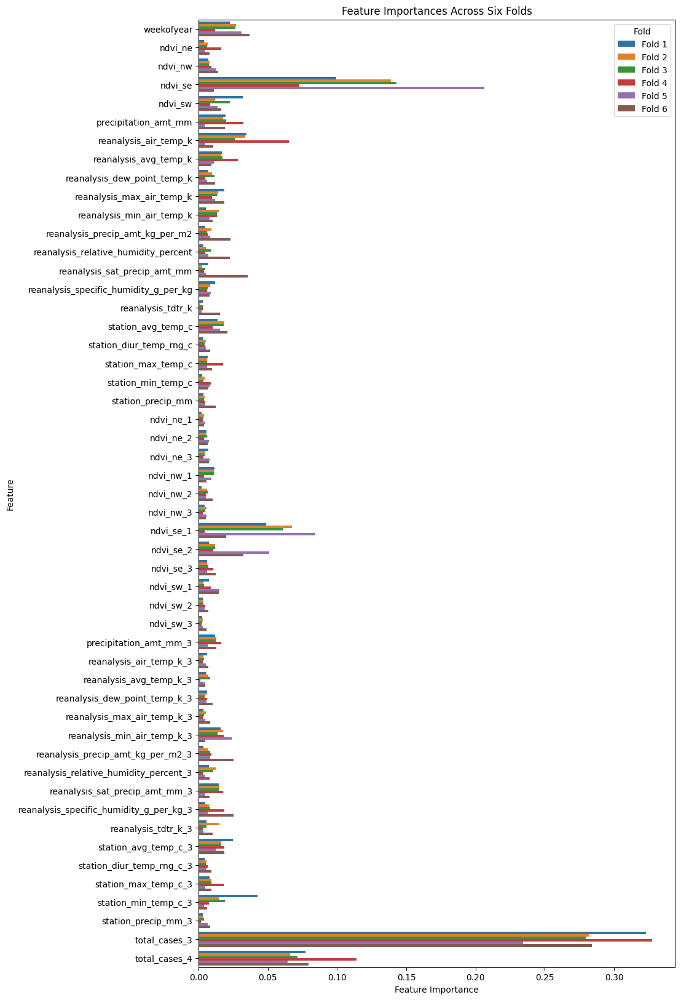

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


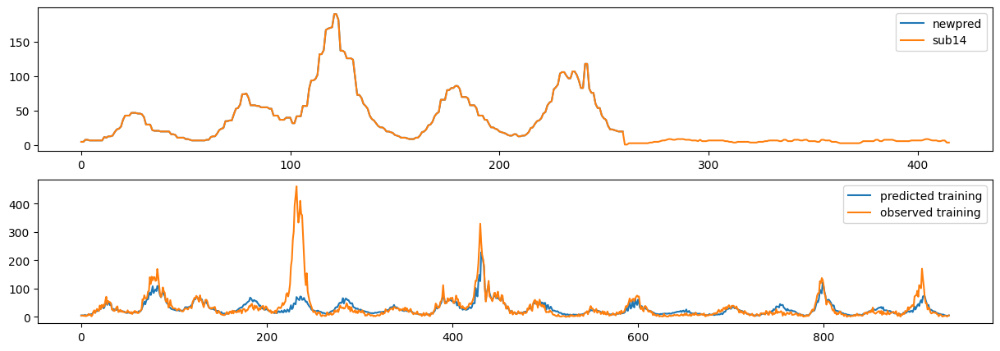

In [58]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=True,
                                                            weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True,
                                  weekofyear_shift=10)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub33['total_cases'],label='sub33')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

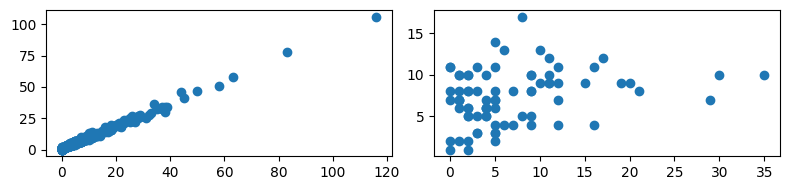

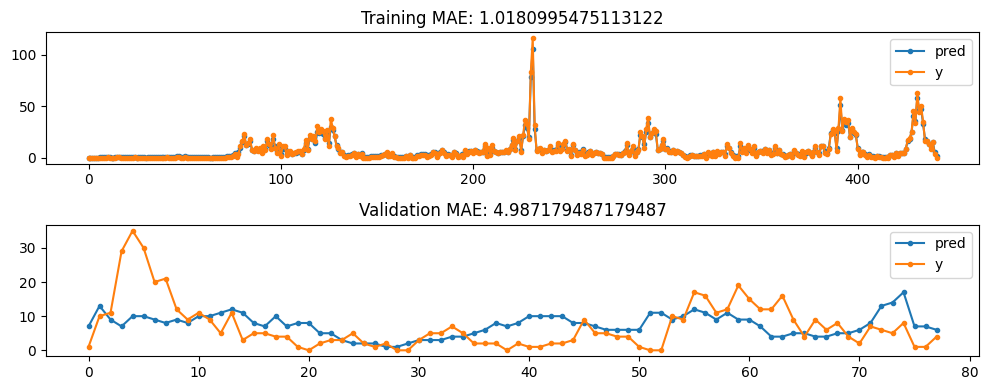

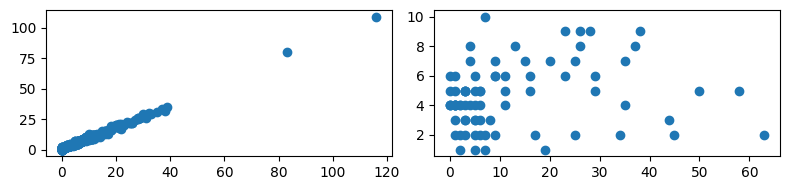

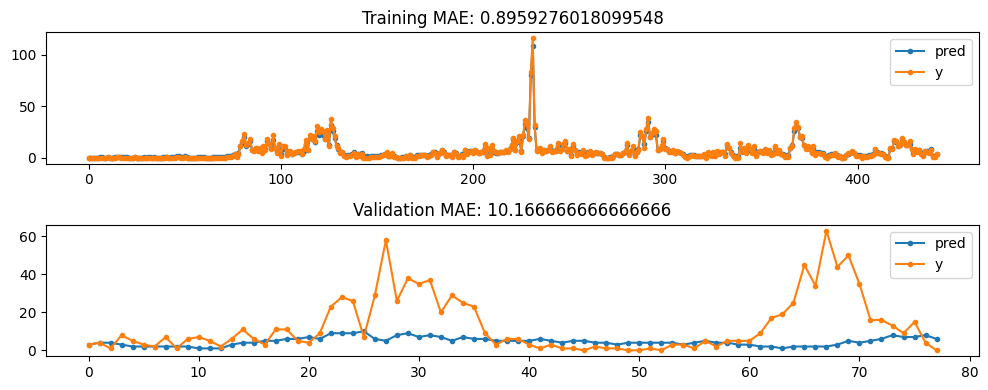

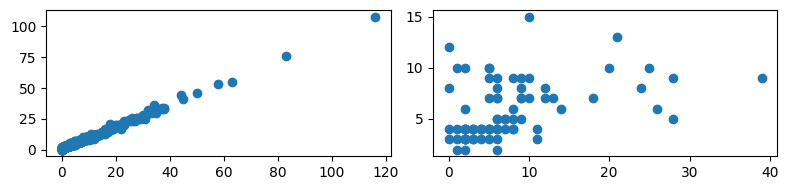

...

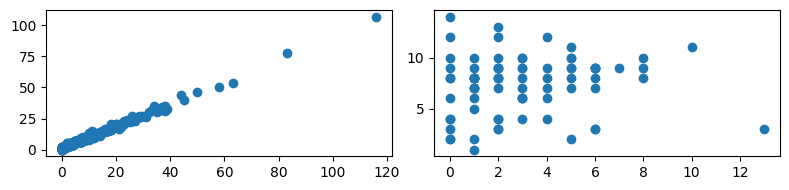

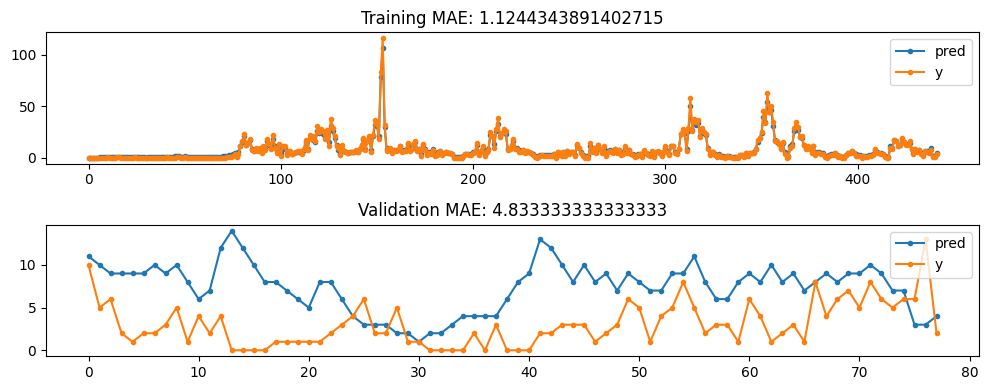

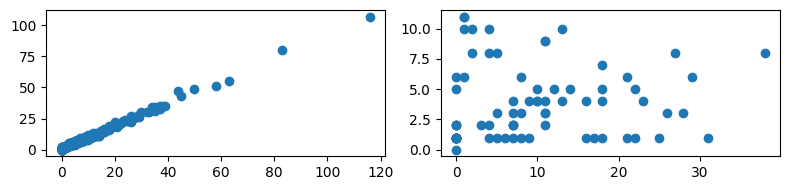

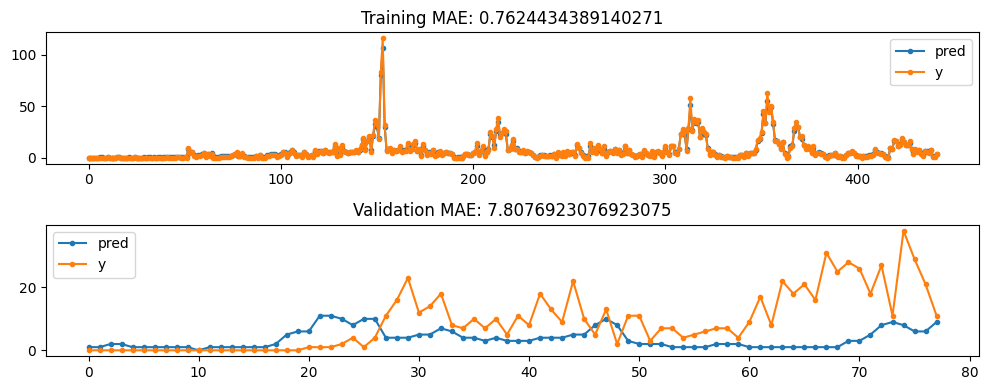

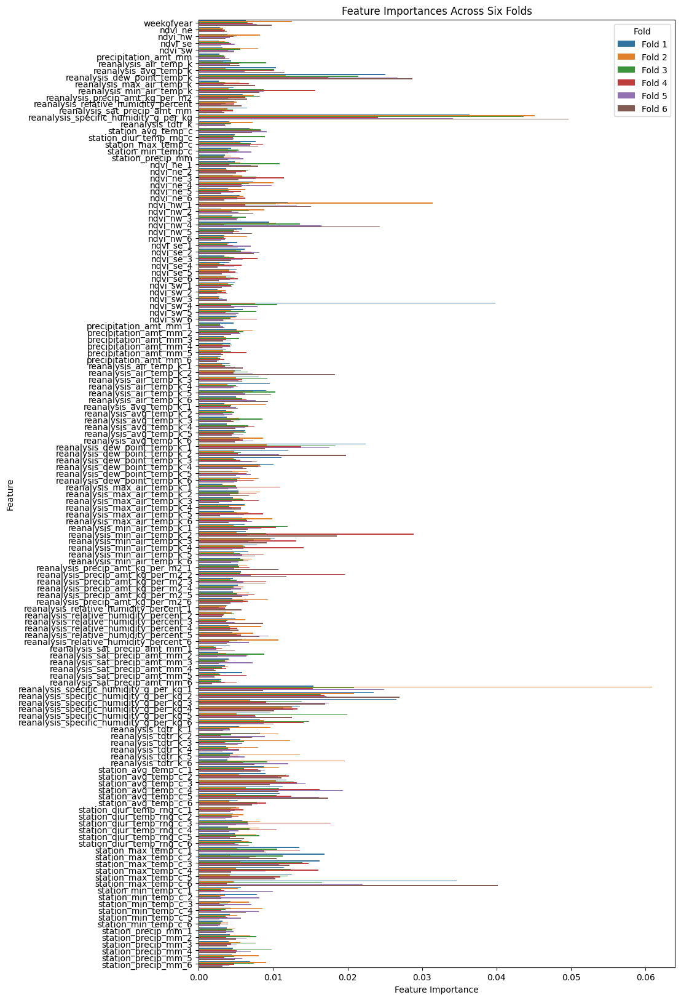

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


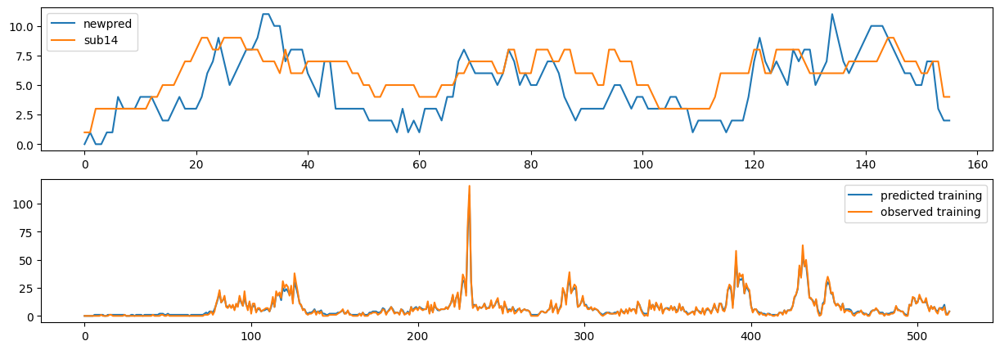

In [62]:
# Close to original best scoring
# Specify modelling parameters
# label_lags=(1,2,3)
label_lags=None
feature_lags = (1,2,3,4,5,6)
# feature_lags = None
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
# lagged_features = None

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features, smooth_feat = 3,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=2)

# # Dropping of week features
# sj_features.drop(columns=lagged_features, inplace=True)
# iq_features.drop(columns=lagged_features, inplace=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=1500,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=None)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features, smooth_feat = 3,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=2)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
# iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case_sub34[best_case_sub34['city']=='iq']['total_cases'].reset_index(drop=True),label='sub34')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

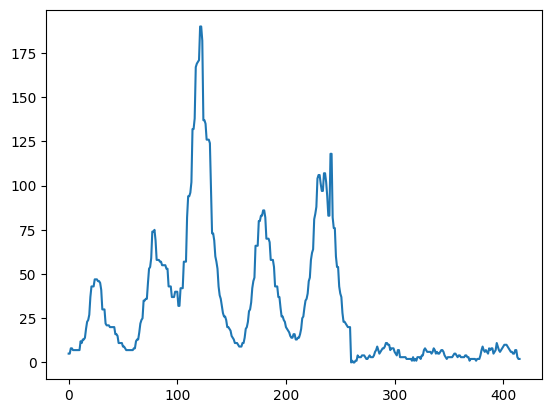

In [60]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_34.csv")

### Sub 35 - relative to 34, further improving on IQ by using weekofyear_shift=10 too, SJ remains untouched.

__NOTE__: Accidentally kept feature smoothing in here. not sure if it helped

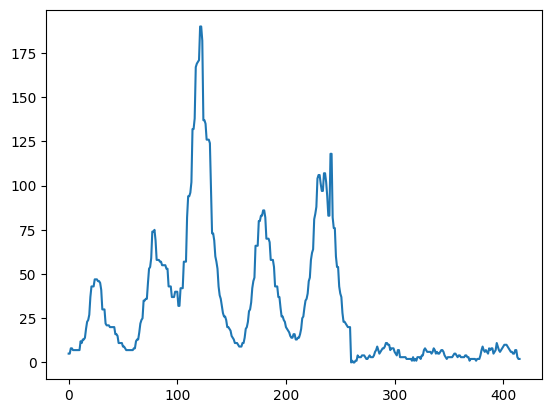

In [11]:
best_case_sub34 = pd.read_csv('submission_34.csv')
plt.plot(best_case_sub34['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

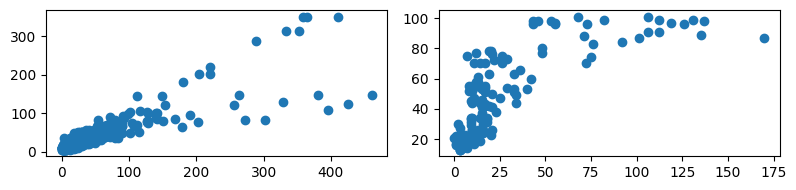

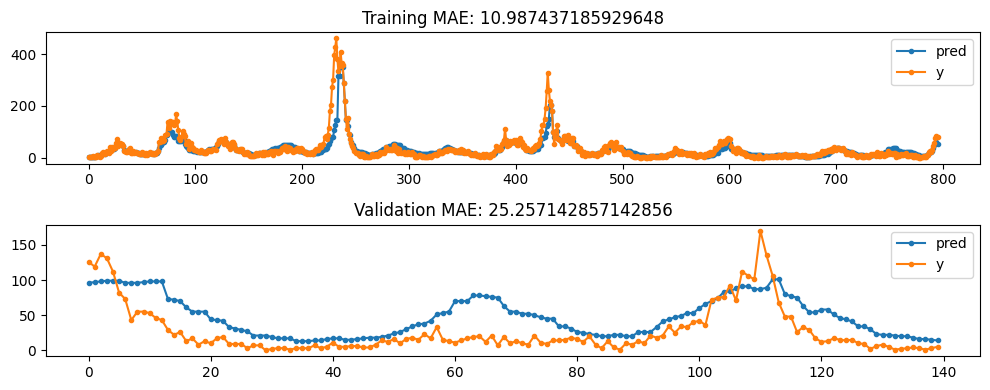

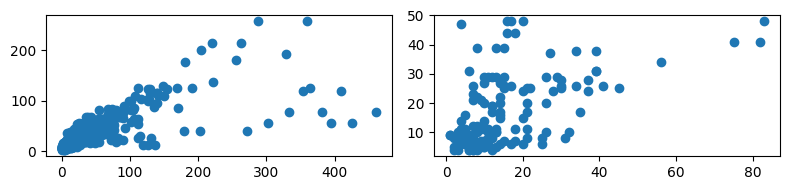

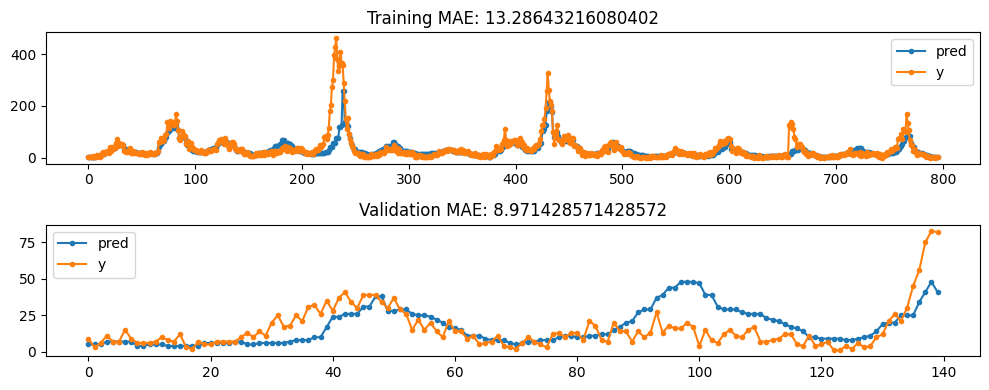

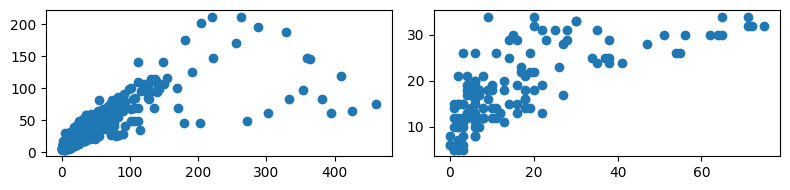

...

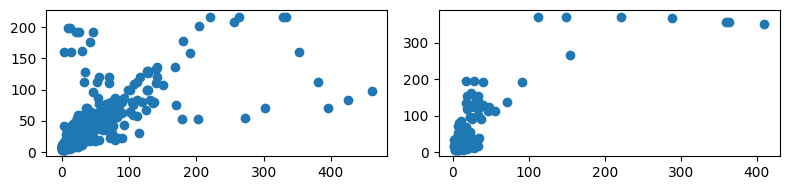

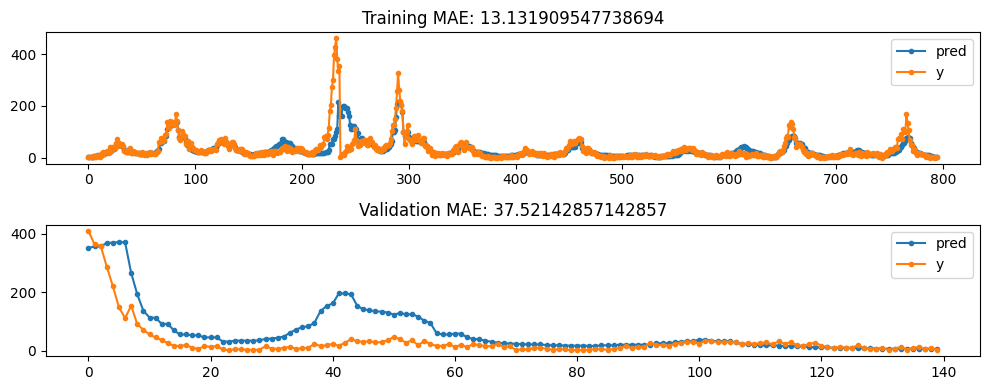

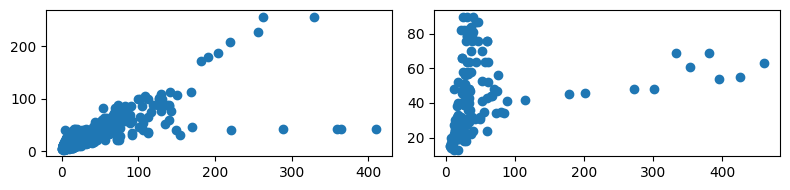

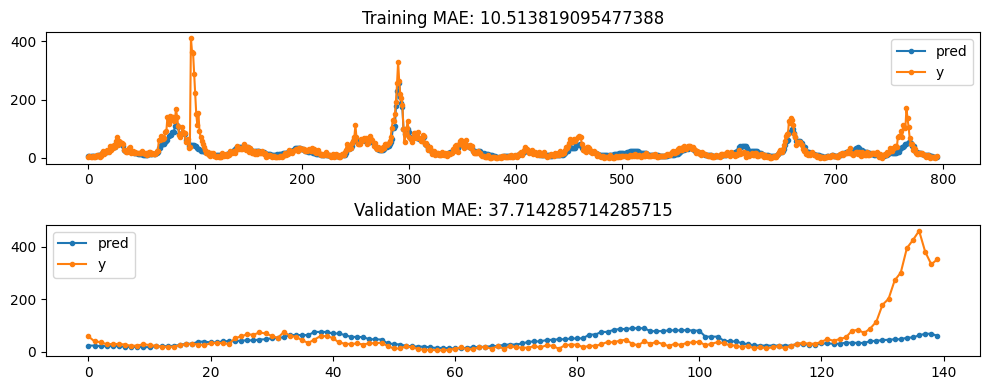

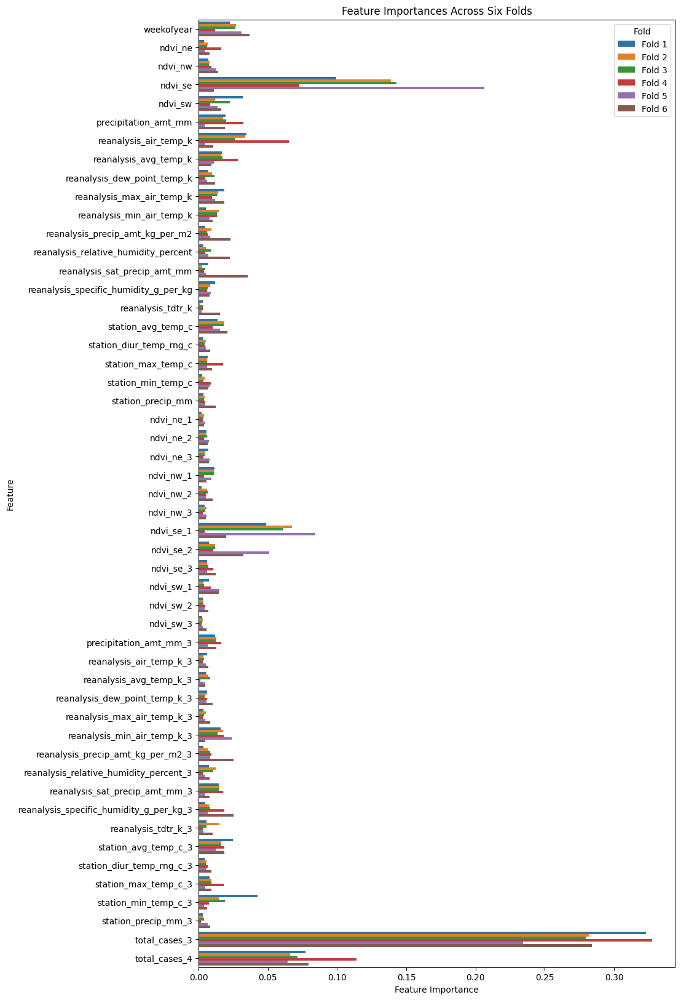

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


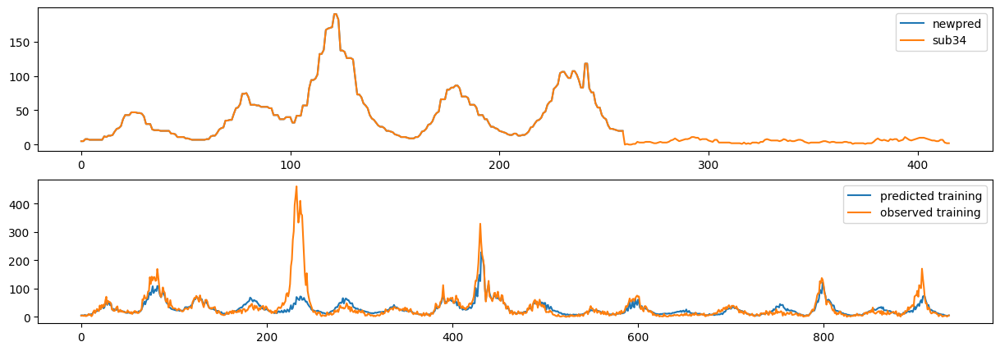

In [12]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=True,
                                                            weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True,
                                  weekofyear_shift=10)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub34['total_cases'],label='sub34')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

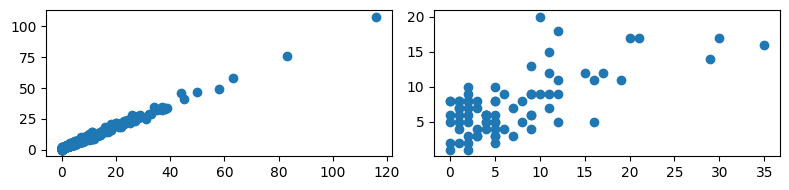

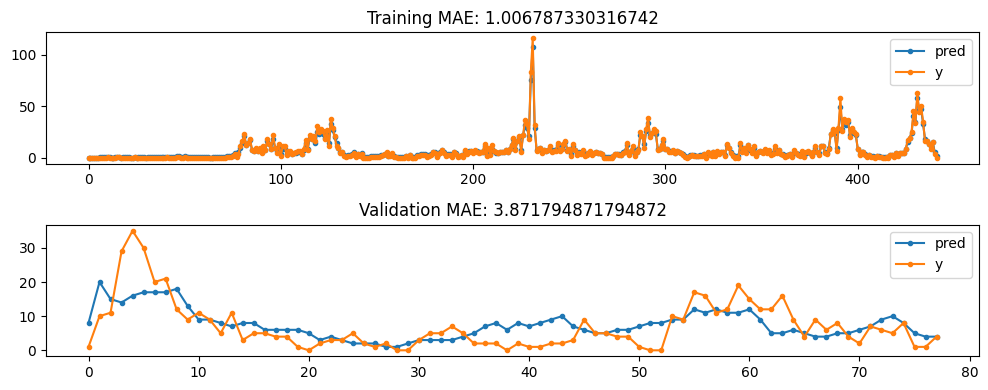

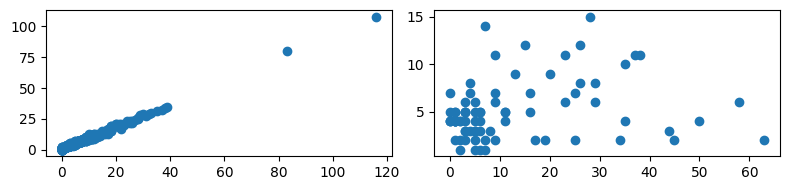

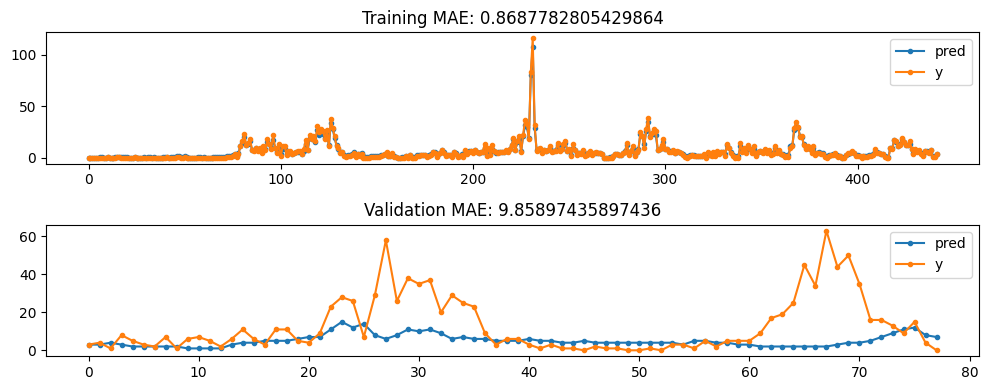

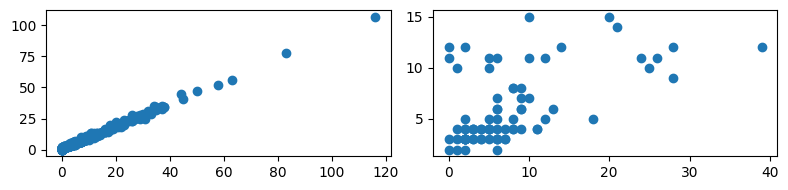

...

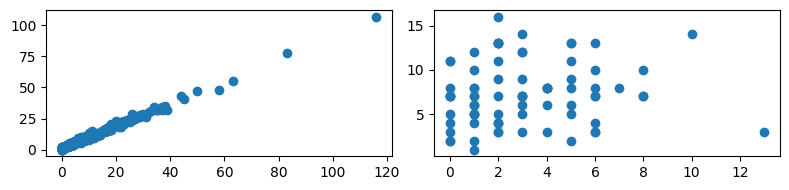

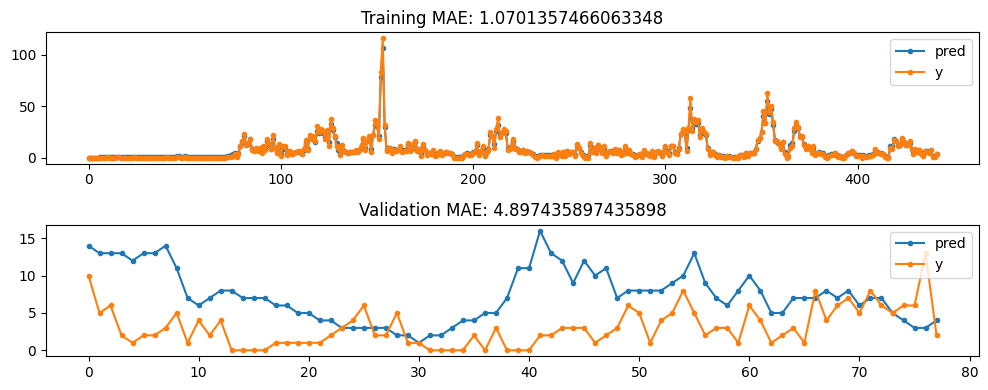

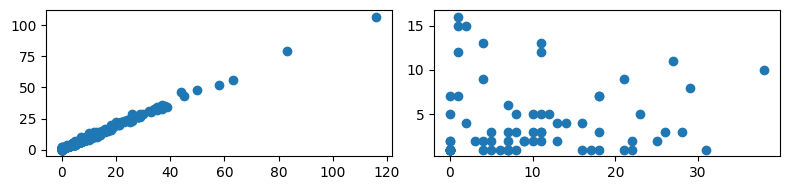

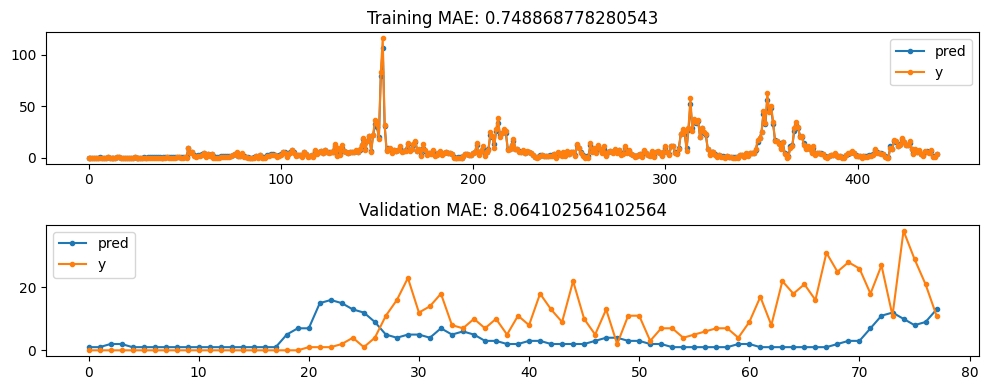

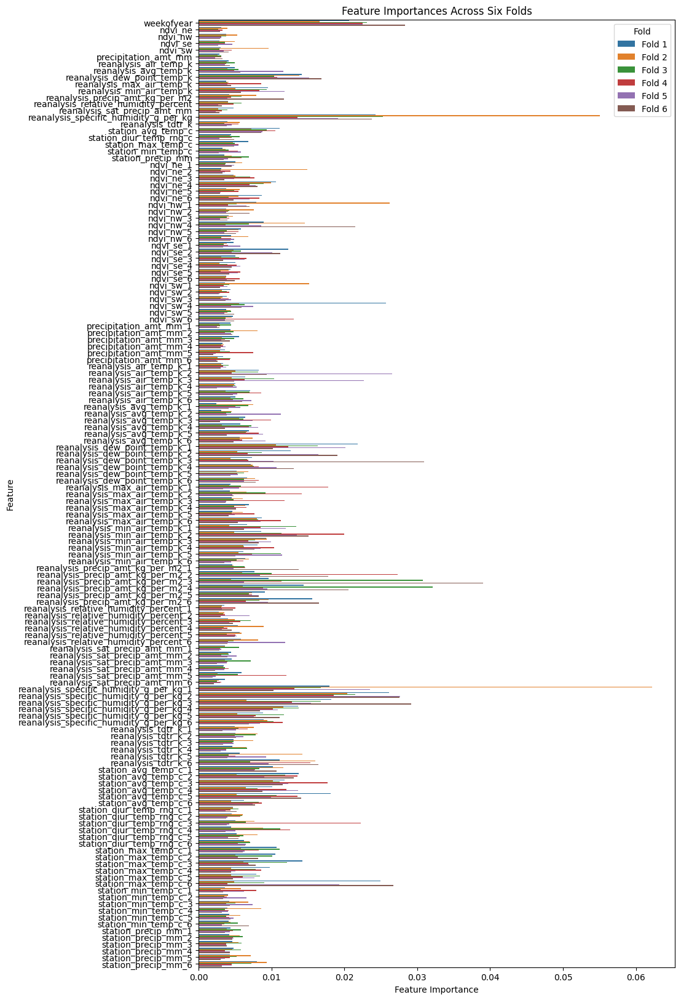

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


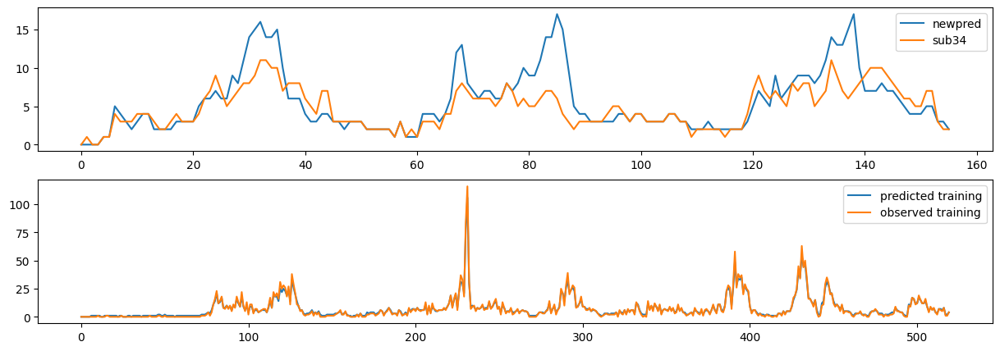

In [13]:
# Close to original best scoring
# Specify modelling parameters
# label_lags=(1,2,3)
label_lags=None
feature_lags = (1,2,3,4,5,6)
# feature_lags = None
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
# lagged_features = None

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True,
                                                            weekofyear_shift=10)

# # Dropping of week features
# sj_features.drop(columns=lagged_features, inplace=True)
# iq_features.drop(columns=lagged_features, inplace=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=None)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True,
                                  weekofyear_shift=10)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
# iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case_sub34[best_case_sub34['city']=='iq']['total_cases'].reset_index(drop=True),label='sub34')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

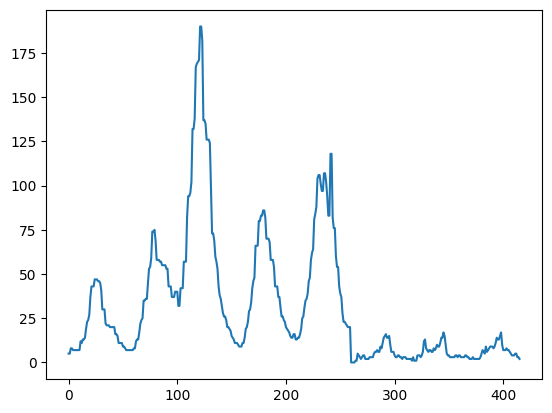

In [14]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_35.csv")

### Sub 36 - using sub34 IQ values. relative to sub34, SJ using target encoding and artificially raised second half of year values.

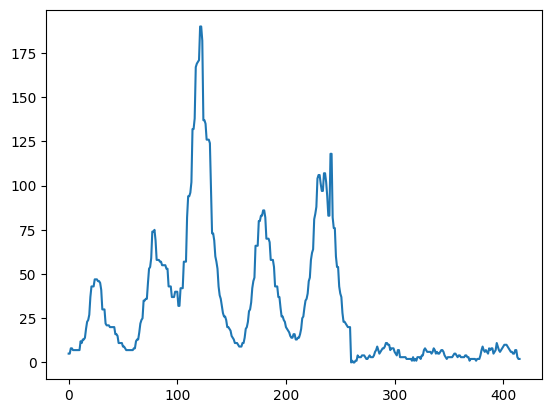

In [6]:
best_case_sub34 = pd.read_csv('submission_34.csv')
plt.plot(best_case_sub34['total_cases'])

In [7]:
def eval_and_plot(model,X_train_all,y_train_all,X_val_all,y_val_all,
                  train_woy_all, val_woy_all,
                  label_lags=None,
                  plot=True,verbose=True, MC=None,get_pred_train=True,
                  two_cities=False, median_filter: Optional[int]=None):
    '''
    Evaluate by predicting validation set and optionally plotting
    X_train: Dataframe of train features. Iterable of two dataframes if two_cities is True
    y_train: Dataframe of train labels. Iterable of two dataframes if two_cities is True
    X_val: Dataframe of val features. Iterable of two dataframes if two_cities is True
    y_val: Dataframe of val labels. Iterable of two dataframes if two_cities is True
    get_pred_train: True to calculate using previously predicted labels as lagged labels
    two_cities: Training model on both cities, requires splitting.
    median_filter: Apply median filtering to results.
    '''

    # If both cities trained together, input should be iterable of two datasets
    if two_cities:
        assert len(X_train_all)==2
        assert len(y_train_all)==2
        assert len(X_val_all)==2
        assert len(y_val_all)==2
        assert len(train_woy_all)==2
        assert len(val_woy_all)==2
    else:
        X_train_all = [X_train_all]
        y_train_all = [y_train_all]
        X_val_all = [X_val_all]
        y_val_all = [y_val_all]
        train_woy_all = [train_woy_all]
        val_woy_all = [val_woy_all]
        
    # Collect values separately for each city
    pred_train_all = []
    pred_val_all = []
    train_mae_all = []
    val_mae_all = []

    for X_train, y_train, X_val, y_val,train_woy,val_woy in zip(X_train_all, y_train_all, X_val_all, y_val_all,train_woy_all,val_woy_all):
        # Get predicted train values
        if get_pred_train:
            pred_train = get_predictions(model, X_train, label_lags, MC=MC)
        else:
            pred_train = model.predict(X_train)

        if median_filter is not None:
            pred_train = medfilt(pred_train,median_filter)

        # Artificially raising later half year values
        pred_train[(train_woy>30) & (train_woy<50)] *= 1.3
                
        pred_train = np.round(pred_train)
        pred_train = np.clip(pred_train, 0, 10000000)
        
        train_mae = mean_absolute_error(y_train, pred_train)
        if verbose:
            print("Train MAE:", train_mae)

        # Get prediction validation values
        pred_val = get_predictions(model, X_val, label_lags, MC=MC)
        
        # Artificially raising later half year values
        pred_val[(val_woy>30) & (val_woy<50)] *= 1.3

        if median_filter is not None:
            pred_val = medfilt(pred_val,median_filter)

        if MC is None:
            val_mae = mean_absolute_error(y_val, pred_val)
        else:
            val_mae = mean_absolute_error(y_val, np.mean(pred_val,axis=1))
        if verbose:
            print("Val MAE:", val_mae)
        
        pred_train_all.append(pred_train)
        pred_val_all.append(pred_val)
        train_mae_all.append(train_mae)
        val_mae_all.append(val_mae)
        
    if plot:
        for pred_train, pred_val, y_train, y_val, train_mae, val_mae in zip(pred_train_all, pred_val_all,y_train_all, y_val_all, train_mae_all, val_mae_all):
            fig, axs = plt.subplots(1,2,figsize=(8,2))
            fig2, axs2 = plt.subplots(2,1,figsize=(10,4))
            axs[0].scatter(y_train, pred_train)
            pred_train = pd.Series(pred_train, index=y_train.index)
            axs2[0].plot(np.arange(len(pred_train)), pred_train.sort_index(),marker='.',label='pred');
            axs2[0].plot(np.arange(len(y_train)), y_train.sort_index(),marker='.',label='y');
            axs2[0].legend();
            axs2[0].set_title(f'Training MAE: {train_mae}')


            if MC is None:
                axs[1].scatter(y_val, pred_val)
                pred_val = pd.Series(pred_val, index=y_val.index)
                axs2[1].plot(np.arange(len(pred_val)), pred_val.sort_index(),marker='.',label='pred');
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),marker='.',label='y');
                axs2[1].legend();
                axs2[1].set_title(f'Validation MAE: {val_mae}')
            else:
                axs[1].scatter(y_val, np.mean(pred_val,axis=1))
                            
                for l in range(MC):
                    axs2[1].plot(np.arange(pred_val.shape[0]), pred_val[:,l],alpha=0.2,color='grey');
                axs2[1].plot(np.arange(pred_val.shape[0]), np.mean(pred_val,axis=1),color='red');                
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),color='k',marker='.');
            fig.tight_layout()
            fig2.tight_layout()
            
        if not two_cities: # Unpacking directly if individually trained
            pred_train_all, pred_val_all, train_mae_all, val_mae_all = pred_train_all[0], pred_val_all[0], train_mae_all[0], val_mae_all[0]

    return pred_train_all, pred_val_all, train_mae_all, val_mae_all


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

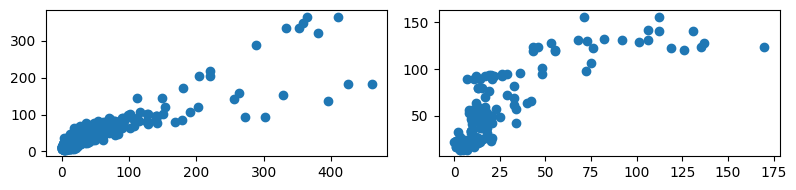

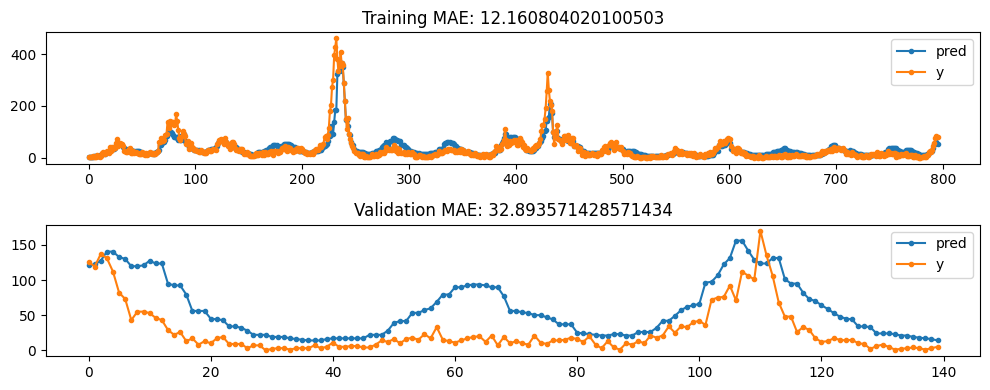

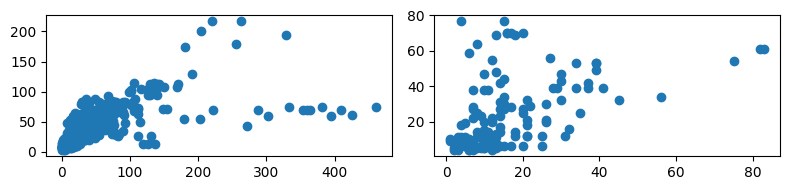

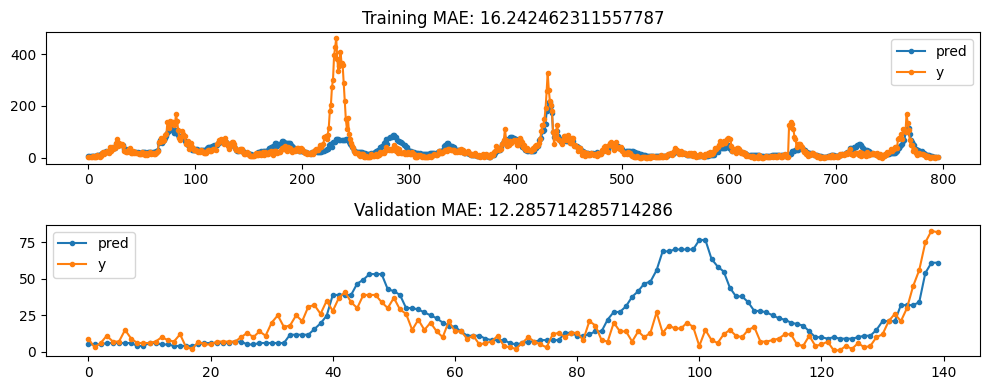

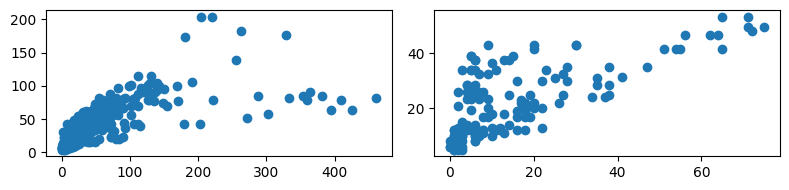

...

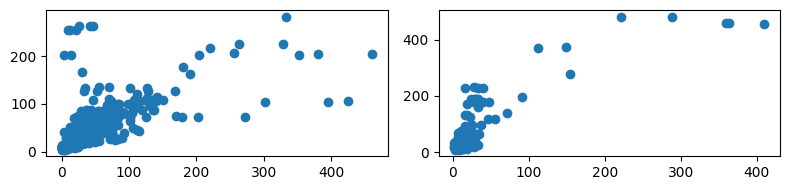

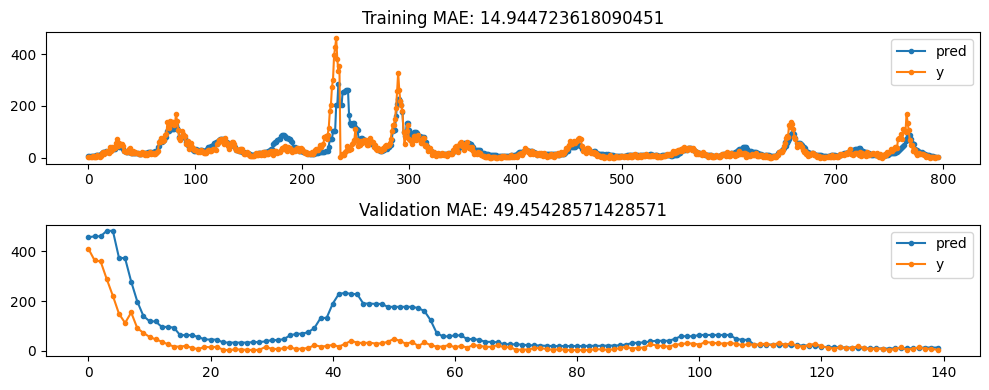

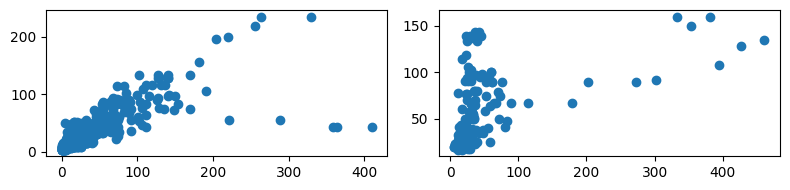

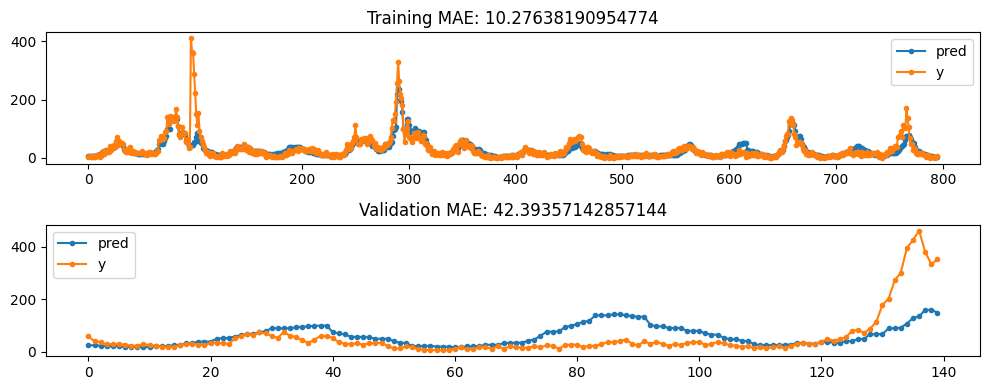

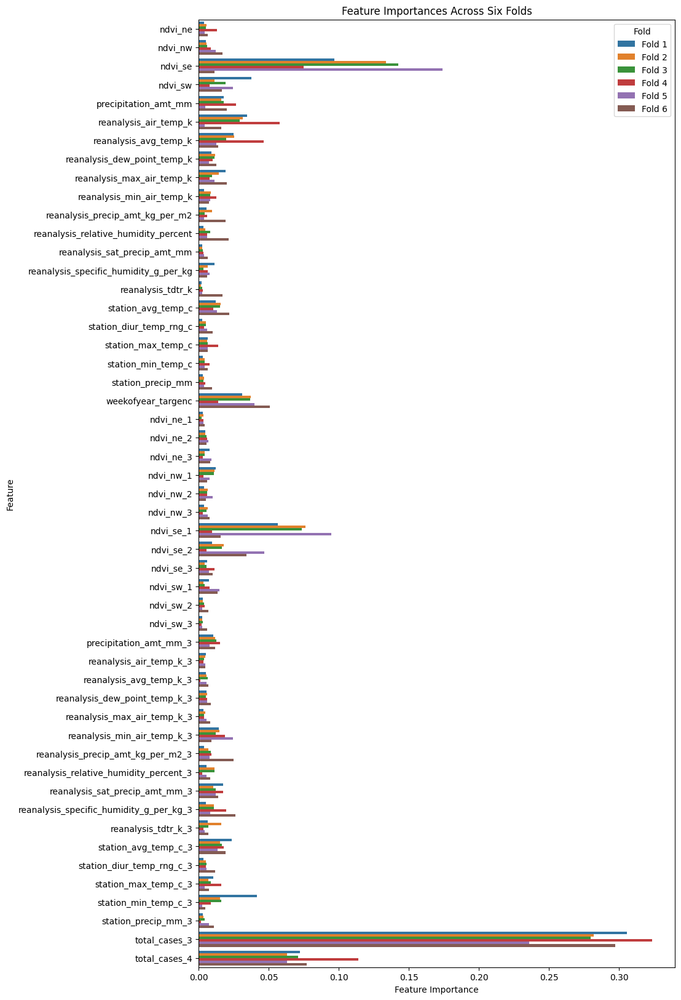

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


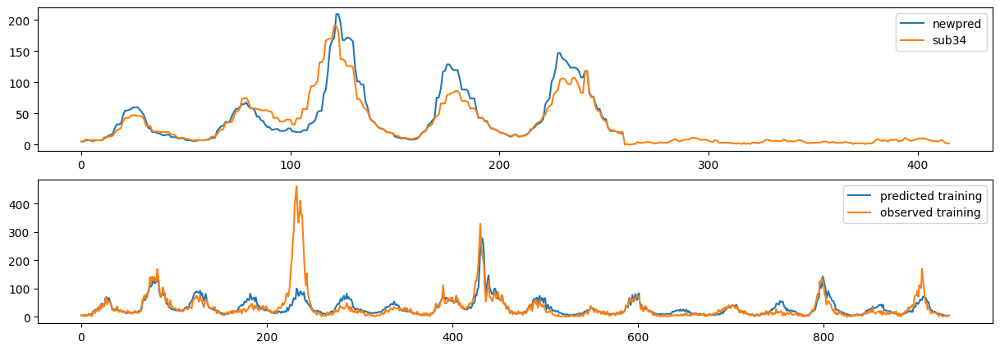

In [8]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

########################################################
# Getting matching weekofyear values
sj_features, iq_features,\
    sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                    features_to_keep = feature_names,
                                                    lagged_features = lagged_features,
                                                    fillna = 'ffill', smooth_feat = 3,
                                                    feature_lags=None, label_lags=label_lags,
                                                    circular_weekofyear=None,
                                                    weekofyear_shift=0)
X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,                                                           folds=6, fold_size=0.15)
train_sj_woy = [df['weekofyear'] for df in X_train_sj]
val_sj_woy = [df['weekofyear'] for df in X_val_sj]
train_iq_woy = [df['weekofyear'] for df in X_train_iq]
val_iq_woy = [df['weekofyear'] for df in X_val_iq]
########################################################



# Preprocess to get lagged features/labels
sj_features, iq_features,\
    sj_labels, iq_labels,\
        sj_targenc_woy, iq_targenc_woy = preprocess(train_features_or,labels=train_labels,
                                                    features_to_keep = feature_names,
                                                    lagged_features = lagged_features,
                                                    fillna = 'ffill', smooth_feat = 3,
                                                    feature_lags=None, label_lags=label_lags,
                                                    circular_weekofyear=3,
                                                    weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)

    ########################################################
    pred_train_sj, pred_val_sj,\
    train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                             X_val_sj[fold],y_val_sj[fold],
                                             train_sj_woy[fold],val_sj_woy[fold],
                                             label_lags=label_lags,
                                             verbose=False,plot=True, MC=None, get_pred_train=True,
                                             median_filter=3)
    ########################################################
    
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
    
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

########################################################
# Getting matching weekofyear values
sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                           features_to_keep = feature_names + lagged_label_names,
                                           lagged_features = lagged_features,
                                           fillna = 'ffill', smooth_feat = 3,
                                           feature_lags=None, label_lags=None,
                                           circular_weekofyear=None,
                                           weekofyear_shift=0)
sj_pred_woy = sj_pred_features_aug['weekofyear']
########################################################

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                           features_to_keep = feature_names + lagged_label_names,
                                           lagged_features = lagged_features,
                                           fillna = 'ffill', smooth_feat = 3,
                                           feature_lags=None, label_lags=None,
                                           circular_weekofyear=(sj_targenc_woy, iq_targenc_woy),
                                           weekofyear_shift=10)
# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)

########################################################
# Artificially raising later half year values
sj_sub_pred[(sj_pred_woy>30) & (sj_pred_woy<50)] *= 1.3
########################################################

sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub34['total_cases'],label='sub34')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)

########################################################
# Getting matching weekofyear values
train_sj_woy = pd.concat([train_sj_woy[0], val_sj_woy[0]],axis=0).sort_index()
sj_train_pred[(train_sj_woy>30) & (train_sj_woy<50)] *= 1.3
########################################################


axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

In [10]:
def eval_and_plot(model,X_train_all,y_train_all,X_val_all,y_val_all,
                  label_lags=None,
                  plot=True,verbose=True, MC=None,get_pred_train=True,
                  two_cities=False, median_filter: Optional[int]=None):
    '''
    Evaluate by predicting validation set and optionally plotting
    X_train: Dataframe of train features. Iterable of two dataframes if two_cities is True
    y_train: Dataframe of train labels. Iterable of two dataframes if two_cities is True
    X_val: Dataframe of val features. Iterable of two dataframes if two_cities is True
    y_val: Dataframe of val labels. Iterable of two dataframes if two_cities is True
    get_pred_train: True to calculate using previously predicted labels as lagged labels
    two_cities: Training model on both cities, requires splitting.
    median_filter: Apply median filtering to results.
    '''

    # If both cities trained together, input should be iterable of two datasets
    if two_cities:
        assert len(X_train_all)==2
        assert len(y_train_all)==2
        assert len(X_val_all)==2
        assert len(y_val_all)==2
    else:
        X_train_all = [X_train_all]
        y_train_all = [y_train_all]
        X_val_all = [X_val_all]
        y_val_all = [y_val_all]

    # Collect values separately for each city
    pred_train_all = []
    pred_val_all = []
    train_mae_all = []
    val_mae_all = []

    for X_train, y_train, X_val, y_val in zip(X_train_all, y_train_all, X_val_all, y_val_all):
        # Get predicted train values
        if get_pred_train:
            pred_train = get_predictions(model, X_train, label_lags, MC=MC)
        else:
            pred_train = model.predict(X_train)

        if median_filter is not None:
            pred_train = medfilt(pred_train,median_filter)

        pred_train = np.round(pred_train)
        pred_train = np.clip(pred_train, 0, 10000000)
        
        train_mae = mean_absolute_error(y_train, pred_train)
        if verbose:
            print("Train MAE:", train_mae)

        # Get prediction validation values
        pred_val = get_predictions(model, X_val, label_lags, MC=MC)

        if median_filter is not None:
            pred_val = medfilt(pred_val,median_filter)

        if MC is None:
            val_mae = mean_absolute_error(y_val, pred_val)
        else:
            val_mae = mean_absolute_error(y_val, np.mean(pred_val,axis=1))
        if verbose:
            print("Val MAE:", val_mae)
        
        pred_train_all.append(pred_train)
        pred_val_all.append(pred_val)
        train_mae_all.append(train_mae)
        val_mae_all.append(val_mae)

    if plot:
        for pred_train, pred_val, y_train, y_val, train_mae, val_mae in zip(pred_train_all, pred_val_all,y_train_all, y_val_all, train_mae_all, val_mae_all):
            fig, axs = plt.subplots(1,2,figsize=(8,2))
            fig2, axs2 = plt.subplots(2,1,figsize=(10,4))
            axs[0].scatter(y_train, pred_train)
            pred_train = pd.Series(pred_train, index=y_train.index)
            axs2[0].plot(np.arange(len(pred_train)), pred_train.sort_index(),marker='.',label='pred');
            axs2[0].plot(np.arange(len(y_train)), y_train.sort_index(),marker='.',label='y');
            axs2[0].legend();
            axs2[0].set_title(f'Training MAE: {train_mae}')


            if MC is None:
                axs[1].scatter(y_val, pred_val)
                pred_val = pd.Series(pred_val, index=y_val.index)
                axs2[1].plot(np.arange(len(pred_val)), pred_val.sort_index(),marker='.',label='pred');
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),marker='.',label='y');
                axs2[1].legend();
                axs2[1].set_title(f'Validation MAE: {val_mae}')
            else:
                axs[1].scatter(y_val, np.mean(pred_val,axis=1))
                            
                for l in range(MC):
                    axs2[1].plot(np.arange(pred_val.shape[0]), pred_val[:,l],alpha=0.2,color='grey');
                axs2[1].plot(np.arange(pred_val.shape[0]), np.mean(pred_val,axis=1),color='red');                
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),color='k',marker='.');
            fig.tight_layout()
            fig2.tight_layout()
            
        if not two_cities: # Unpacking directly if individually trained
            pred_train_all, pred_val_all, train_mae_all, val_mae_all = pred_train_all[0], pred_val_all[0], train_mae_all[0], val_mae_all[0]

    return pred_train_all, pred_val_all, train_mae_all, val_mae_all


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

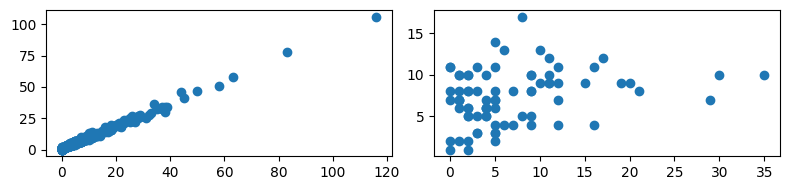

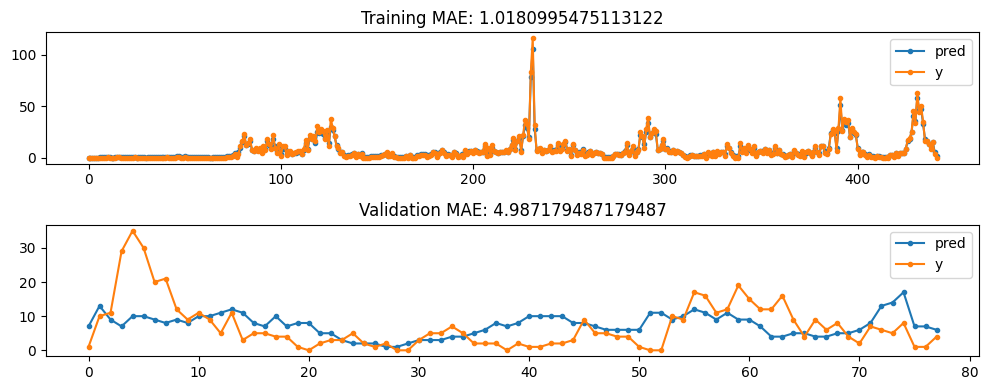

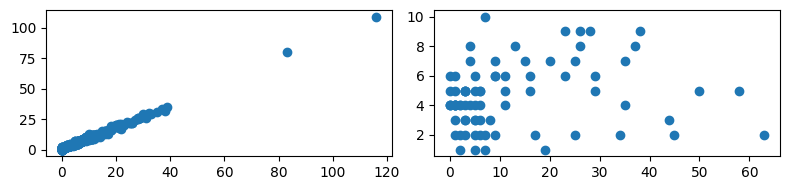

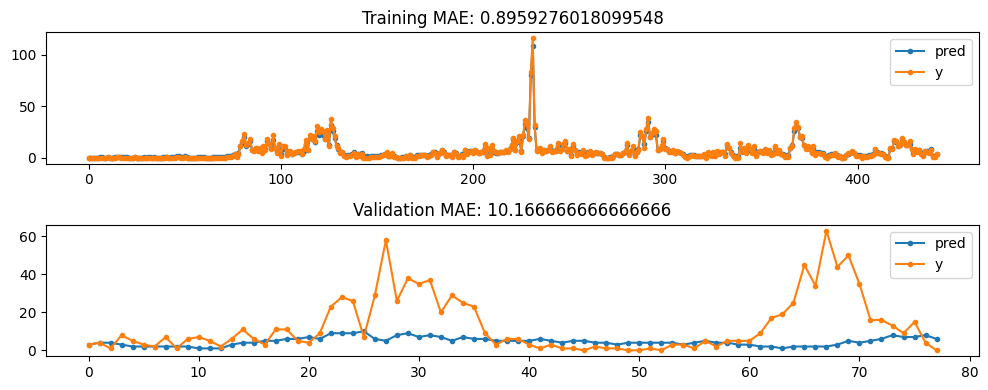

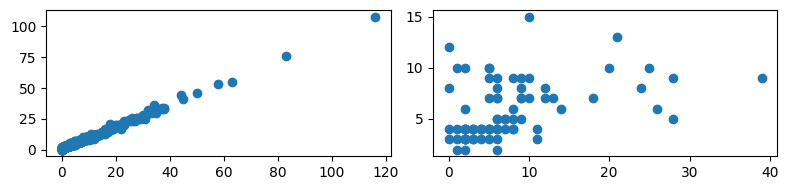

...

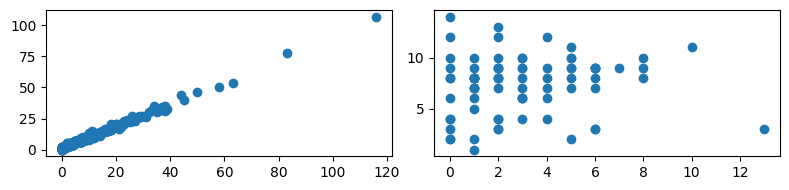

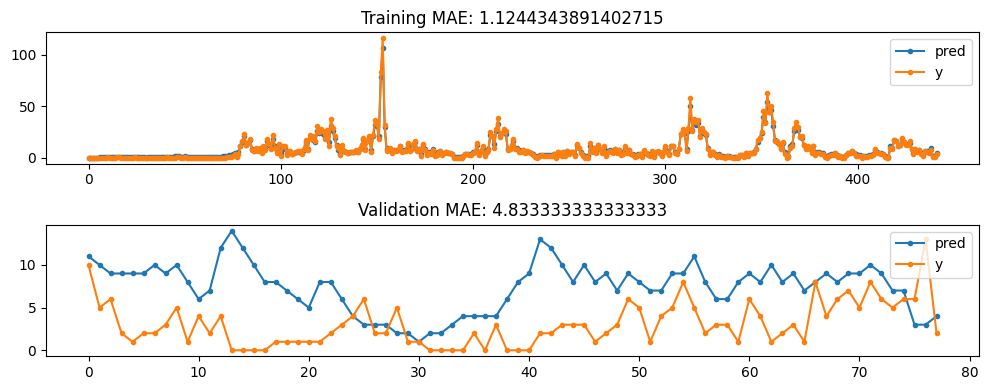

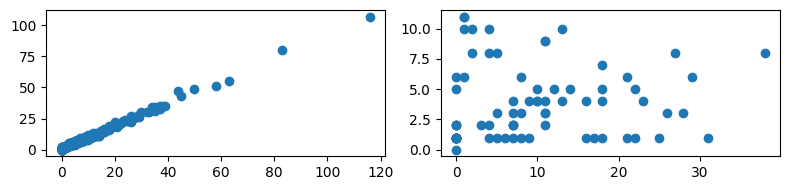

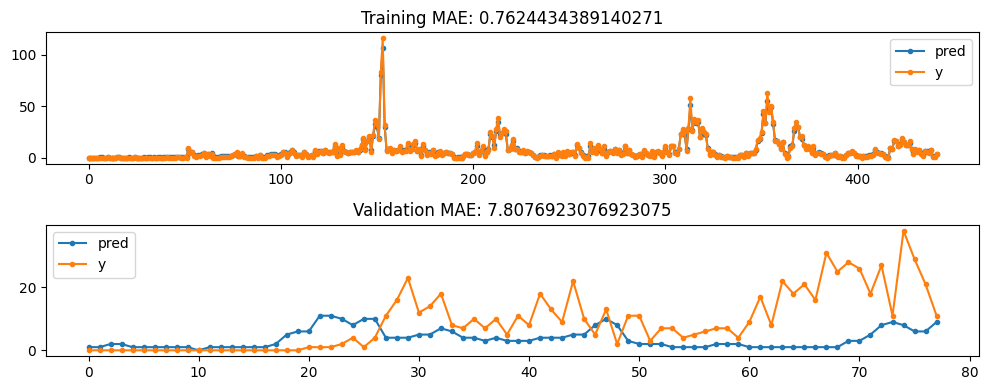

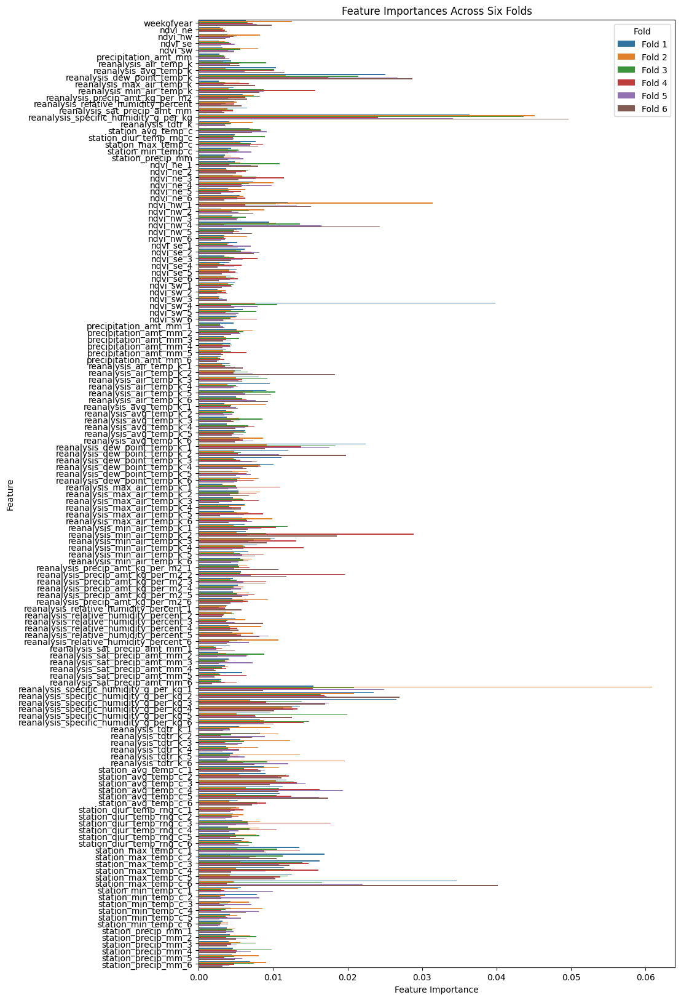

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


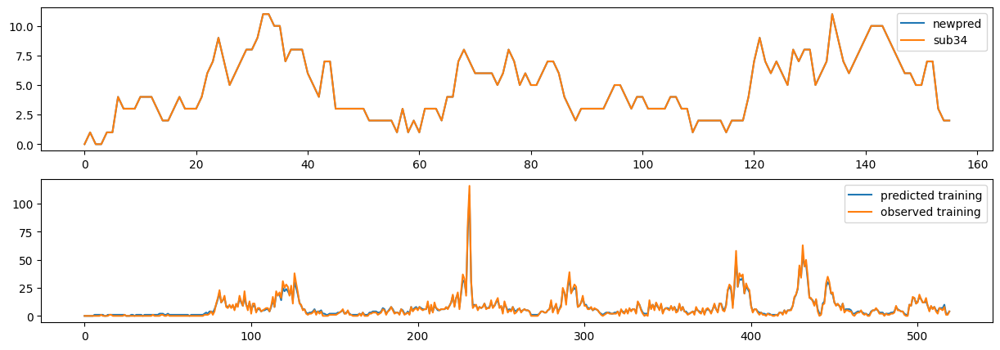

In [17]:
# Close to original best scoring
# Specify modelling parameters
# label_lags=(1,2,3)
label_lags=None
feature_lags = (1,2,3,4,5,6)
# feature_lags = None
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
# lagged_features = None

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names, smooth_feat=3,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=2)

# # Dropping of week features
# sj_features.drop(columns=lagged_features, inplace=True)
# iq_features.drop(columns=lagged_features, inplace=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=None)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,smooth_feat=3,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=2)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
# iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case_sub34[best_case_sub34['city']=='iq']['total_cases'].reset_index(drop=True),label='sub34')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

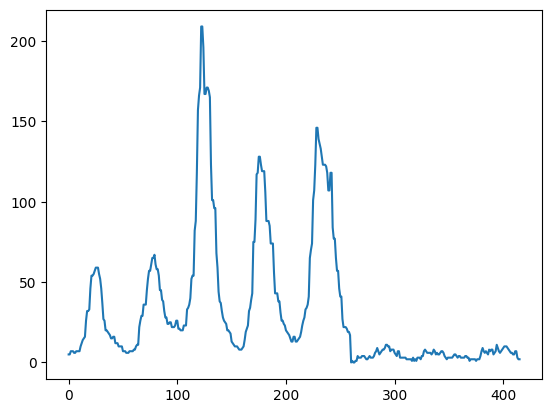

In [18]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_36.csv")

### sub 37 - using sub34 IQ values. relative to sub 34, SJ using target encoding, but not raising values artificially.

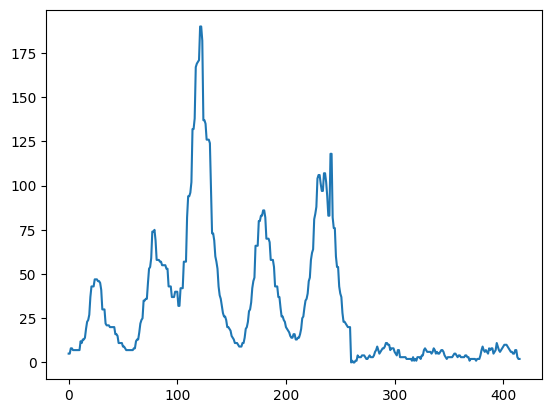

In [10]:
best_case_sub34 = pd.read_csv('submission_34.csv')
plt.plot(best_case_sub34['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

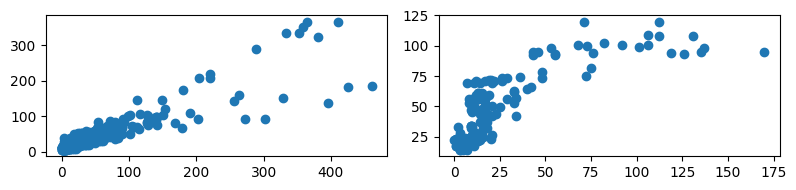

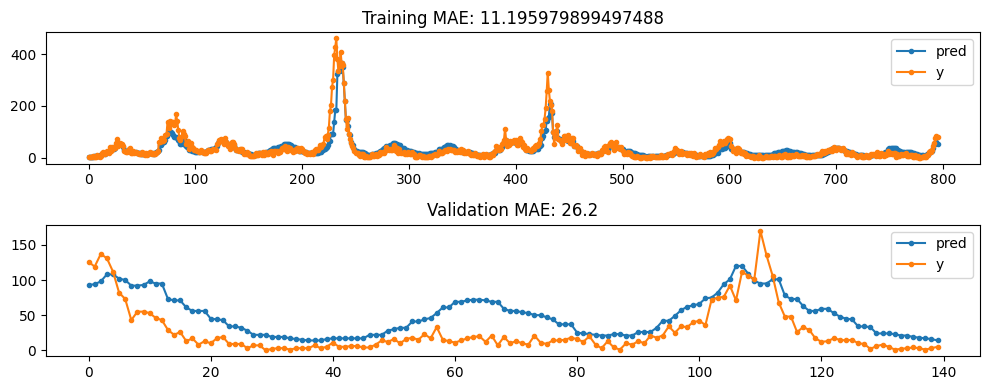

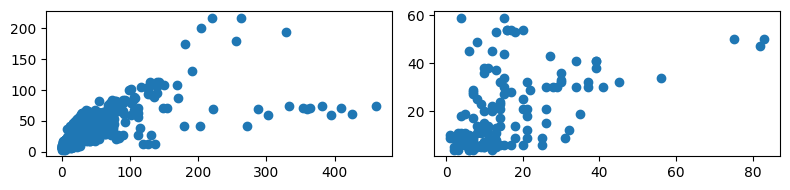

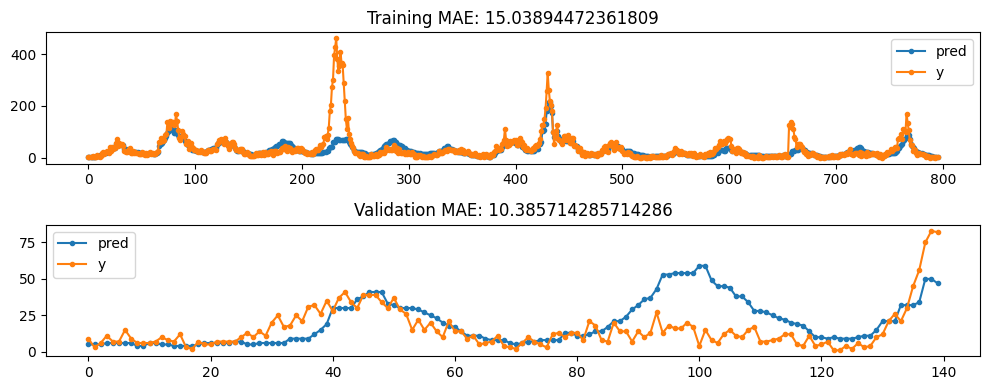

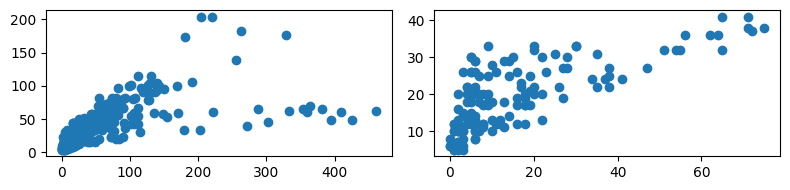

...

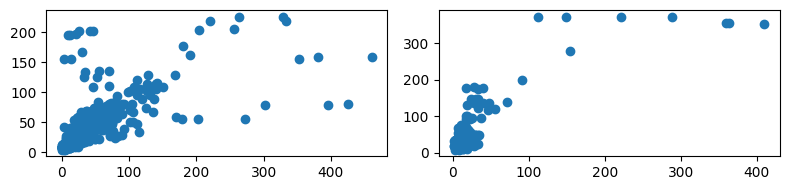

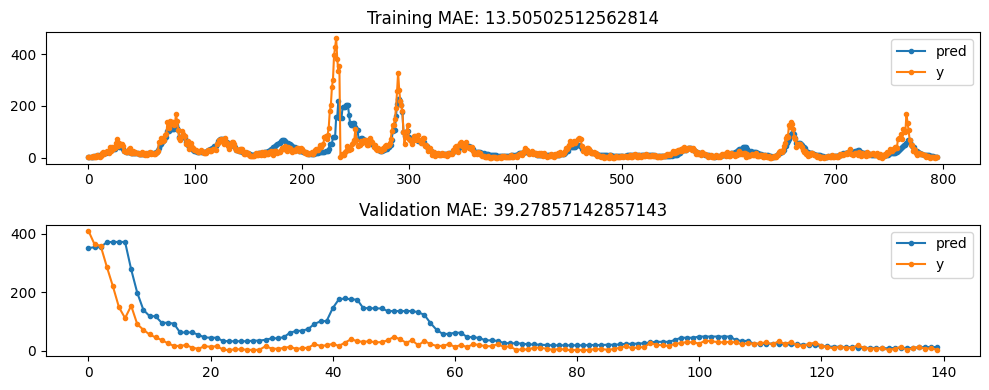

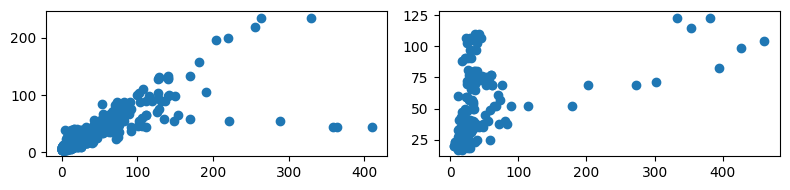

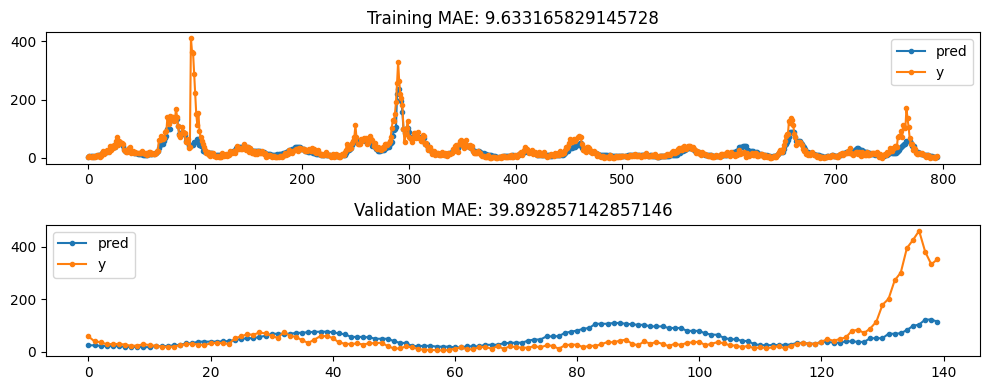

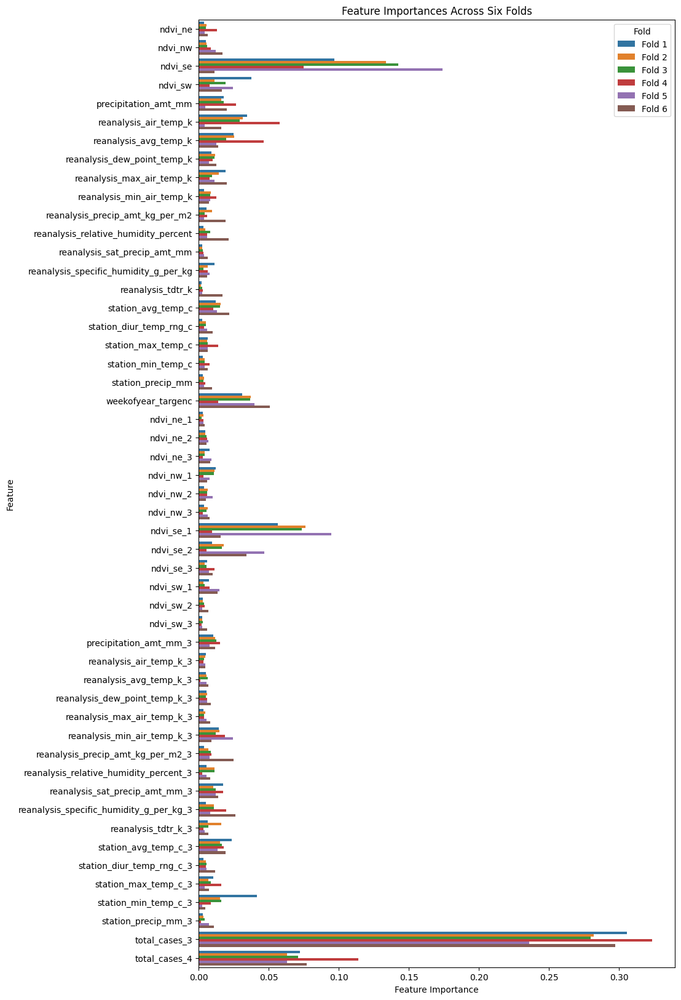

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


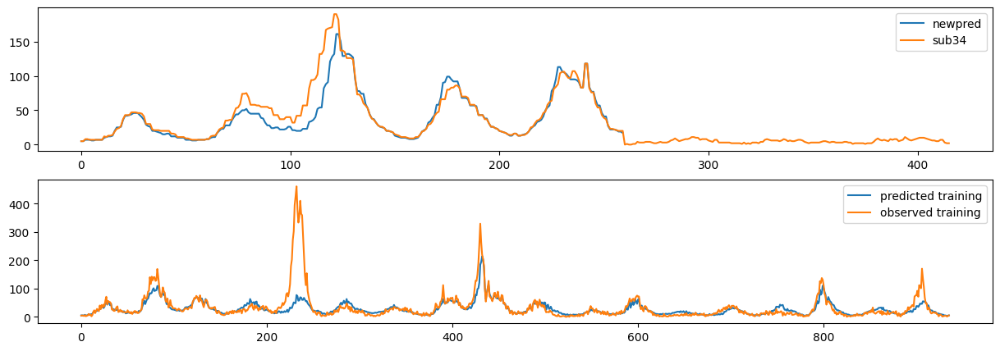

In [11]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features,\
    sj_labels, iq_labels,\
        sj_targenc_woy, iq_targenc_woy = preprocess(train_features_or,labels=train_labels,
                                                    features_to_keep = feature_names,
                                                    lagged_features = lagged_features,
                                                    fillna = 'ffill', smooth_feat = 3,
                                                    feature_lags=None, label_lags=label_lags,
                                                    circular_weekofyear=3,
                                                    weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)

    pred_train_sj, pred_val_sj,\
    train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                             X_val_sj[fold],y_val_sj[fold],
                                             label_lags=label_lags,
                                             verbose=False,plot=True, MC=None, get_pred_train=True,
                                             median_filter=3)
    
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
    
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                           features_to_keep = feature_names + lagged_label_names,
                                           lagged_features = lagged_features,
                                           fillna = 'ffill', smooth_feat = 3,
                                           feature_lags=None, label_lags=None,
                                           circular_weekofyear=(sj_targenc_woy, iq_targenc_woy),
                                           weekofyear_shift=10)
# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub34['total_cases'],label='sub34')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

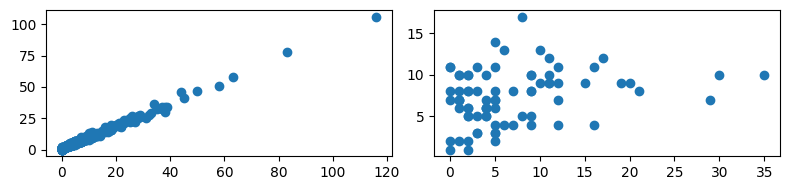

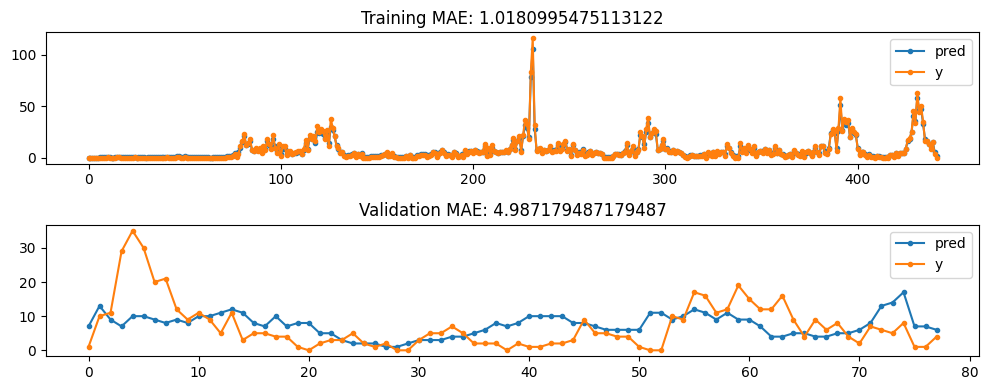

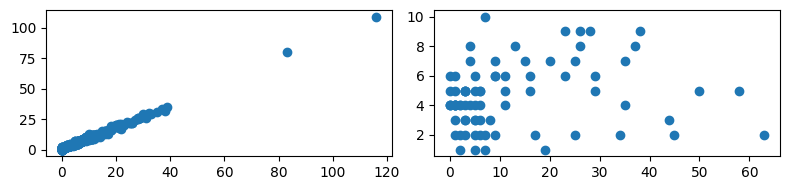

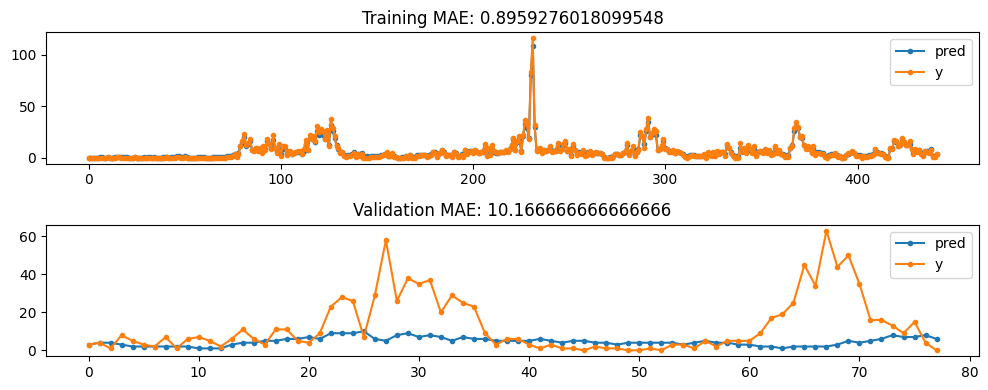

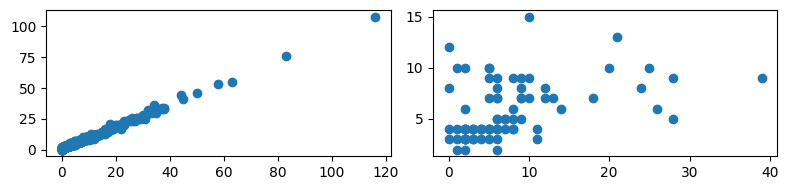

...

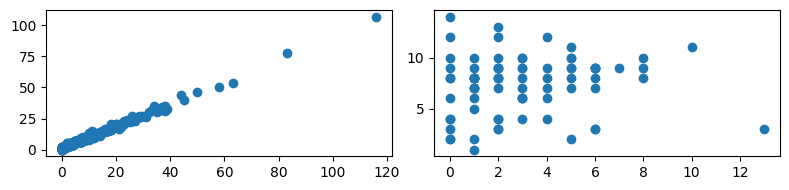

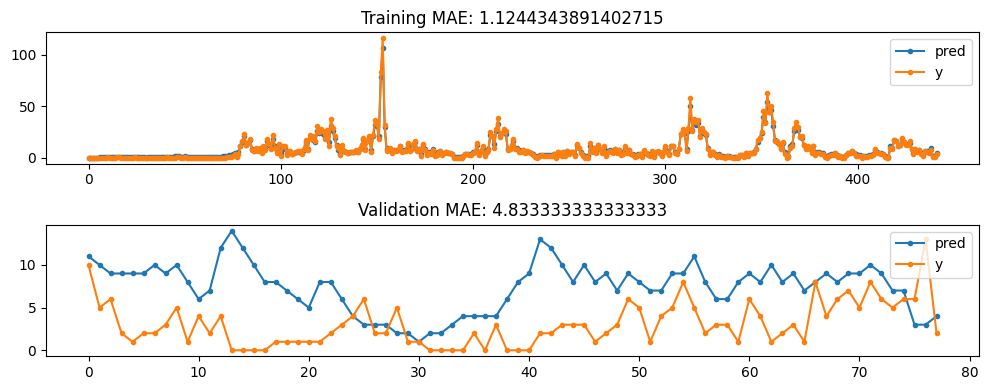

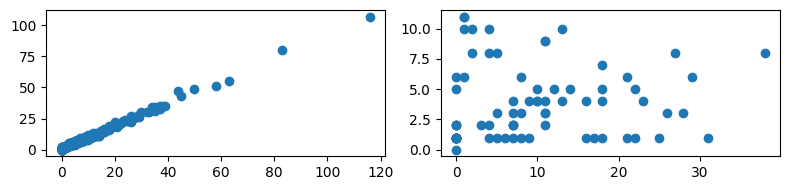

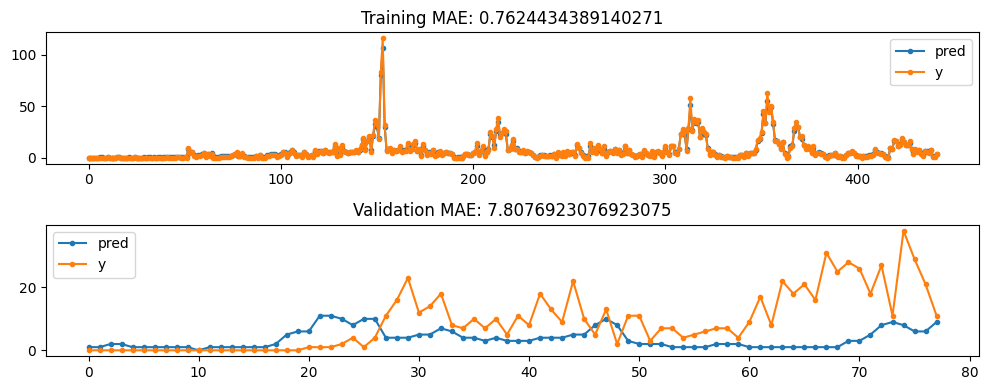

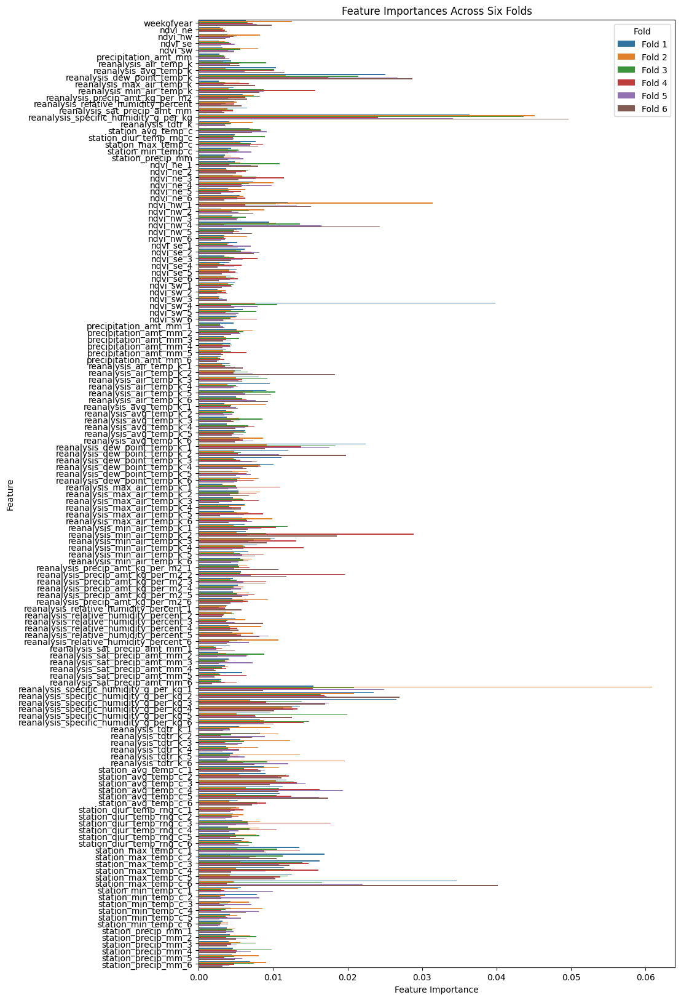

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


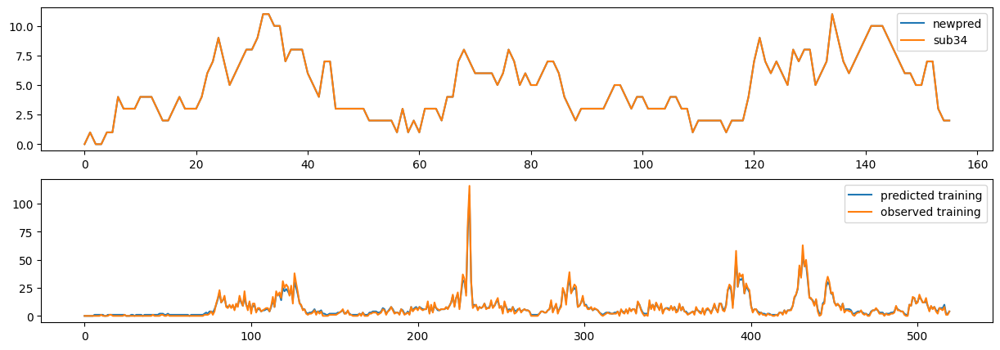

In [12]:
# Close to original best scoring
# Specify modelling parameters
# label_lags=(1,2,3)
label_lags=None
feature_lags = (1,2,3,4,5,6)
# feature_lags = None
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
# lagged_features = None

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names, smooth_feat=3,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=2)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=None)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=7,
                                     objective='count:poisson',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,smooth_feat=3,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=2)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
# iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case_sub34[best_case_sub34['city']=='iq']['total_cases'].reset_index(drop=True),label='sub34')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

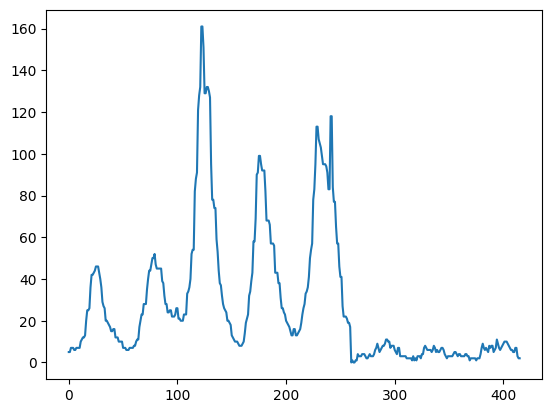

In [13]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_37.csv")

### Sub 38

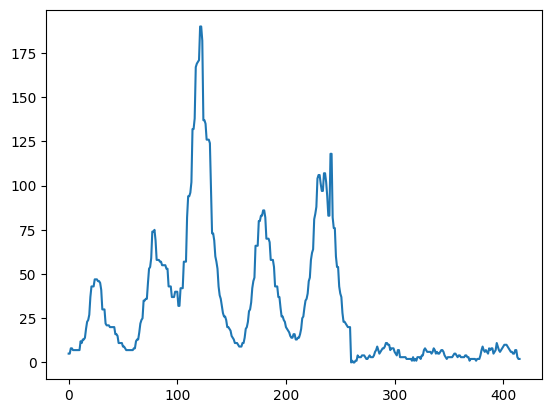

In [70]:
best_case_sub34 = pd.read_csv('submission_34.csv')
plt.plot(best_case_sub34['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

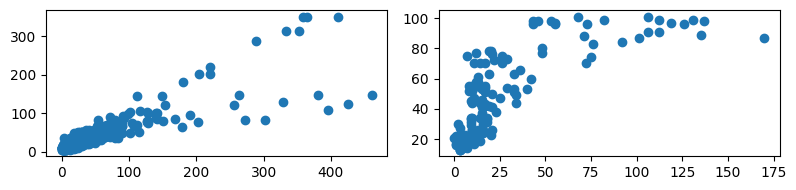

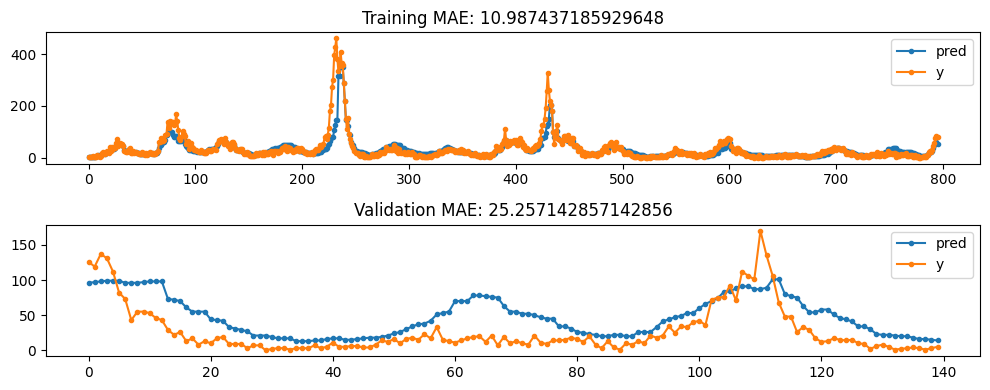

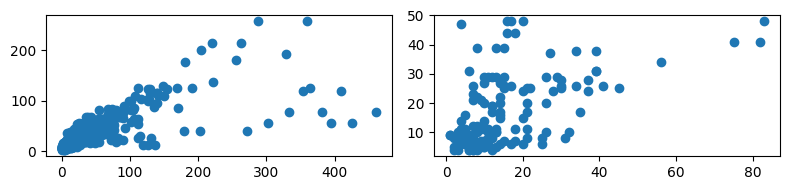

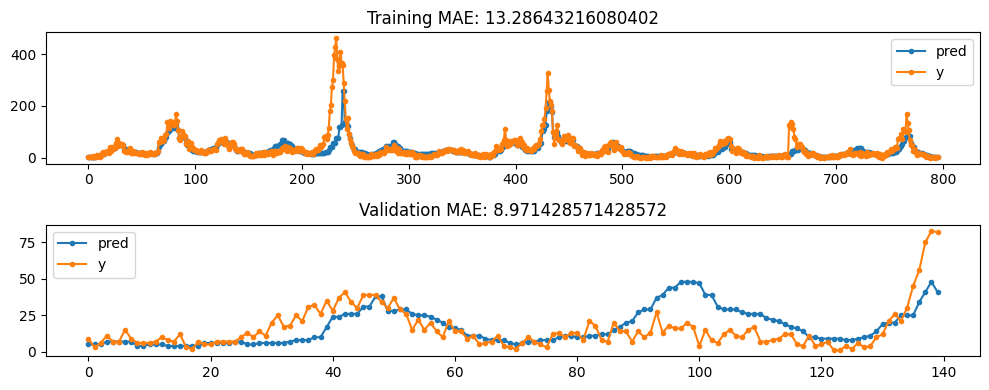

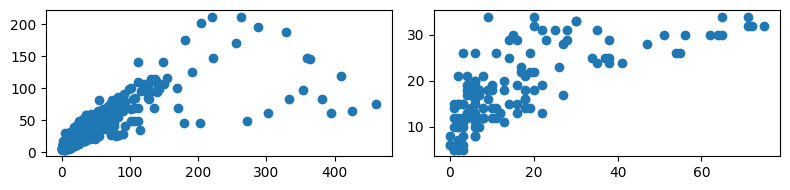

...

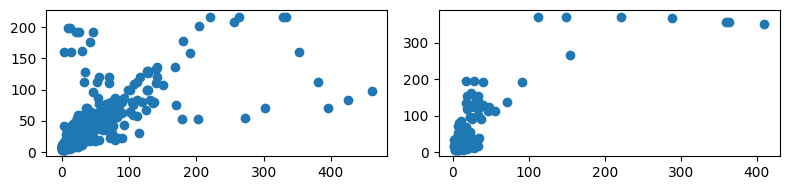

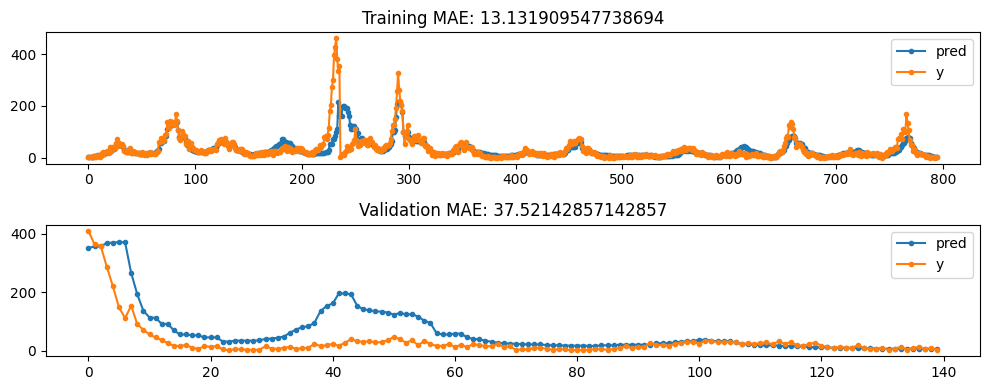

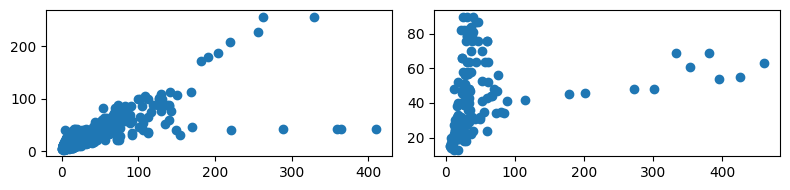

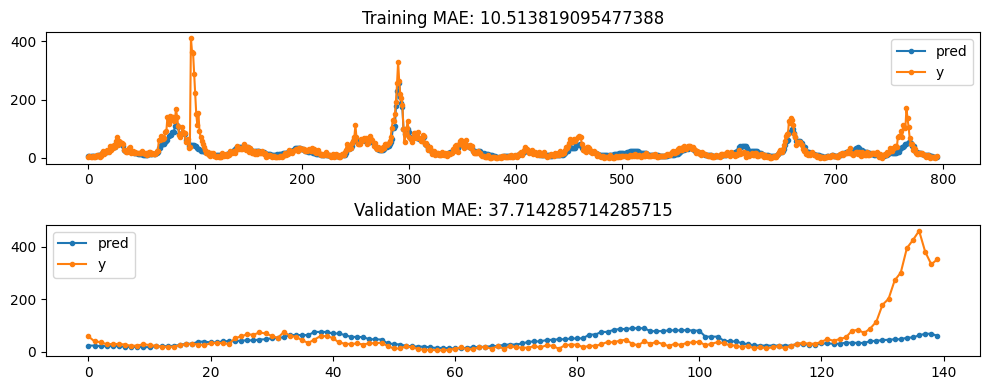

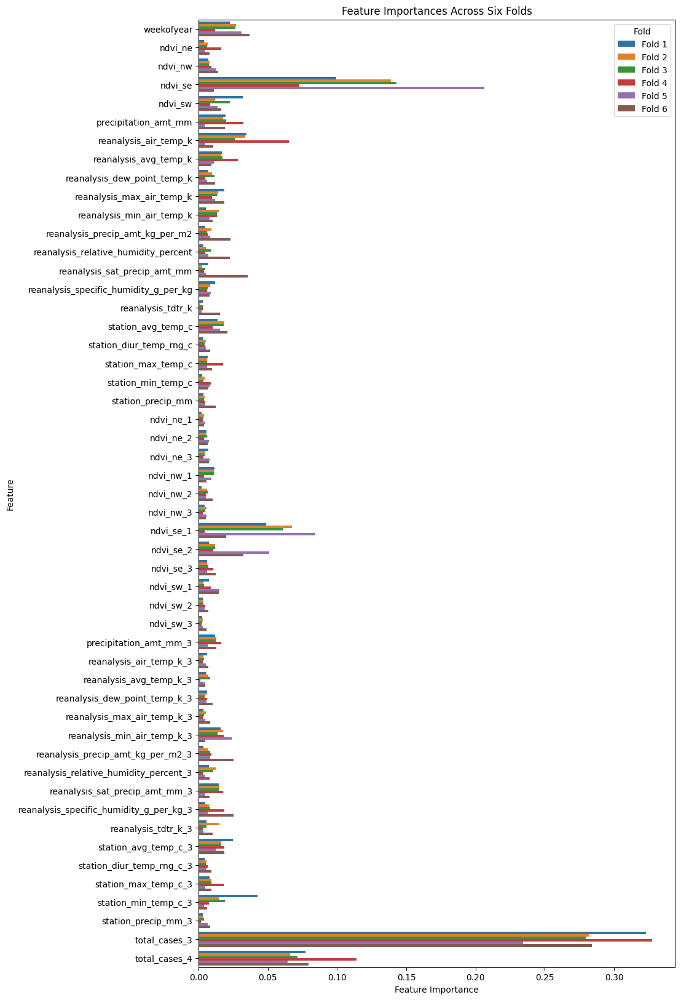

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


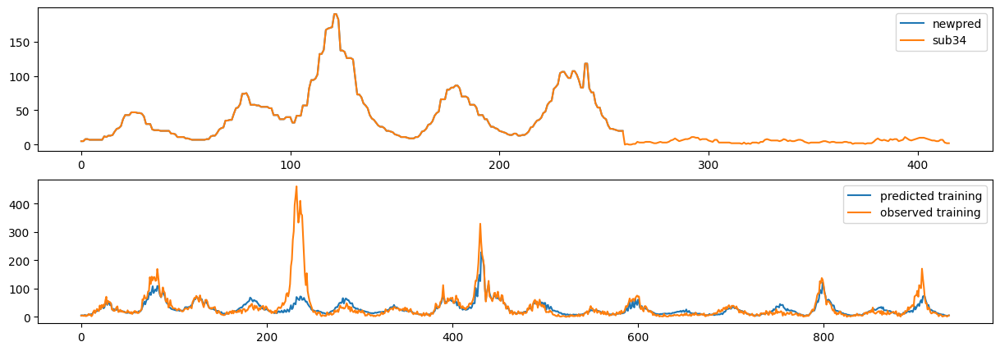

In [72]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features, smooth_feat=3,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=2,
                                                            weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features, smooth_feat=3,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=2,
                                  weekofyear_shift=10)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case_sub34['total_cases'],label='sub34')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

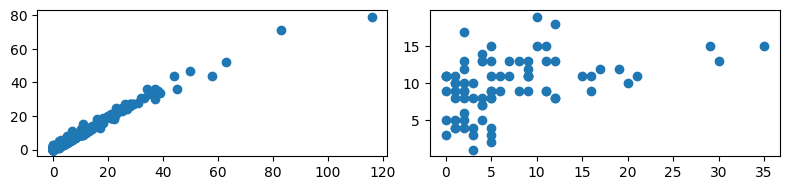

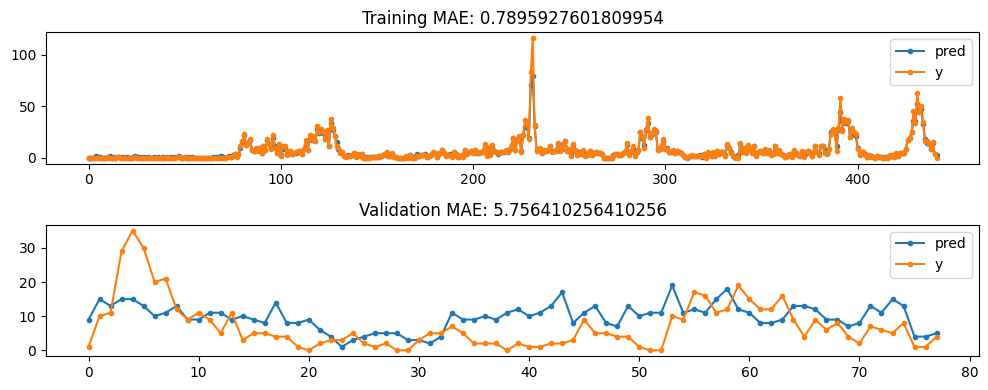

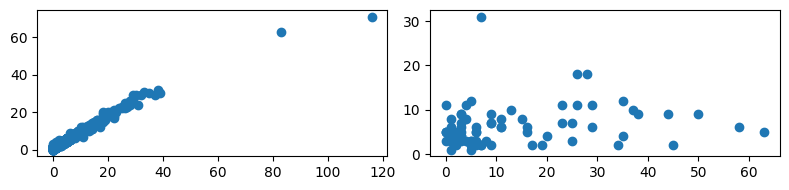

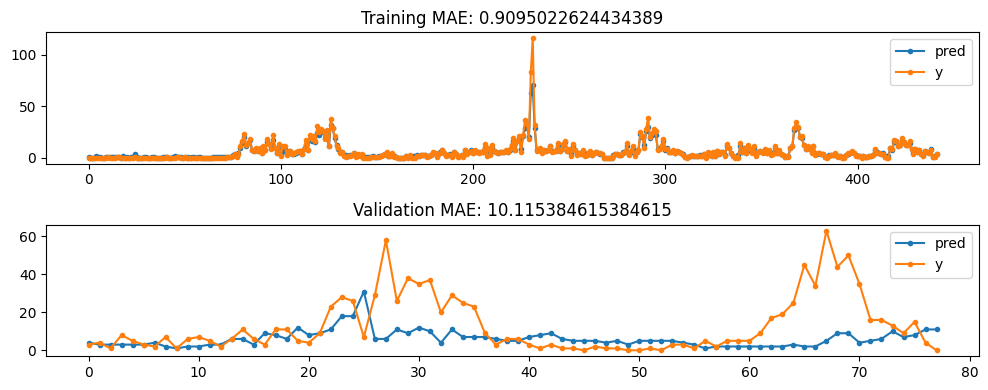

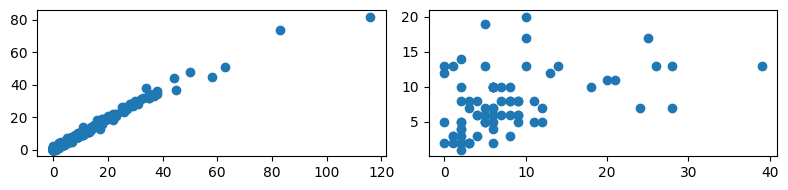

...

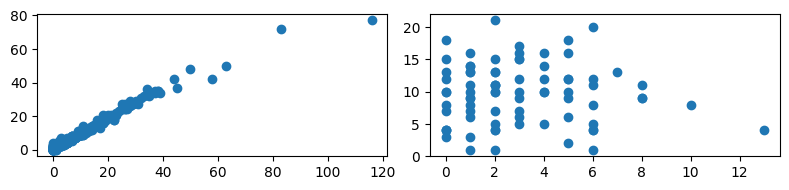

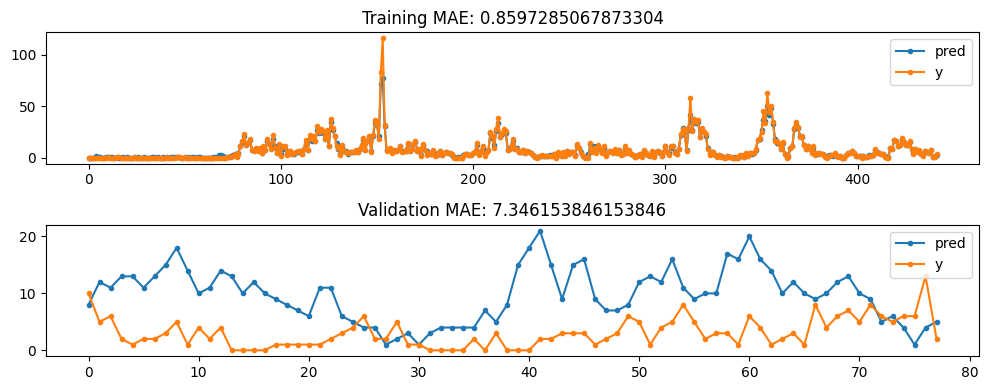

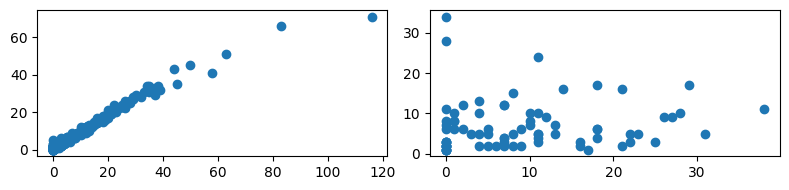

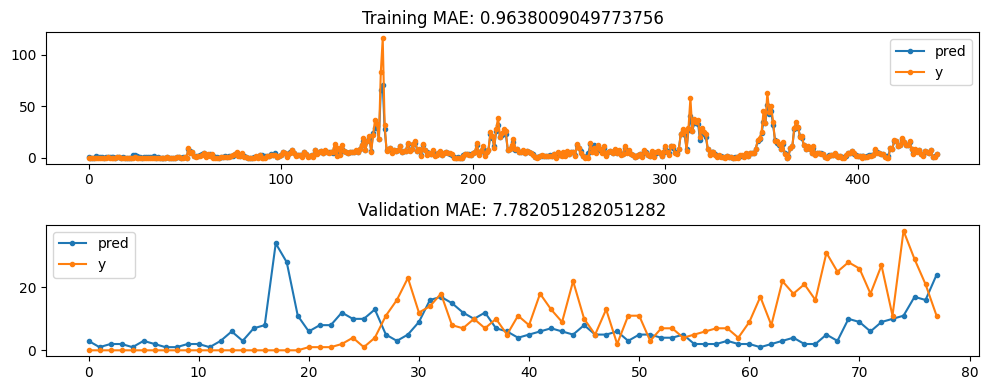

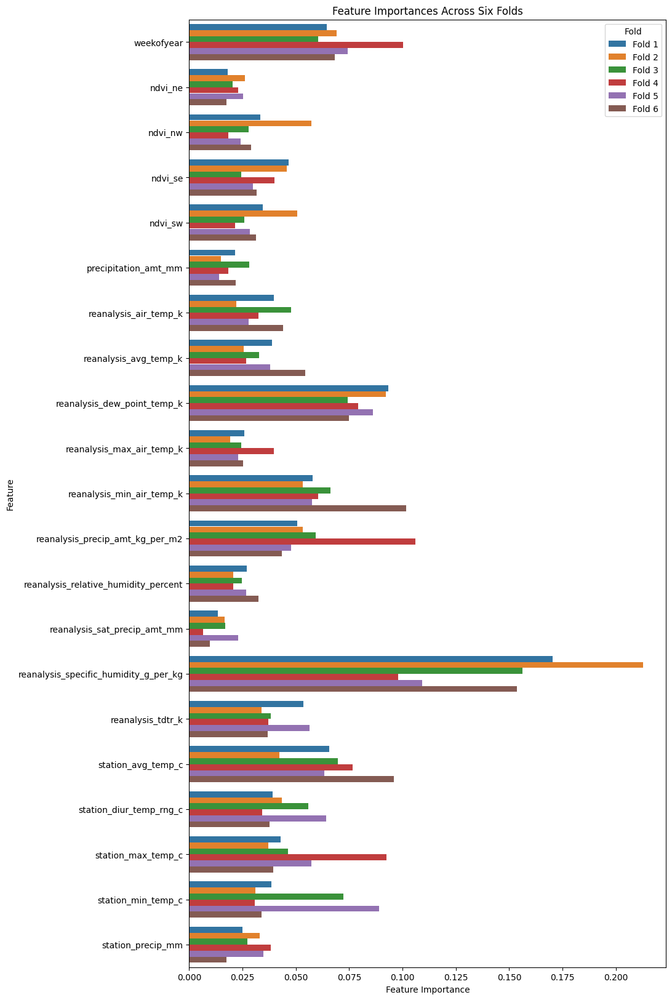

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


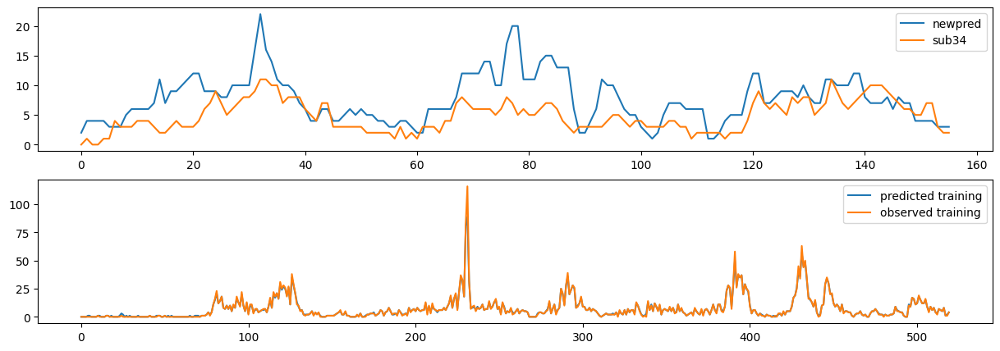

In [73]:
# Specify modelling parameterst
eta = 0.05
n_estimators = 500
max_depth =9
reg_alpha = 1
reg_lambda = 5
smooth_feat = 3
objective = 'reg:squarederror'
# objective = 'count:poisson'

# label_lags=(3,)
label_lags=None
# feature_lags = (1,2,3,4,5,6,7,8,9,10)
feature_lags = None
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
lagged_features = None

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features, smooth_feat=smooth_feat,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=4)

# # Dropping of week features
# sj_features.drop(columns=lagged_features, inplace=True)
# iq_features.drop(columns=lagged_features, inplace=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=None)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features, smooth_feat=smooth_feat,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=4)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case_sub34[best_case_sub34['city']=='iq']['total_cases'].reset_index(drop=True),label='sub34')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

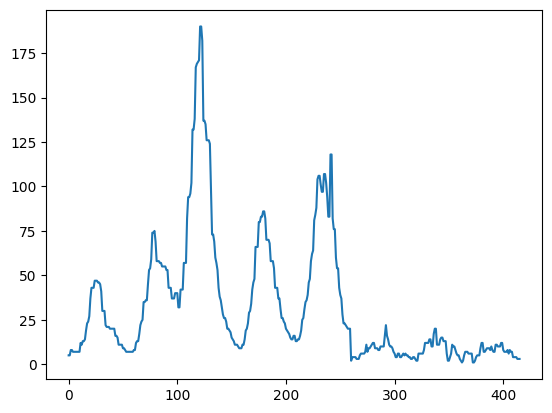

In [74]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_38.csv")